In [1]:
import SimpleITK as sitk
import numpy as np
import os
import math

In [67]:
help(sitk.RescaleIntensityImageFilter)

Help on class RescaleIntensityImageFilter in module SimpleITK.SimpleITK:

class RescaleIntensityImageFilter(ImageFilter)
 |  Proxy of C++ itk::simple::RescaleIntensityImageFilter class.
 |  
 |  Method resolution order:
 |      RescaleIntensityImageFilter
 |      ImageFilter
 |      ProcessObject
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  Execute(self, image1)
 |      Execute(RescaleIntensityImageFilter self, Image image1) -> Image
 |  
 |  GetName(self)
 |      GetName(RescaleIntensityImageFilter self) -> std::string
 |  
 |  GetOutputMaximum(self)
 |      GetOutputMaximum(RescaleIntensityImageFilter self) -> double
 |  
 |  GetOutputMinimum(self)
 |      GetOutputMinimum(RescaleIntensityImageFilter self) -> double
 |  
 |  SetOutputMaximum(self, OutputMaximum)
 |      SetOutputMaximum(RescaleIntensityImageFilter self, double OutputMaximum)
 |  
 |  SetOutputMinimum(self, OutputMinimum)
 |      SetOutputMinimum(RescaleIntensityImageFilter self, double OutputMinimu

## IMAGE and LABEL preprocessing:

In [68]:
def image_preprocessing(image, ref_image):
    
    """
    Apply N4BiasFieldCorrection, Histogram Matching according to a reference image, and 
    Image Z-normalization (mu = 0 and variance = 1) over the input MRI image.
    
    Argument:
    image -- SimpleItk supported MRI image (.nift, .nrrd, ...), with pixel type sitk.Float32, that
    will be corrected;
    ref-image -- SimpleItk supported MRI image (.nift, .nrrd, ...), with pixel type sitk.Float32, that
    was already N4BiasCorrected;
    
    Returns:
    z_normalized_image -- the MRI image after those preprocessing;
    """
    
    corrector = sitk.N4BiasFieldCorrectionImageFilter()
    
    corrected_image = corrector.Execute(image)

    hist_matcher = sitk.HistogramMatchingImageFilter()

    matched_image = hist_matcher.Execute(corrected_image, ref_image)
    
    z_normalizer = sitk.NormalizeImageFilter()

    z_normalized_image = z_normalizer.Execute(matched_image)
    
    rescaler = sitk.RescaleIntensityImageFilter()
    rescaler.SetOutputMinimum(0)
    rescaler.SetOutputMaximumt(255)
    
    rescaled_image = rescaler.Execute(z_normalized_image) 
    
    
    return rescaled_image    

In [7]:
def label_resampler(image, reference_image):
    """
    Resample image into the reference_image physical space (origing, spacing, direction).
    At the end image will have same voxrl size as reference_image.
    
    Argument:
    image -- SimpleItk supported binary image (.nift, .nrrd, ...) that
    will be resampled;
    reference_image -- SimpleItk supported binary image (.nift, .nrrd, ...) that
    will be used as reference for origin, spacing, and direction; 
    
    Returns:
    resampled_image -- image with same physical space information as reference_image;
    """
    
    interpolator = sitk.sitkNearestNeighbor
    transform = sitk.Transform(3, sitk.sitkIdentity)
    resampled_image = sitk.Resample(image, reference_image, transform,
                              interpolator, 0.0, sitk.sitkUInt16)    
    
    return resampled_image    

In [8]:
def prepare_label(label_image, label_value):
    """
    Receives a binary image with zeros (background) and label_value intensities and
    change it into a binary image with zeros and ones where there was
    label_value intensities;
    
    Argument:
    label_image -- SimpleItk supported binary image (.nift, .nrrd, ...) with
    intensities: zeros (background) and label_values;
    label_value: integer that represents label information in the label_image; 
    
    Returns:
    one_zero_label -- a binary label image with ones and zeros(background)
    """
    
    one_zero_label_raw = sitk.Divide(label_image, int(label_value))
    one_zero_label = sitk.Cast(one_zero_label_raw, sitk.sitkUInt16)
    
    return one_zero_label

In [9]:
def crop_image(image, label_image, label_value):
    """
    Cropp a grey-level image and a label_image in the shortest box region that
    contains the label information in label_image;
    
    Argument:
    label_image -- SimpleItk supported binary image (.nift, .nrrd, ...) with
    intensities: zeros (background) and label_values that will be used to
    define the cropping box region and that will be cropped as well;
    image -- SimpleItk supported grey-level image (.nift, .nrrd, ...) that
    will be cropped;
    label_value: integer that represents label information in the label_image; 
    
    Returns:
    cropped_image -- the grey-level cropped image 
    cropped_label -- a binary label image with ones and zeros(background)
    """
    
    one_zero_label = prepare_label(label_image, label_value)
    image_casted = sitk.Cast(image, sitk.sitkUInt16)
    only_roi_image = sitk.Multiply(one_zero_label,image_casted)
    
    shape = sitk.LabelShapeStatisticsImageFilter()
    shape.Execute(one_zero_label)
    region = shape.GetRegion(1)
    region_index = (region[0], region[1], region[2])
    region_size = (region[3], region[4], region[5])
    
    cropped_image = sitk.RegionOfInterest(only_roi_image, region_size, region_index)
    cropped_label = sitk.RegionOfInterest(one_zero_label, region_size, region_index)
    
    return (cropped_image, cropped_label)

In [10]:
def is_out_of_bounds(image_size, index):
    """
    Check if a gien pixel index is not inside image region, if it is out of bounds;
    
    Argument:
    image_size -- tuple with x, y, z image sizes;
    index -- 2D or 3D tuple that identifies the pixel to be checked; 
    
    Returns:
    True -- if index is out of bounds, False, otherwise; 
    """  
    
    if index[0] >= image_size[0] or index[0] < 0:
        return True
    elif index[1] >= image_size[1] or index[1] < 0:
        return True
    elif index[2] >= image_size[2] or index[2] < 0:
        return True
    else:
        return False

In [11]:
def get_neighborhood_mean(image, label_image, pixel_index):
    """
    Calculates the average grey-level intensity of a given pixel's  neighborhood
    (3x3x3 in 3D or 3x3 in 2D);
    
    Argument:
    label_image -- SimpleItk supported binary image (.nift, .nrrd, ...) with
    intensities: zeros (background) and ones;
    image -- SimpleItk supported grey-level image (.nift, .nrrd, ...);
    pixel_index: 3D or 3D tuple that identifies the pixel will have the
    average grey-level intensity calculated for its neighborhood; 
    
    Returns:
    neighborhood_mean -- pixel_index neighborhood average intensity 
    """    
    size = label_image.GetSize()
    
    idx = pixel_index
    n_sum = 0
    counted_pixel = 0
    for x in range(idx[0]-1,idx[0]+2):
        for y in range(idx[1]-1,idx[1]+2):
            for z in range(idx[2]-1,idx[2]+2):
                index = (x,y,z)
                if not is_out_of_bounds(size, index):
                    label_value = label_image.GetPixel(index)
                    if label_value == 1:
                        n_sum += image.GetPixel(index)
                        counted_pixel += 1

    neighborhood_mean = int(n_sum/counted_pixel)
      
    return neighborhood_mean

In [8]:
def outlier_removal(image, label_image):
    """
    Remove outlier pixel intensities by changing outlier values for
    the pixels neighborhood average intnsity. A pixel intensity is considered
    outlier when it is > mean + 3*std or < mean - 3*std;
    
    Argument:
    label_image -- SimpleItk supported binary image (.nift, .nrrd, ...) with
    intensities: zeros (background) and ones;
    image -- SimpleItk supported grey-level image (.nift, .nrrd, ...);
    
    Returns:
    no_outlier_image -- SimpleItk supported grey-level image (.nift, .nrrd, ...)
    with o putliers; 
    """
    
    # cleaned final image
    no_outlier_image = image
    
    # Getting grey-level statistics
    statistics = sitk.LabelIntensityStatisticsImageFilter()
    statistics.Execute(label_image, image)
    mean = statistics.GetMean(1)
    std = statistics.GetStandardDeviation(1)
    
    size = image.GetSize()    
    for x in range(size[0]):
        for y in range(size[1]):
            for z in range(size[2]):
                index = (x,y,z)
                label_value = label_image.GetPixel(index)
                if label_value == 1:
                    image_value = image.GetPixel(index)
                    if (image_value > (mean + 3*std)) or (image_value < (mean - 3*std)):
                        # print("Outlier found: "+ str(image_value))                        
                        neighbourhood_mean = get_neighborhood_mean(image, label_image, index) 
                        # print("New value: "+ str(neighbourhood_mean))
                        no_outlier_image.SetPixel(x, y, z, neighbourhood_mean)               
    
    return no_outlier_image

In [9]:
def rescale_roi(image, label_image):
    """
    Rescales the intensities of the image into the desired range.
    
    Argument:
    label_image -- SimpleItk supported binary image (.nift, .nrrd, ...) with
    intensities: zeros (background) and ones;
    image -- SimpleItk supported grey-level image (.nift, .nrrd, ...);
    
    Returns:
    rescaled_image -- SimpleItk supported grey-level image (.nift, .nrrd, ...) 
    with pre_defined min and max pixel intensities; 
    """
    
    rescaled_image = image
    
    # Getting grey-level statistics
    statistics = sitk.LabelIntensityStatisticsImageFilter()
    statistics.Execute(label_image, image)
    input_min = statistics.GetMinimum(1)
    input_max = statistics.GetMaximum(1)
    
    output_min = 1
    output_max = 128
    
    size = image.GetSize()
    for x in range(size[0]):
        for y in range(size[1]):
            for z in range(size[2]):
                index = (x,y,z)
                label_value = label_image.GetPixel(index)
                if label_value == 1:
                    input_pixel = image.GetPixel(index)
                    rescaled_value_raw = (input_pixel - input_min)*((output_max - output_min)/(input_max - input_min)) + output_min
                    rescaled_value = int(rescaled_value_raw)
                    rescaled_image.SetPixel(x,y,z,rescaled_value)
    
    return rescaled_image

## READING Image and Label and CALLING preprocessing

In [70]:
def get_image_and_label_ready(image_file, label_file, label_value, ref_image_file):
    
    """
    Runs the whole image preprocessing pipeline.
    
    Argument:
    image_file -- dir that conttans a SimpleItk supported greylevel image (.nift, .nrrd, ...);
    label_file -- dir that conttans a SimpleItk supported binary image (.nift, .nrrd, ...);
    label_value -- integer that indicates the pixel value on label_image;
    ref_image_file -- dir that conttans a SimpleItk supported greylevel image (.nift, .nrrd, ...) 
    used as referencen in the histogram matching stage;
    
    Returns:
    final_image -- the post processed SimpleItk supported greylevel image (.nift, .nrrd, ...).
    This image contain only the greylevel lesion, outlier-filtered and rescaled;
    final_label -- the post processed SimpleItk supported binary image (.nift, .nrrd, ...).
    This label does ocuppy the same greylevel image physical space and is cropped containing
    only the label lesion region;
    """
    
    label_image = sitk.ReadImage(label_file, sitk.sitkInt8)
    image = sitk.ReadImage(image_file, sitk.sitkFloat32)
    ref_image = sitk.ReadImage(ref_image_file, sitk.sitkFloat32)
    
    # resampling label image into 3DT1 space:
    resampled_label_image = label_resampler(label_image, image)
    
    prep_image = image_preprocessing(image, ref_image)
    
    cropped_image, cropped_label = crop_image(prep_image, resampled_label_image, label_value)
    
    no_outlier_image = outlier_removal(cropped_image, cropped_label)

    final_image, final_label = no_outlier_image, cropped_label
  
    return (final_image, final_label)

In [4]:
import matplotlib.pyplot as plt
%matplotlib inline

No handles with labels found to put in legend.


(0.0, 1200.0)

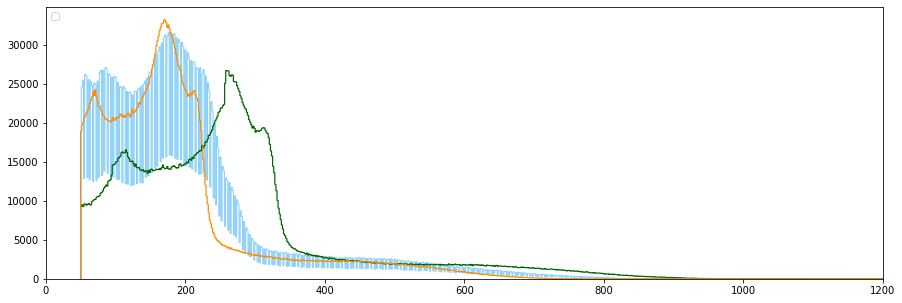

In [71]:
#import time
#start_time = time.time()


image_file = '3DT1.nii.gz'
ref_image_file = 'ref-3DT1.nii.gz' 
corr_image_file = 'corrected-3DT1.nrrd'
equ_image_file = 'equalized-3DT1.nrrd'
z_norm_image_file = 'z_normalized-3DT1.nrrd'

#ref_image = sitk.ReadImage(ref_image, sitk.sitkFloat32)

orig_image = sitk.ReadImage(image_file, sitk.sitkFloat32)
orig = sitk.GetArrayFromImage(orig_image) 

corr_image = sitk.ReadImage(corr_image_file, sitk.sitkFloat32)
corr = sitk.GetArrayFromImage(corr_image)

equ_image = sitk.ReadImage(equ_image_file, sitk.sitkFloat32)
equ = sitk.GetArrayFromImage(equ_image)

z_norm_image = sitk.ReadImage(z_norm_image_file, sitk.sitkFloat32)
z_norm = sitk.GetArrayFromImage(z_norm_image)

orig = orig[orig>50]
orig = orig.flatten()

corr = corr[corr>50]
corr = corr.flatten()

equ = equ[equ>50]
equ = equ.flatten()

fig = plt.figure(figsize=(15,5))
plt.hist(orig, histtype='step', bins='fd', color='lightskyblue')
plt.hist((corr, equ), histtype='step', bins = 'fd' , linewidth=1.2, color=('darkorange', 'darkgreen'))
plt.legend()
plt.xlim([0,1200])



(-0.5, 7.0)

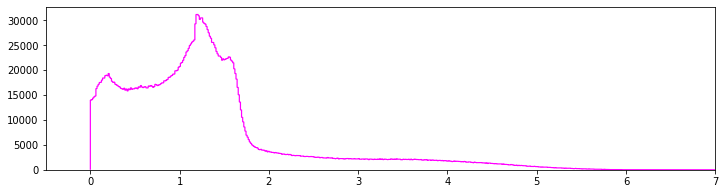

In [75]:
z_norm = z_norm[z_norm>.0001]
z_norm = z_norm.flatten()

fig = plt.figure(figsize=(12,3))
plt.hist(z_norm, histtype='step', bins='fd', linewidth=1.2, color='magenta')
plt.xlim([-.5,7])

## RADIOMICS routine: call image and label and perform feature extraction

In [19]:
import pandas as pd
import radiomics
import six
import os
import sys
import logging

### Configuring and extracting features

In [51]:
def extract_features(image, label):
    
    """
    Configure the setting and run the whole radiomics extraction pipeline.
    
    Argument:
    image -- a SimpleItk supported greylevel image (.nift, .nrrd, ...);
    label -- a SimpleItk supported binary image (.nift, .nrrd, ...);
    
    Returns:
    features -- list containing all the features name
    values -- list containing all the feature values for the respective label and value
    """
    
    #setting up logger:
    # Get the PyRadiomics logger (default log-level = INFO)
    logger = radiomics.logger
    logger.setLevel(logging.DEBUG)  # set level to DEBUG to include debug log messages in log file

    # Set up the handler to write out all log entries to a file
    handler = logging.FileHandler(filename='testLog.txt', mode='w')
    formatter = logging.Formatter("%(levelname)s:%(name)s: %(message)s")
    handler.setFormatter(formatter)
    logger.addHandler(handler)

    # Define settings for signature calculation
    settings = {}
    settings['binWidth'] = 3
    settings['label'] = 1
    
    # Initialize feature extractor by settings file (No other configuration must be set)
    extractor = radiomics.featureextractor.RadiomicsFeatureExtractor(**settings)

    # By default, only original is enabled. Optionally enable some image types:
    extractor.enableImageTypeByName('Wavelet')
    extractor.enableImageTypeByName('LBP3D')
    extractor.enableImageTypeByName('Gradient')
    
    # Disable all classes except firstorder
    extractor.disableAllFeatures()

    # Enable all features in firstorder
    extractor.enableFeatureClassByName('firstorder')
    extractor.enableFeatureClassByName('glcm')
    extractor.enableFeatureClassByName('glrlm')
    extractor.enableFeatureClassByName('glszm')
    extractor.enableFeatureClassByName('gldm')
    extractor.enableFeatureClassByName('ngtdm')

    # Calculating features
    featureVector = extractor.execute(image, label)

    # priting and storing features
    features = []
    values = []

    i = 0 # feature counter 
    for featureName in featureVector.keys():
        # the results comes with a 32 lines header. The first condition is to avoid storing those information;
        if (i >= 22): 
            features.append(featureName) 
            values.append(featureVector[featureName])
            print("Computed %s: %s" % (featureName, featureVector[featureName]))
        i += 1
    
    return (features, values)

### Function to average wavelet and lbp repeated first_order features into single first_order features 

In [33]:
def get_averaged_features(all_features, image_key, ref_features):
    
    """
    Average all the feature eextracted from the filter-generated images. In this case,
    Wavelet option creates 8 different images and extract first order features from each of such images.
    This function average those 8 image features into a single set of first order features.
    The same goes for Local Binary pattern filter that generate 3 images and extract first order features 
    from each of those images.
    
    Argument:
    All_features -- A DataFrame ("Features", "Values") with all radiomic features extracted
    (from original image and from filtered images);
    image_key -- type of filter (wavelet, local binary pattern ...);
    ref_features -- is a list with the features that will be averaged and kept. E.g. first_order features.
    In the original extraction it is extracted all types of features (first order, coocurrence matrix, 
    run length ...) from the wavelet filtered images. 
    
    Returns:
    mean_image_key_features -- DataFrame containing the averaged filtered features;
    """
    
    image_key_features = all_features[all_features['Features'].str.contains(image_key)].copy()
    
    feat_means = []
    for feat in ref_features:
        feat_df = image_key_features[image_key_features['Features'].str.endswith('_'+feat)]
        mean = feat_df['Values'].mean()
        
        assert not mean == None, "Not calculating " + str(image_key)
        
        feat_means.append(mean)
        
    mean_image_key_features = pd.DataFrame({'Features':ref_features, 'Values':feat_means})
    mean_image_key_features['Features'] = mean_image_key_features['Features'].map(lambda x: x.replace(x,(image_key + '_' + x)))
    
    return mean_image_key_features

In [52]:
def generate_final_feature_set(features, values, patient_id):
    
    """
    Generates the final from all the features extracted.
    separate original_image features, call wavelet and local inary pattern averaged features and
    combine those features in to a single DataFrame;
    
    Argument:
    features -- list with names of all radiomic features extracted;
    values -- list with all radiomic feature values extracted;
    patient_id: id of patient and lesion that will identify the extraction;
    
    Returns:
    final_set - a DataFrame containing original_image extracted features, wavelet and local
    binary pattern extracted features, and the patient_id;
    
    """
    
    # generating a DF with all the extracted features:
    all_features = pd.DataFrame({'Features': features, 'Values': values})
    
    # separating the features calculated over the original image
    original = all_features[all_features['Features'].str.contains('original')] 
    
    # store first order feature names to use in the filtered image features averaging:
    first_order = original[original['Features'].str.contains('_firstorder_')]
    first_order = first_order['Features'].apply(lambda x: x.replace('original_firstorder_',''))
    first_order = np.array(first_order)
    first_order
    
    # getting averaged first order features calculated over wavelet and local_binary_pattern images;
    wavelet = get_averaged_features(all_features, 'wavelet', first_order)
    lbp = get_averaged_features(all_features, 'lbp', first_order)
    gradient = get_averaged_features(all_features, 'gradient', first_order)
    
    # Gethering all features (original, first_order wavelet and first_order lbp into a single DF)
    # Adding Patient_ID at the top row
    final_set = pd.DataFrame({'Features':['Patient_ID'], 'Values':patient_id})
    final_set = final_set.append(original, ignore_index=True)
    final_set = final_set.append(wavelet, ignore_index=True)
    final_set = final_set.append(lbp, ignore_index=True)
    final_set = final_set.append(gradient, ignore_index=True)
    final_set
    
    return(final_set)    

In [62]:
def get_final_set(image_file, label_file, label_value, resample, patient_id, classification):
    
    """
    Run the whole feature extraction pipeline for a single patient. Since loading image, 
    preprocessing, features extraction, features preprocessing, to final feature DataFrame
    assempling.
    
    Argument:
    image_file -- Dir of a SimpleItk supported greylevel image (.nift, .nrrd, ...);
    label_file -- Dir of a SimpleItk supported binary image (.nift, .nrrd, ...);
    label_value -- integer that defines label pixel intensity on label image;
    resample -- tells if the label image needs resampling into grey-level image physical space;
    
    Returns:
    final_set - a DataFrame containing original_image extracted features, wavelet and local
    binary pattern extracted features, and the patient_id;
    """
    
    # getting preprocessed images:
    image, label = get_image_and_label_ready(image_file, label_file, label_value, resample)

    # getting ROI number of pixels:
    arr_label = sitk.GetArrayFromImage(label)
    num_of_pixels = arr_label.sum()
    
    features, values = extract_features(image, label)
    final_set = generate_final_feature_set(features, values, patient_id)
    
    # appending number of pixels into the final set
    final_set = final_set.append({'Features': 'num_of_pixels', 'Values':num_of_pixels}, ignore_index=True)
    final_set = final_set.append({'Features':'class', 'Values': classification}, ignore_index=True)
    
    return (final_set)

### FULL PIPELINE EXECUTION - Feature DataSet Generation 

In [67]:
def run(group, image_type):
    group = group
    image_type = image_type
    
    if group == 'MICCAI':
        patient_dir = '/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016'
        image_3dt1 = '3DT1.nii.gz'
        image_flair = '3DFLAIR.nii.gz'
        label_base = 'Consensus'
        classification = 0

    if group == 'WMH':
        patient_dir = '/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge'
        image_3dt1 = 'orig/3DT1.nii.gz'
        image_flair = 'orig/FLAIR.nii.gz'
        label_base = 'label'
        classification = 1

    patient_count = 0
    label_count = 0

    data_frame = pd.DataFrame() 

    patients = os.listdir(patient_dir)
    for patient in patients:

        # Creating patient folder path
        patient_folder = os.path.join(patient_dir,patient)

        patient_count += 1

        if image_type == "FLAIR":
            file_image = os.path.join(patient_folder, image_flair)
        elif image_type == "3DT1":
            file_image = os.path.join(patient_folder, image_3dt1)

        if not os.path.isfile(file_image):
            print('Images not found!!!!!!!')
            print(file_image)
            continue

        print(file_image)

        # setting label_folder:
        label_folder = os.path.join(patient_folder,'labels')

        if not os.path.isdir(label_folder):
            print("No Label folder!")
            continue

        # listing labels in label_folder
        labels = os.listdir(label_folder)    
        for label in labels:

            # Creating label folder path
            file_label = os.path.join(label_folder, label)      

            label_value = ''.join(list(filter(lambda x: x.isdigit(), label)))

            patient_id = group + '_' + patient + '_' + image_type + '_' + label_value
            print(patient_id) 

            patient_lesion = get_final_set(file_image, file_label, label_value, 
                                           resample=True, patient_id=patient_id, classification=classification)

            data_frame = data_frame.append(patient_lesion['Values'], ignore_index=True)

    print(patient_count, label_count)
    data_frame.columns = patient_lesion['Features']
    
    csv_name = group + "_"+ image_type + ".csv"
    data_frame.to_csv(csv_name)
    
    return (data_frame)

In [68]:
WMH_3DT1 = run('WMH','3DT1')
WMH_FLAIR = run('WMH','FLAIR')
MICCAI_3DT1 = run('MICCAI','3DT1') 
MICCAI_FLAIR = run('MICCAI','FLAIR')

Images not found!!!!!!!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/23/orig/3DT1.nii.gz
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/19/orig/3DT1.nii.gz
WMH_19_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.80000000000001
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 4505136.0
Computed original_firstorder_Entropy: 4.936365764487669
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.29853352262638
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.01986663982849
Computed original_firstorder_Mean: 63.87822497420021
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.460176405341565
Computed original_firstorder_RootMeanSquared: 68.1855054824318
Computed original_firstorder_Skewness: 0.2787131653633972
Computed original_firstorder_TotalEnergy: 4505149.963405609
Computed original_firstorder_Uniformity: 0.03660109418815052
Computed original_firstorder_Variance: 568.8355320402018
Computed 

WMH_19_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 20.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 39701594.0
Computed original_firstorder_Entropy: 5.118090744014468
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.455237963525587
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.300440582502734
Computed original_firstorder_Mean: 63.040133380969394
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.052483358481044
Computed original_firstorder_RootMeanSquared: 68.76095428444415
Computed original_firstorder_Skewness: -0.35551908749915123
Computed original_firstorder_TotalEnergy: 39701717.052769184
Computed original_firstorder_Uniformity: 0.031826740097225616
Computed original_firstorder_Variance: 754.0104174170076
Computed orig

WMH_19_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 13.0
Computed original_firstorder_90Percentile: 83.0
Computed original_firstorder_Energy: 30392513.0
Computed original_firstorder_Entropy: 4.970608751389877
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.1791707296477334
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.160333344048652
Computed original_firstorder_Mean: 51.79439149961661
Computed original_firstorder_Median: 55.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.260623085905657
Computed original_firstorder_RootMeanSquared: 57.69945380157329
Computed original_firstorder_Skewness: -0.12200893857572301
Computed original_firstorder_TotalEnergy: 30392607.199816942
Computed original_firstorder_Uniformity: 0.03509540070373837
Computed original_firstorder_Variance: 646.5679781843332
Computed origi

WMH_19_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 31.5
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 3289457.0
Computed original_firstorder_Entropy: 4.8526257891683375
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.2607523406391445
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.6789395905421
Computed original_firstorder_Mean: 59.32720588235294
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.007304935609813
Computed original_firstorder_RootMeanSquared: 63.49171051343292
Computed original_firstorder_Skewness: 0.4874694218528165
Computed original_firstorder_TotalEnergy: 3289467.1954796314
Computed original_firstorder_Uniformity: 0.04126117358708189
Computed original_firstorder_Variance: 511.47994611447524
Computed original

WMH_19_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 54.0
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 11820488.0
Computed original_firstorder_Entropy: 4.48165206790865
Computed original_firstorder_InterquartileRange: 21.0
Computed original_firstorder_Kurtosis: 4.020343719652629
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 13.000659665698446
Computed original_firstorder_Mean: 72.61581920903954
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 8.786237423355816
Computed original_firstorder_RootMeanSquared: 74.6002781937932
Computed original_firstorder_Skewness: -0.19084412711927579
Computed original_firstorder_TotalEnergy: 11820524.636911392
Computed original_firstorder_Uniformity: 0.05556087544022045
Computed original_firstorder_Variance: 292.14430719142007
Computed original

WMH_19_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 18663340.0
Computed original_firstorder_Entropy: 5.0602969508599625
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.405136524154982
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.01450530692266
Computed original_firstorder_Mean: 62.12063953488372
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.378934585336033
Computed original_firstorder_RootMeanSquared: 67.23955640645195
Computed original_firstorder_Skewness: -0.31141470061374643
Computed original_firstorder_TotalEnergy: 18663397.845931053
Computed original_firstorder_Uniformity: 0.03345335410281834
Computed original_firstorder_Variance: 662.1840895134757
Computed origin

WMH_19_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 5013741.0
Computed original_firstorder_Entropy: 4.955243987308598
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.7397990290910346
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.820753475724747
Computed original_firstorder_Mean: 70.66556291390728
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.78531543589564
Computed original_firstorder_RootMeanSquared: 74.39039228002605
Computed original_firstorder_Skewness: -0.08093629017071252
Computed original_firstorder_TotalEnergy: 5013756.539797068
Computed original_firstorder_Uniformity: 0.03692820490329371
Computed original_firstorder_Variance: 540.3086816367703
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/4/orig/3DT1.nii.gz
WMH_4_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 5953284.0
Computed original_firstorder_Entropy: 4.900400350682183
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 3.235777462539598
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.627413052795767
Computed original_firstorder_Mean: 70.42075996292864
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.758691193003877
Computed original_firstorder_RootMeanSquared: 74.27926165337239
Computed original_firstorder_Skewness: -0.7174164458834484
Computed original_firstorder_TotalEnergy: 5953282.935469866
Computed original_firstorder_Uniformity: 0.03941366091728431
Computed original_firstorder_Variance: 558.3252780137445
Computed original_

WMH_4_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 17496404.0
Computed original_firstorder_Entropy: 4.871790758436156
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.8732493218697654
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.364124258925038
Computed original_firstorder_Mean: 66.99092970521542
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.423161750562093
Computed original_firstorder_RootMeanSquared: 70.42228472536974
Computed original_firstorder_Skewness: -0.33312047020168456
Computed original_firstorder_TotalEnergy: 17496400.871399164
Computed original_firstorder_Uniformity: 0.03960573269368216
Computed original_firstorder_Variance: 471.5135231719294
Computed origi

WMH_4_3DT1_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 101.39999999999998
Computed original_firstorder_Energy: 5337212.0
Computed original_firstorder_Entropy: 4.926262414630108
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.1742695116317443
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.349307102847213
Computed original_firstorder_Mean: 73.95264937993235
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.445748859353303
Computed original_firstorder_RootMeanSquared: 77.57029034127831
Computed original_firstorder_Skewness: -0.46363076031253114
Computed original_firstorder_TotalEnergy: 5337211.045632124
Computed original_firstorder_Uniformity: 0.03920972992072641
Computed original_firstorder_Variance: 548.1555933190047
Co

WMH_4_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 17003517.0
Computed original_firstorder_Entropy: 4.846707857327771
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.8015059438156626
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.070592633102184
Computed original_firstorder_Mean: 63.5555848956958
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.363747120034754
Computed original_firstorder_RootMeanSquared: 67.00723961690535
Computed original_firstorder_Skewness: -0.04437205173364751
Computed original_firstorder_TotalEnergy: 17003513.959534228
Computed original_firstorder_Uniformity: 0.04012483048166461
Computed original_firstorder_Variance: 450.6577896433736
Computed origin

WMH_4_3DT1_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 102.30000000000007
Computed original_firstorder_Energy: 5065562.0
Computed original_firstorder_Entropy: 5.031912783779788
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.544609609494269
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.434082269744525
Computed original_firstorder_Mean: 72.20046082949308
Computed original_firstorder_Median: 74.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.80250090575022
Computed original_firstorder_RootMeanSquared: 76.39306854459367
Computed original_firstorder_Skewness: -0.28716905205095683
Computed original_firstorder_TotalEnergy: 5065561.094206929
Computed original_firstorder_Uniformity: 0.03454097559939689
Computed original_firstorder_Variance: 622.9943776678206
Comp

WMH_4_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 94.60000000000002
Computed original_firstorder_Energy: 5156977.0
Computed original_firstorder_Entropy: 4.904545601079573
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.8539277190864736
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.987887225896273
Computed original_firstorder_Mean: 64.44615384615385
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.505002103539919
Computed original_firstorder_RootMeanSquared: 68.31506064779725
Computed original_firstorder_Skewness: 0.00867603210304862
Computed original_firstorder_TotalEnergy: 5156976.077860653
Computed original_firstorder_Uniformity: 0.039461108494912064
Computed original_firstorder_Variance: 513.6407657500871
Com

WMH_4_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 92.59999999999991
Computed original_firstorder_Energy: 12524606.0
Computed original_firstorder_Entropy: 4.752640068264877
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.3828315716951822
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.687865440443215
Computed original_firstorder_Mean: 69.13852631578948
Computed original_firstorder_Median: 75.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.20733647926979
Computed original_firstorder_RootMeanSquared: 72.61899418051364
Computed original_firstorder_Skewness: -0.8675459484854264
Computed original_firstorder_TotalEnergy: 12524603.760425925
Computed original_firstorder_Uniformity: 0.0455430027700831
Computed original_firstorder_Variance: 493.3824946703601
Comp

WMH_4_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 15141128.0
Computed original_firstorder_Entropy: 4.803795737963624
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.828762425744878
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.849022693064416
Computed original_firstorder_Mean: 66.86158833063209
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.28095038635263
Computed original_firstorder_RootMeanSquared: 70.05699925236846
Computed original_firstorder_Skewness: 0.1853100224780687
Computed original_firstorder_TotalEnergy: 15141125.292555332
Computed original_firstorder_Uniformity: 0.041663089818723416
Computed original_firstorder_Variance: 437.5111501514359
Computed original

WMH_4_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 54.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 9707448.0
Computed original_firstorder_Entropy: 4.6565474909487286
Computed original_firstorder_InterquartileRange: 23.0
Computed original_firstorder_Kurtosis: 4.206372108848206
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.55370320434574
Computed original_firstorder_Mean: 80.86800573888092
Computed original_firstorder_Median: 85.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.256985110600583
Computed original_firstorder_RootMeanSquared: 83.44900245945281
Computed original_firstorder_Skewness: -0.9732273078808155
Computed original_firstorder_TotalEnergy: 9707446.26417303
Computed original_firstorder_Uniformity: 0.05025740568824373
Computed original_firstorder_Variance: 424.10165929408464
Computed original

WMH_4_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 96.39999999999998
Computed original_firstorder_Energy: 5108026.0
Computed original_firstorder_Entropy: 4.845180139763638
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.9747137460034394
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.44359948625211
Computed original_firstorder_Mean: 69.32368148914168
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.287472336246232
Computed original_firstorder_RootMeanSquared: 72.67973121776281
Computed original_firstorder_Skewness: -0.393136801850572
Computed original_firstorder_TotalEnergy: 5108025.086613774
Computed original_firstorder_Uniformity: 0.0404934717444008
Computed original_firstorder_Variance: 476.57051467828194
Comput

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/31/orig/3DT1.nii.gz
WMH_31_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 25.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 2623646.0
Computed original_firstorder_Entropy: 5.043366835206976
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.3791359596878743
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.208308532614403
Computed original_firstorder_Mean: 56.78402366863905
Computed original_firstorder_Median: 55.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.925349839075698
Computed original_firstorder_RootMeanSquared: 62.29874104742948
Computed original_firstorder_Skewness: 0.2923696499093531
Computed original_firstorder_TotalEnergy: 2623666.32959342
Computed original_firstorder_Uniformity: 0.03367354084240748
Computed original_firstorder_Variance: 656.7077920941146
Computed original_g

WMH_31_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 30995741.0
Computed original_firstorder_Entropy: 4.882519508470412
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.0405223219918645
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.712220945449115
Computed original_firstorder_Mean: 59.15417420522099
Computed original_firstorder_Median: 56.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.10475385680803
Computed original_firstorder_RootMeanSquared: 63.29022635959887
Computed original_firstorder_Skewness: 0.5041192382548071
Computed original_firstorder_TotalEnergy: 30995981.17371714
Computed original_firstorder_Uniformity: 0.04064566477707068
Computed original_firstorder_Variance: 506.4364267476314
Computed original_

WMH_31_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 76436433.0
Computed original_firstorder_Entropy: 4.6764415834907584
Computed original_firstorder_InterquartileRange: 23.0
Computed original_firstorder_Kurtosis: 3.636377246642264
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 14.851184468267041
Computed original_firstorder_Mean: 64.45183295764622
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.76058479851263
Computed original_firstorder_RootMeanSquared: 67.33597938917178
Computed original_firstorder_Skewness: 0.2213512118909928
Computed original_firstorder_TotalEnergy: 76437025.27563679
Computed original_firstorder_Uniformity: 0.049646667949648324
Computed original_firstorder_Variance: 380.09534869863626
Computed original

WMH_31_3DT1_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 24461892.0
Computed original_firstorder_Entropy: 4.859538084399305
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.9279426593035183
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.017776482361402
Computed original_firstorder_Mean: 65.97477335435553
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.939469407425456
Computed original_firstorder_RootMeanSquared: 69.43361720000864
Computed original_firstorder_Skewness: 0.061913868073048606
Computed original_firstorder_TotalEnergy: 24462081.545509815
Computed original_firstorder_Uniformity: 0.04095919609332528
Computed original_firstorder_Variance: 468.356478318754
Computed origin

WMH_31_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 86.0
Computed original_firstorder_Energy: 29633386.0
Computed original_firstorder_Entropy: 4.516534644186545
Computed original_firstorder_InterquartileRange: 22.0
Computed original_firstorder_Kurtosis: 4.007106876419761
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 14.289125979663531
Computed original_firstorder_Mean: 60.48506958519119
Computed original_firstorder_Median: 57.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.420480244905026
Computed original_firstorder_RootMeanSquared: 63.276935328135245
Computed original_firstorder_Skewness: 0.9207307940753607
Computed original_firstorder_TotalEnergy: 29633615.617367983
Computed original_firstorder_Uniformity: 0.0547087884445258
Computed original_firstorder_Variance: 345.5269017955903
Computed original_

WMH_31_3DT1_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 11079320.0
Computed original_firstorder_Entropy: 4.681279920714945
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.9221923422339438
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.27045204227052
Computed original_firstorder_Mean: 66.56083733100742
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.869734519215216
Computed original_firstorder_RootMeanSquared: 69.51115834084294
Computed original_firstorder_Skewness: 0.24732407155573985
Computed original_firstorder_TotalEnergy: 11079405.849261284
Computed original_firstorder_Uniformity: 0.04607340378166053
Computed original_firstorder_Variance: 401.45606768090903
Computed origin

WMH_31_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 8636268.0
Computed original_firstorder_Entropy: 4.851439976292112
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 2.939895393615169
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.574470837604114
Computed original_firstorder_Mean: 63.5993690851735
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.00660117594719
Computed original_firstorder_RootMeanSquared: 67.38415693379442
Computed original_firstorder_Skewness: 0.3934137713194011
Computed original_firstorder_TotalEnergy: 8636334.919019222
Computed original_firstorder_Uniformity: 0.042255592375505996
Computed original_firstorder_Variance: 495.74485764611046
Computed original_g

WMH_31_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 26948755.0
Computed original_firstorder_Entropy: 4.79963089727878
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.909296118813179
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.829939752781186
Computed original_firstorder_Mean: 63.70243658210948
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.01039520911227
Computed original_firstorder_RootMeanSquared: 67.06307310559085
Computed original_firstorder_Skewness: 0.023598930409920466
Computed original_firstorder_TotalEnergy: 26948963.81522596
Computed original_firstorder_Uniformity: 0.04277694023718318
Computed original_firstorder_Variance: 439.4553478681411
Computed original_

WMH_31_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 36225231.0
Computed original_firstorder_Entropy: 4.608846844611275
Computed original_firstorder_InterquartileRange: 21.0
Computed original_firstorder_Kurtosis: 3.92922855682296
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 14.462460676272515
Computed original_firstorder_Mean: 66.86847738827937
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.25720274372979
Computed original_firstorder_RootMeanSquared: 69.61920105069517
Computed original_firstorder_Skewness: -0.7785515039987488
Computed original_firstorder_TotalEnergy: 36225511.694963336
Computed original_firstorder_Uniformity: 0.051331244183296314
Computed original_firstorder_Variance: 375.43988671028615
Computed original

WMH_31_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 11035575.0
Computed original_firstorder_Entropy: 4.945646937694177
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.612661024622179
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.53834915637474
Computed original_firstorder_Mean: 60.27130898021309
Computed original_firstorder_Median: 59.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.442405812967062
Computed original_firstorder_RootMeanSquared: 64.80146180492223
Computed original_firstorder_Skewness: 0.33800254443111094
Computed original_firstorder_TotalEnergy: 11035660.51029861
Computed original_firstorder_Uniformity: 0.03765443682251088
Computed original_firstorder_Variance: 566.5987658664795
Computed original_

WMH_31_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 51.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 84791470.0
Computed original_firstorder_Entropy: 4.671142208163241
Computed original_firstorder_InterquartileRange: 26.0
Computed original_firstorder_Kurtosis: 2.9999072048954663
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.27978509404569
Computed original_firstorder_Mean: 72.72247048622691
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.825834247320804
Computed original_firstorder_RootMeanSquared: 75.20241921063706
Computed original_firstorder_Skewness: -0.06458956340928707
Computed original_firstorder_TotalEnergy: 84792127.01550841
Computed original_firstorder_Uniformity: 0.0462326292744391
Computed original_firstorder_Variance: 366.84614151225173
Computed origin

WMH_31_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 21115225.0
Computed original_firstorder_Entropy: 4.980943822434079
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.5919398400941662
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.203624274068943
Computed original_firstorder_Mean: 74.5970802919708
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.300328429141913
Computed original_firstorder_RootMeanSquared: 78.51769989677672
Computed original_firstorder_Skewness: -0.3664457349388791
Computed original_firstorder_TotalEnergy: 21115388.613513112
Computed original_firstorder_Uniformity: 0.035111257925302355
Computed original_firstorder_Variance: 600.3048089935531
Computed origi

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/17/orig/3DT1.nii.gz
WMH_17_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 55.0
Computed original_firstorder_90Percentile: 108.0
Computed original_firstorder_Energy: 3789338.0
Computed original_firstorder_Entropy: 4.539007736276186
Computed original_firstorder_InterquartileRange: 21.75
Computed original_firstorder_Kurtosis: 3.794034276300897
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.336857147776382
Computed original_firstorder_Mean: 86.3734439834025
Computed original_firstorder_Median: 90.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.310208311191413
Computed original_firstorder_RootMeanSquared: 88.66621168988604
Computed original_firstorder_Skewness: -0.9767818436620451
Computed original_firstorder_TotalEnergy: 2994037.5673026657
Computed original_firstorder_Uniformity: 0.052426783285411754
Computed original_firstorder_Variance: 401.32526988171696
Computed origi

WMH_17_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 21.0
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 5914772.0
Computed original_firstorder_Entropy: 5.176638927508869
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.0757294168078047
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.426427579308626
Computed original_firstorder_Mean: 66.20590868397494
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.628208314450145
Computed original_firstorder_RootMeanSquared: 72.76833157749986
Computed original_firstorder_Skewness: -0.2873414746327926
Computed original_firstorder_TotalEnergy: 4673388.747593886
Computed original_firstorder_Uniformity: 0.030590155078709515
Computed original_firstorder_Variance: 912.007735902136
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/0/orig/3DT1.nii.gz
WMH_0_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 48.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 2001664.0
Computed original_firstorder_Entropy: 4.706505585709507
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.2875129578490982
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.485232617920367
Computed original_firstorder_Mean: 71.42936288088643
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.496200037530492
Computed original_firstorder_RootMeanSquared: 74.4632501524658
Computed original_firstorder_Skewness: -0.005484961932762141
Computed original_firstorder_TotalEnergy: 2001660.0628204346
Computed original_firstorder_Uniformity: 0.047766668457117425
Computed original_firstorder_Variance: 442.6217416993423
Computed orig

WMH_0_3DT1_11


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 15178176.0
Computed original_firstorder_Entropy: 4.935899479988664
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.7650636468975986
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.706662642816045
Computed original_firstorder_Mean: 69.23746054016135
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.52746110547924
Computed original_firstorder_RootMeanSquared: 72.9644282287026
Computed original_firstorder_Skewness: -0.3268901752752556
Computed original_firstorder_TotalEnergy: 15178146.145236969
Computed original_firstorder_Uniformity: 0.03792708866328478
Computed original_firstorder_Variance: 529.9818446910947
Computed original

WMH_0_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 6599498.0
Computed original_firstorder_Entropy: 5.0533769121046195
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.3402757354480275
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.057054994458404
Computed original_firstorder_Mean: 64.73220836390315
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.812529636985317
Computed original_firstorder_RootMeanSquared: 69.58370079260035
Computed original_firstorder_Skewness: -0.18658774372852327
Computed original_firstorder_TotalEnergy: 6599485.019095778
Computed original_firstorder_Uniformity: 0.03391541144243444
Computed original_firstorder_Variance: 651.6326163263572
Computed origin

WMH_0_3DT1_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 11.0
Computed original_firstorder_90Percentile: 85.0
Computed original_firstorder_Energy: 27162181.0
Computed original_firstorder_Entropy: 4.946781387994651
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.4532531302036964
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.776244184416747
Computed original_firstorder_Mean: 40.8126267281106
Computed original_firstorder_Median: 31.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.40132176347741
Computed original_firstorder_RootMeanSquared: 50.03425646770918
Computed original_firstorder_Skewness: 0.7416179967686314
Computed original_firstorder_TotalEnergy: 27162127.573259056
Computed original_firstorder_Uniformity: 0.040416708785491307
Computed original_firstorder_Variance: 837.7563198284101
Computed original

WMH_0_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 18059453.0
Computed original_firstorder_Entropy: 4.703477144426893
Computed original_firstorder_InterquartileRange: 20.0
Computed original_firstorder_Kurtosis: 3.985011376385008
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.085644794064848
Computed original_firstorder_Mean: 64.2106458123108
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.087058856096995
Computed original_firstorder_RootMeanSquared: 67.49715582452046
Computed original_firstorder_Skewness: -0.46843498069024603
Computed original_firstorder_TotalEnergy: 18059417.47789973
Computed original_firstorder_Uniformity: 0.05085629393094867
Computed original_firstorder_Variance: 432.85900876557025
Computed original

WMH_0_3DT1_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 18.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 5945707.0
Computed original_firstorder_Entropy: 5.120273108090726
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 1.9462191077193998
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.439061203397465
Computed original_firstorder_Mean: 58.9625629949604
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.42958095484284
Computed original_firstorder_RootMeanSquared: 65.42603911801804
Computed original_firstorder_Skewness: -0.15703926727327921
Computed original_firstorder_TotalEnergy: 5945695.305072129
Computed original_firstorder_Uniformity: 0.030950266959204817
Computed original_firstorder_Variance: 803.9827597377523
Computed original

WMH_0_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.2
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 2273119.0
Computed original_firstorder_Entropy: 4.767967283202987
Computed original_firstorder_InterquartileRange: 26.0
Computed original_firstorder_Kurtosis: 3.235939281330746
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.405810985024125
Computed original_firstorder_Mean: 68.40857787810384
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.929869965913396
Computed original_firstorder_RootMeanSquared: 71.63235393958172
Computed original_firstorder_Skewness: 0.03841470780592619
Computed original_firstorder_TotalEnergy: 2273114.5288811326
Computed original_firstorder_Uniformity: 0.044540354345754624
Computed original_firstorder_Variance: 451.4606036209102
Computed origina

WMH_0_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.0
Computed original_firstorder_90Percentile: 108.0
Computed original_firstorder_Energy: 3081523.0
Computed original_firstorder_Entropy: 5.135009921490409
Computed original_firstorder_InterquartileRange: 40.5
Computed original_firstorder_Kurtosis: 2.3267135964970076
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.28082860953232
Computed original_firstorder_Mean: 63.85578446909667
Computed original_firstorder_Median: 60.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.073466231311222
Computed original_firstorder_RootMeanSquared: 69.88243466793969
Computed original_firstorder_Skewness: 0.3056216883188133
Computed original_firstorder_TotalEnergy: 3081516.938788235
Computed original_firstorder_Uniformity: 0.03227588839690476
Computed original_firstorder_Variance: 805.9934649551311
Computed original_

WMH_0_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 103.10000000000002
Computed original_firstorder_Energy: 3373182.0
Computed original_firstorder_Entropy: 5.050941027027462
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.1103081144905675
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.34276807309863
Computed original_firstorder_Mean: 69.54426229508196
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.35014372762681
Computed original_firstorder_RootMeanSquared: 74.36266911143689
Computed original_firstorder_Skewness: -0.1343393375973515
Computed original_firstorder_TotalEnergy: 3373175.365108609
Computed original_firstorder_Uniformity: 0.03265788766460629
Computed original_firstorder_Variance: 693.4021392098897
Compu

WMH_0_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.5
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 2427776.0
Computed original_firstorder_Entropy: 4.867321652820382
Computed original_firstorder_InterquartileRange: 31.5
Computed original_firstorder_Kurtosis: 2.679894995659625
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.335076017066285
Computed original_firstorder_Mean: 64.34496124031008
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.862225844086556
Computed original_firstorder_RootMeanSquared: 68.59294605177719
Computed original_firstorder_Skewness: -0.08412198323285784
Computed original_firstorder_TotalEnergy: 2427771.2246780396
Computed original_firstorder_Uniformity: 0.04162159725978006
Computed original_firstorder_Variance: 564.7182110450093
Computed origina

WMH_0_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 13.0
Computed original_firstorder_90Percentile: 81.0
Computed original_firstorder_Energy: 43644346.0
Computed original_firstorder_Entropy: 5.025782306379816
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.9352531572420433
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.686657446483153
Computed original_firstorder_Mean: 43.26935094028179
Computed original_firstorder_Median: 38.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.891816898515222
Computed original_firstorder_RootMeanSquared: 50.72390307322362
Computed original_firstorder_Skewness: 0.7256570426658896
Computed original_firstorder_TotalEnergy: 43644260.15361059
Computed original_firstorder_Uniformity: 0.03488178036867289
Computed original_firstorder_Variance: 700.6776121885194
Computed original

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/49/orig/3DT1.nii.gz
WMH_49_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 3726442.0
Computed original_firstorder_Entropy: 4.852914016370789
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.794911987232043
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.551853653430538
Computed original_firstorder_Mean: 64.35980148883375
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.668222040452113
Computed original_firstorder_RootMeanSquared: 67.9954202223641
Computed original_firstorder_Skewness: -0.06264009241524346
Computed original_firstorder_TotalEnergy: 3726437.3356217146
Computed original_firstorder_Uniformity: 0.040277940261931294
Computed original_firstorder_Variance: 481.1931235337943
Computed origina

Computed lbp-3D-m2_glszm_ZoneEntropy: 4.702464023541138
Computed lbp-3D-m2_glszm_ZonePercentage: 0.12158808933002481
Computed lbp-3D-m2_glszm_ZoneVariance: 532.1128696376509
Computed lbp-3D-m2_gldm_DependenceEntropy: 5.4072382292031715
Computed lbp-3D-m2_gldm_DependenceNonUniformity: 107.61042183622828
Computed lbp-3D-m2_gldm_DependenceNonUniformityNormalized: 0.13351168962311202
Computed lbp-3D-m2_gldm_DependenceVariance: 4.610988307298241
Computed lbp-3D-m2_gldm_GrayLevelNonUniformity: 139.9106699751861
Computed lbp-3D-m2_gldm_GrayLevelVariance: 2.4351498377552967
Computed lbp-3D-m2_gldm_HighGrayLevelEmphasis: 15.22952853598015
Computed lbp-3D-m2_gldm_LargeDependenceEmphasis: 25.18610421836228
Computed lbp-3D-m2_gldm_LargeDependenceHighGrayLevelEmphasis: 427.14764267990074
Computed lbp-3D-m2_gldm_LargeDependenceLowGrayLevelEmphasis: 2.7779734544769106
Computed lbp-3D-m2_gldm_LowGrayLevelEmphasis: 0.1860730532907952
Computed lbp-3D-m2_gldm_SmallDependenceEmphasis: 0.1272124366334323
C

GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 8717017.0
Computed original_firstorder_Entropy: 4.965612420855393
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.6687579509108703
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.30863603705751
Computed original_firstorder_Mean: 55.739772247996626
Computed original_firstorder_Median: 54.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.013737641049852
Computed original_firstorder_RootMeanSquared: 60.634272260705885
Computed original_firstorder_Skewness: 0.37648444574287904
Computed original_firstorder_TotalEnergy: 8717006.088931262
Computed original_firstorder_Uniformity: 0.03729142433677284
Computed original_firstorder_Variance: 569.5927623268722
Computed origina

WMH_49_3DT1_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 58.0
Computed original_firstorder_90Percentile: 109.40000000000003
Computed original_firstorder_Energy: 2692890.0
Computed original_firstorder_Entropy: 4.723381081280278
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 3.484733933136145
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.347480106100797
Computed original_firstorder_Mean: 81.6923076923077
Computed original_firstorder_Median: 81.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.524828720495812
Computed original_firstorder_RootMeanSquared: 84.51594108262789
Computed original_firstorder_Skewness: -0.4510010942324555
Computed original_firstorder_TotalEnergy: 2692886.6293162107
Computed original_firstorder_Uniformity: 0.044037458928156824
Computed original_firstorder_Variance: 469.3111609875536
Com

WMH_49_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 44.200000000000045
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 19864234.0
Computed original_firstorder_Entropy: 4.870613337327974
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.3981949126867583
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.477268409871876
Computed original_firstorder_Mean: 72.44077613669273
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.821900923541417
Computed original_firstorder_RootMeanSquared: 75.84686280369075
Computed original_firstorder_Skewness: -0.5931114530417962
Computed original_firstorder_TotalEnergy: 19864209.135987163
Computed original_firstorder_Uniformity: 0.04007302061047491
Computed original_firstorder_Variance: 505.0805498754572


WMH_49_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 3553433.0
Computed original_firstorder_Entropy: 4.813973023354457
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.9121118583108143
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.048116146511973
Computed original_firstorder_Mean: 62.60049321824908
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.999277190495054
Computed original_firstorder_RootMeanSquared: 66.19323988267404
Computed original_firstorder_Skewness: 0.24927207877576188
Computed original_firstorder_TotalEnergy: 3553428.5521766543
Computed original_firstorder_Uniformity: 0.041499359150764525
Computed original_firstorder_Variance: 462.7232549971797
Computed origin

WMH_49_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 49.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 11685826.0
Computed original_firstorder_Entropy: 4.795295868239687
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.5761234251105285
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.695119315701437
Computed original_firstorder_Mean: 74.93139293139293
Computed original_firstorder_Median: 76.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.342812782011562
Computed original_firstorder_RootMeanSquared: 77.93403709044038
Computed original_firstorder_Skewness: -0.5009164540100929
Computed original_firstorder_TotalEnergy: 11685811.37288034
Computed original_firstorder_Uniformity: 0.042505543285169076
Computed original_firstorder_Variance: 459.0004905753346
Computed origi

WMH_49_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 9596787.0
Computed original_firstorder_Entropy: 4.771713165433522
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.905262564740016
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.335239451826975
Computed original_firstorder_Mean: 67.26725025746653
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.679680910808399
Computed original_firstorder_RootMeanSquared: 70.29724662904749
Computed original_firstorder_Skewness: -0.1591376827247049
Computed original_firstorder_TotalEnergy: 9596774.987725317
Computed original_firstorder_Uniformity: 0.042711337330472485
Computed original_firstorder_Variance: 416.81992642449785
Computed origina

WMH_49_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 19.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 4774798.0
Computed original_firstorder_Entropy: 5.097251832789229
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.5772763560062653
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.62258804178269
Computed original_firstorder_Mean: 51.66173361522199
Computed original_firstorder_Median: 49.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.09125609889768
Computed original_firstorder_RootMeanSquared: 58.0077878662513
Computed original_firstorder_Skewness: 0.4378277725957307
Computed original_firstorder_TotalEnergy: 4774792.023397088
Computed original_firstorder_Uniformity: 0.03274149628444334
Computed original_firstorder_Variance: 695.9687330058537
Computed original_glc

WMH_49_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 3318635.0
Computed original_firstorder_Entropy: 4.992396844193182
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.4911710282147204
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.34858877204913
Computed original_firstorder_Mean: 70.14190317195326
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.982668533570113
Computed original_firstorder_RootMeanSquared: 74.43313881322831
Computed original_firstorder_Skewness: 0.08289972013769382
Computed original_firstorder_TotalEnergy: 3318630.8460727334
Computed original_firstorder_Uniformity: 0.035822085222727916
Computed original_firstorder_Variance: 620.4055730056493
Computed origin

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/41/orig/3DT1.nii.gz
WMH_41_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 25.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 3944184.0
Computed original_firstorder_Entropy: 5.086487033090464
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.0929734187265328
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.996095704339616
Computed original_firstorder_Mean: 64.61423220973782
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.785671115527855
Computed original_firstorder_RootMeanSquared: 70.17175290932272
Computed original_firstorder_Skewness: -0.18266391162259973
Computed original_firstorder_TotalEnergy: 3944167.5435819626
Computed original_firstorder_Uniformity: 0.032199139340493545
Computed original_firstorder_Variance: 749.0759023131197
Computed orig

WMH_41_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 21583327.0
Computed original_firstorder_Entropy: 4.8954830601550015
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.9733690692216954
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.781551916639188
Computed original_firstorder_Mean: 67.87355235168991
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.634583465877617
Computed original_firstorder_RootMeanSquared: 71.42293332915925
Computed original_firstorder_Skewness: -0.06999134702626461
Computed original_firstorder_TotalEnergy: 21583236.947342277
Computed original_firstorder_Uniformity: 0.039302095522234314
Computed original_firstorder_Variance: 494.41629650393617
Computed or

WMH_41_3DT1_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.400000000000006
Computed original_firstorder_90Percentile: 117.90000000000003
Computed original_firstorder_Energy: 2660085.0
Computed original_firstorder_Entropy: 5.034959824509673
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.9667682225665604
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 26.066646102482224
Computed original_firstorder_Mean: 83.37650602409639
Computed original_firstorder_Median: 90.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.86949035812672
Computed original_firstorder_RootMeanSquared: 89.51147533622418
Computed original_firstorder_Skewness: -0.9420697785077292
Computed original_firstorder_TotalEnergy: 2660073.901260495
Computed original_firstorder_Uniformity: 0.036725214109449844
Computed original_firstorder_Variance: 1060.66

WMH_41_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 32904276.0
Computed original_firstorder_Entropy: 4.79901946418927
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.744278110252248
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.985442614887784
Computed original_firstorder_Mean: 64.18977697742069
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.346027516084884
Computed original_firstorder_RootMeanSquared: 67.5130376351653
Computed original_firstorder_Skewness: 0.3210788853679163
Computed original_firstorder_TotalEnergy: 32904138.71266222
Computed original_firstorder_Uniformity: 0.04151476799086526
Computed original_firstorder_Variance: 437.6827823162397
Computed original_gl

WMH_41_3DT1_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 8630809.0
Computed original_firstorder_Entropy: 5.148886402830738
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.355173981175973
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.204160951074527
Computed original_firstorder_Mean: 64.20370370370371
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.473719605997402
Computed original_firstorder_RootMeanSquared: 69.5940167003876
Computed original_firstorder_Skewness: -0.001423907848558447
Computed original_firstorder_TotalEnergy: 8630772.98945868
Computed original_firstorder_Uniformity: 0.0312137461407944
Computed original_firstorder_Variance: 721.2115912208504
Computed original_g

WMH_41_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 8960530.0
Computed original_firstorder_Entropy: 4.8212445509961315
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.076993786322202
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.004362832857534
Computed original_firstorder_Mean: 63.65461847389558
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.106936850379947
Computed original_firstorder_RootMeanSquared: 67.06905420630676
Computed original_firstorder_Skewness: 0.03550609746768084
Computed original_firstorder_TotalEnergy: 8960492.613755465
Computed original_firstorder_Uniformity: 0.04149832260769988
Computed original_firstorder_Variance: 446.3475790713053
Computed original

WMH_41_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 88.0
Computed original_firstorder_Energy: 14958082.0
Computed original_firstorder_Entropy: 4.703462136925786
Computed original_firstorder_InterquartileRange: 23.0
Computed original_firstorder_Kurtosis: 3.6945756158262144
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.477684057913766
Computed original_firstorder_Mean: 64.64924684906241
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.021247417355374
Computed original_firstorder_RootMeanSquared: 67.81034019922194
Computed original_firstorder_Skewness: -0.6509652328318946
Computed original_firstorder_TotalEnergy: 14958019.59001851
Computed original_firstorder_Uniformity: 0.04834913672819594
Computed original_firstorder_Variance: 418.7171197832094
Computed origina

WMH_41_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 15761207.0
Computed original_firstorder_Entropy: 4.848182685228933
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.0216354940369463
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.07092102415975
Computed original_firstorder_Mean: 62.84695019585898
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.933967172999226
Computed original_firstorder_RootMeanSquared: 66.40755067606024
Computed original_firstorder_Skewness: 0.29425730628753444
Computed original_firstorder_TotalEnergy: 15761141.239119887
Computed original_firstorder_Uniformity: 0.040562960309315964
Computed original_firstorder_Variance: 460.22363787272934
Computed origi

WMH_41_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 9055930.0
Computed original_firstorder_Entropy: 4.827781665628149
Computed original_firstorder_InterquartileRange: 26.0
Computed original_firstorder_Kurtosis: 3.029753054791346
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.638084070931956
Computed original_firstorder_Mean: 65.20145757418011
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.399402011371413
Computed original_firstorder_RootMeanSquared: 68.65984932186797
Computed original_firstorder_Skewness: -0.21601674883711464
Computed original_firstorder_TotalEnergy: 9055892.215715647
Computed original_firstorder_Uniformity: 0.042770377327659634
Computed original_firstorder_Variance: 462.94483910400436
Computed origin

WMH_41_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 12.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 3953231.0
Computed original_firstorder_Entropy: 5.221594740906429
Computed original_firstorder_InterquartileRange: 55.0
Computed original_firstorder_Kurtosis: 1.8648998488625101
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 28.558264532505166
Computed original_firstorder_Mean: 59.878394332939784
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 23.35912623398446
Computed original_firstorder_RootMeanSquared: 68.31788155225163
Computed original_firstorder_Skewness: -0.1267008093888436
Computed original_firstorder_TotalEnergy: 3953214.505834937
Computed original_firstorder_Uniformity: 0.029610724147592242
Computed original_firstorder_Variance: 1081.9108318964495
Computed origi

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/35/orig/3DT1.nii.gz
No Label folder!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/25/orig/3DT1.nii.gz
WMH_25_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 2824284.0
Computed original_firstorder_Entropy: 4.850510510399481
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 3.176044303527117
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.183479532163744
Computed original_firstorder_Mean: 75.32456140350877
Computed original_firstorder_Median: 78.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.840116965973536
Computed original_firstorder_RootMeanSquared: 78.69946164465101
Computed original_firstorder_Skewness: -0.4381175185726816
Computed original_firstorder_TotalEnergy: 2824271.711147547
Computed original_firstorder_Uniformity: 0.041195367805478604
Computed original_firstorder_Variance: 519.8157125269314
Computed origina

WMH_25_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 17489430.0
Computed original_firstorder_Entropy: 4.879043223497698
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.806153941280271
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.389519441366694
Computed original_firstorder_Mean: 62.89187817258883
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.24919982072928
Computed original_firstorder_RootMeanSquared: 66.62538273335082
Computed original_firstorder_Skewness: -0.08042930627359016
Computed original_firstorder_TotalEnergy: 17489353.90105784
Computed original_firstorder_Uniformity: 0.04024543276044217
Computed original_firstorder_Variance: 483.5532842897266
Computed original

WMH_25_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 27770361.0
Computed original_firstorder_Entropy: 4.8194939216112935
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 3.1724701270340505
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.35079435238468
Computed original_firstorder_Mean: 67.04152617568766
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.171423561614603
Computed original_firstorder_RootMeanSquared: 70.2010814498943
Computed original_firstorder_Skewness: -0.2361993786413931
Computed original_firstorder_TotalEnergy: 27770240.167297304
Computed original_firstorder_Uniformity: 0.0419791375521699
Computed original_firstorder_Variance: 433.62560476927933
Computed origina

WMH_25_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 5299569.0
Computed original_firstorder_Entropy: 4.913914654841856
Computed original_firstorder_InterquartileRange: 31.5
Computed original_firstorder_Kurtosis: 2.8378157368623325
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.812119424497624
Computed original_firstorder_Mean: 76.61035758323058
Computed original_firstorder_Median: 84.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.788607023222553
Computed original_firstorder_RootMeanSquared: 80.83693683943764
Computed original_firstorder_Skewness: -0.7759305065720871
Computed original_firstorder_TotalEnergy: 5299545.940838277
Computed original_firstorder_Uniformity: 0.040897280153743
Computed original_firstorder_Variance: 665.4634685527753
Computed original_

WMH_25_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 7219111.0
Computed original_firstorder_Entropy: 4.966848750997731
Computed original_firstorder_InterquartileRange: 29.5
Computed original_firstorder_Kurtosis: 3.2945989280250427
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.686591330747174
Computed original_firstorder_Mean: 75.30649350649351
Computed original_firstorder_Median: 78.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.546058610846371
Computed original_firstorder_RootMeanSquared: 79.0589182452717
Computed original_firstorder_Skewness: -0.5395163457881648
Computed original_firstorder_TotalEnergy: 7219079.588644087
Computed original_firstorder_Uniformity: 0.038088491594985105
Computed original_firstorder_Variance: 579.2445898690055
Computed origina

WMH_25_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 85.0
Computed original_firstorder_Energy: 7923862.0
Computed original_firstorder_Entropy: 4.759757111783503
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 3.0783115287310565
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.104254022753977
Computed original_firstorder_Mean: 61.58832891246684
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.366204986149583
Computed original_firstorder_RootMeanSquared: 64.83548656640426
Computed original_firstorder_Skewness: 0.09328429936690973
Computed original_firstorder_TotalEnergy: 7923827.522174478
Computed original_firstorder_Uniformity: 0.043730695354220465
Computed original_firstorder_Variance: 410.51806007218795
Computed origin

WMH_25_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 6079217.0
Computed original_firstorder_Entropy: 4.9712493748494415
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.637798945242656
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.959192298933537
Computed original_firstorder_Mean: 73.39194499017681
Computed original_firstorder_Median: 75.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.847493610933535
Computed original_firstorder_RootMeanSquared: 77.27694308914113
Computed original_firstorder_Skewness: -0.3547793151702977
Computed original_firstorder_TotalEnergy: 6079190.548481405
Computed original_firstorder_Uniformity: 0.0359211983896928
Computed original_firstorder_Variance: 585.3483437612174
Computed original

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/29/orig/3DT1.nii.gz
WMH_29_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 14.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 2527137.0
Computed original_firstorder_Entropy: 5.000006033051887
Computed original_firstorder_InterquartileRange: 55.0
Computed original_firstorder_Kurtosis: 1.8928207444154936
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 26.60852339701752
Computed original_firstorder_Mean: 47.6314465408805
Computed original_firstorder_Median: 40.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 22.10960737656157
Computed original_firstorder_RootMeanSquared: 56.38074741651873
Computed original_firstorder_Skewness: 0.4499019809626929
Computed original_firstorder_TotalEnergy: 2527123.2927516103
Computed original_firstorder_Uniformity: 0.03686721253114987
Computed original_firstorder_Variance: 910.0339796685255
Computed original_gl

WMH_29_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 46396849.0
Computed original_firstorder_Entropy: 4.823175913357948
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.945193087600159
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.789225386692298
Computed original_firstorder_Mean: 64.27183223392734
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.042962312443237
Computed original_firstorder_RootMeanSquared: 67.58674282323692
Computed original_firstorder_Skewness: -0.028700031376062876
Computed original_firstorder_TotalEnergy: 46396597.342438996
Computed original_firstorder_Uniformity: 0.04115453346814567
Computed original_firstorder_Variance: 437.09938674826486
Computed orig

WMH_29_3DT1_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 13625605.0
Computed original_firstorder_Entropy: 4.811261693751125
Computed original_firstorder_InterquartileRange: 25.0
Computed original_firstorder_Kurtosis: 2.931103384296126
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.3712395398946
Computed original_firstorder_Mean: 63.71339050131926
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.282939051663137
Computed original_firstorder_RootMeanSquared: 67.03680367897476
Computed original_firstorder_Skewness: 0.09745123388224976
Computed original_firstorder_TotalEnergy: 13625531.094409525
Computed original_firstorder_Uniformity: 0.042291198195501284
Computed original_firstorder_Variance: 434.5369183198042
Computed original

WMH_29_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 22977201.0
Computed original_firstorder_Entropy: 4.8598860281951
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.7630723115005456
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.548203132297857
Computed original_firstorder_Mean: 65.5705101617586
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.789424753598977
Computed original_firstorder_RootMeanSquared: 69.02953671457928
Computed original_firstorder_Skewness: 0.1413012171307568
Computed original_firstorder_TotalEnergy: 22977076.371140778
Computed original_firstorder_Uniformity: 0.03945950753502413
Computed original_firstorder_Variance: 465.5851361561597
Computed original_g

WMH_29_3DT1_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 8447098.0
Computed original_firstorder_Entropy: 4.869820554308745
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.9653037734602057
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.069212980434322
Computed original_firstorder_Mean: 65.027808676307
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.881021716795976
Computed original_firstorder_RootMeanSquared: 68.54233932622563
Computed original_firstorder_Skewness: 0.05472828108904525
Computed original_firstorder_TotalEnergy: 8447052.182748914
Computed original_firstorder_Uniformity: 0.04055179342762506
Computed original_firstorder_Variance: 469.43637906906827
Computed original_

WMH_29_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 50.9
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 1972692.0
Computed original_firstorder_Entropy: 4.707949318269448
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 3.2180943629945915
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.15709342560553
Computed original_firstorder_Mean: 73.17058823529412
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.470018382106295
Computed original_firstorder_RootMeanSquared: 76.17109224710939
Computed original_firstorder_Skewness: -0.0974829168719184
Computed original_firstorder_TotalEnergy: 1972681.300073862
Computed original_firstorder_Uniformity: 0.04451557093425606
Computed original_firstorder_Variance: 448.10031141868507
Computed origina

WMH_29_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 25990407.0
Computed original_firstorder_Entropy: 4.850390271600548
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.390960333977149
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.211148034188035
Computed original_firstorder_Mean: 69.58994871794872
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.861315411485025
Computed original_firstorder_RootMeanSquared: 73.01620052057994
Computed original_firstorder_Skewness: -0.40601071282191464
Computed original_firstorder_TotalEnergy: 25990266.02744311
Computed original_firstorder_Uniformity: 0.04116218277449046
Computed original_firstorder_Variance: 488.60457589480603
Computed origin

WMH_29_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 26381520.0
Computed original_firstorder_Entropy: 4.706370275792818
Computed original_firstorder_InterquartileRange: 24.0
Computed original_firstorder_Kurtosis: 3.4192395128880797
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.467917789143376
Computed original_firstorder_Mean: 64.21530035940441
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.495979865160349
Computed original_firstorder_RootMeanSquared: 67.1942272770505
Computed original_firstorder_Skewness: 0.3787906043050263
Computed original_firstorder_TotalEnergy: 26381376.90603733
Computed original_firstorder_Uniformity: 0.04683680734950293
Computed original_firstorder_Variance: 391.45937911139305
Computed original

WMH_29_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 2534107.0
Computed original_firstorder_Entropy: 4.795507968419904
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.380334369991599
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.85863891439649
Computed original_firstorder_Mean: 68.11919191919192
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.209321802688933
Computed original_firstorder_RootMeanSquared: 71.55003899934702
Computed original_firstorder_Skewness: 0.013332600378551914
Computed original_firstorder_TotalEnergy: 2534093.2549461722
Computed original_firstorder_Uniformity: 0.04466891133557801
Computed original_firstorder_Variance: 479.1837730843792
Computed original

WMH_29_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.300000000000004
Computed original_firstorder_90Percentile: 93.70000000000005
Computed original_firstorder_Energy: 2906620.0
Computed original_firstorder_Entropy: 4.93936050885582
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.5496578809621955
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.048594680049657
Computed original_firstorder_Mean: 64.26384364820846
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.244581424406498
Computed original_firstorder_RootMeanSquared: 68.80340685451756
Computed original_firstorder_Skewness: -0.3229498281744766
Computed original_firstorder_TotalEnergy: 2906604.2344272137
Computed original_firstorder_Uniformity: 0.03873781154176702
Computed original_firstorder_Variance: 604.0671

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/8/orig/3DT1.nii.gz
No Label folder!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/11/orig/3DT1.nii.gz
WMH_11_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 14.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 18222347.0
Computed original_firstorder_Entropy: 5.081817779252529
Computed original_firstorder_InterquartileRange: 48.0
Computed original_firstorder_Kurtosis: 2.0854386664037907
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.0308953327594
Computed original_firstorder_Mean: 53.22758206565252
Computed original_firstorder_Median: 56.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.64498650699949
Computed original_firstorder_RootMeanSquared: 60.393603219611585
Computed original_firstorder_Skewness: 0.05791104774051006
Computed original_firstorder_TotalEnergy: 18222273.142716646
Computed original_firstorder_Uniformity: 0.03296784745650804
Computed original_firstorder_Variance: 814.2118172921045
Computed original

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/33/orig/3DT1.nii.gz
No Label folder!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/39/orig/3DT1.nii.gz
WMH_39_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 18903885.0
Computed original_firstorder_Entropy: 4.85287282562349
Computed original_firstorder_InterquartileRange: 26.0
Computed original_firstorder_Kurtosis: 2.870305734842892
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.839134398925754
Computed original_firstorder_Mean: 63.48432304038005
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.634883441668624
Computed original_firstorder_RootMeanSquared: 67.00920807430755
Computed original_firstorder_Skewness: -0.09791546257942693
Computed original_firstorder_TotalEnergy: 18904060.774458647
Computed original_firstorder_Uniformity: 0.040874176968083
Computed original_firstorder_Variance: 459.97469485051437
Computed original

WMH_39_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 37953359.0
Computed original_firstorder_Entropy: 4.800763483280982
Computed original_firstorder_InterquartileRange: 25.0
Computed original_firstorder_Kurtosis: 3.242764711903862
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.017174527356808
Computed original_firstorder_Mean: 64.09956865564342
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.449791854296292
Computed original_firstorder_RootMeanSquared: 67.4350865191212
Computed original_firstorder_Skewness: 0.09544602599449625
Computed original_firstorder_TotalEnergy: 37953711.90265107
Computed original_firstorder_Uniformity: 0.044523840656522706
Computed original_firstorder_Variance: 438.73619200181656
Computed origina

WMH_39_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 17501844.0
Computed original_firstorder_Entropy: 4.822501092163269
Computed original_firstorder_InterquartileRange: 26.0
Computed original_firstorder_Kurtosis: 3.1684621125163304
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.33844916364468
Computed original_firstorder_Mean: 65.95398520953164
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.19161744806322
Computed original_firstorder_RootMeanSquared: 69.23664064322858
Computed original_firstorder_Skewness: -0.04765407101172074
Computed original_firstorder_TotalEnergy: 17502006.737826347
Computed original_firstorder_Uniformity: 0.04265907645583006
Computed original_firstorder_Variance: 443.784242540455
Computed original

WMH_39_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 26582939.0
Computed original_firstorder_Entropy: 4.7341729266378225
Computed original_firstorder_InterquartileRange: 24.0
Computed original_firstorder_Kurtosis: 3.2213533144331534
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.861569383406419
Computed original_firstorder_Mean: 64.66338344565405
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.950717249864244
Computed original_firstorder_RootMeanSquared: 67.77581617355892
Computed original_firstorder_Skewness: 0.3756073726756743
Computed original_firstorder_TotalEnergy: 26583186.176795244
Computed original_firstorder_Uniformity: 0.04633760044866776
Computed original_firstorder_Variance: 412.2080993523646
Computed origin

WMH_39_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 31192300.0
Computed original_firstorder_Entropy: 4.759106935860112
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 2.883299559293593
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.927468175632793
Computed original_firstorder_Mean: 64.57802100281023
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.932155442511151
Computed original_firstorder_RootMeanSquared: 67.92321460579043
Computed original_firstorder_Skewness: 0.4920075235913221
Computed original_firstorder_TotalEnergy: 31192590.03612995
Computed original_firstorder_Uniformity: 0.04443327915760368
Computed original_firstorder_Variance: 443.2422857448629
Computed original_

WMH_39_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 26655646.0
Computed original_firstorder_Entropy: 4.752147508536938
Computed original_firstorder_InterquartileRange: 23.0
Computed original_firstorder_Kurtosis: 3.3866484953569644
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.673778181614495
Computed original_firstorder_Mean: 65.80488674870698
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.499001581638135
Computed original_firstorder_RootMeanSquared: 68.94921531713196
Computed original_firstorder_Skewness: -0.42188270046899823
Computed original_firstorder_TotalEnergy: 26655893.85284853
Computed original_firstorder_Uniformity: 0.045993140437685084
Computed original_firstorder_Variance: 423.7111728380748
Computed origi

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/2/orig/3DT1.nii.gz
WMH_2_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 27.10000000000001
Computed original_firstorder_90Percentile: 94.89999999999998
Computed original_firstorder_Energy: 2734255.0
Computed original_firstorder_Entropy: 5.038795094935059
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.4872817885540677
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.15759437690542
Computed original_firstorder_Mean: 59.443251533742334
Computed original_firstorder_Median: 57.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.421479289940827
Computed original_firstorder_RootMeanSquared: 64.75834029711393
Computed original_firstorder_Skewness: 0.2897613964840552
Computed original_firstorder_TotalEnergy: 2734234.791187048
Computed original_firstorder_Uniformity: 0.03447626933644472
Computed original_firstorder_Variance: 660.142485

WMH_2_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 22650369.0
Computed original_firstorder_Entropy: 4.743112645815122
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.839893119793687
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.063459650008838
Computed original_firstorder_Mean: 64.46613065326633
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.637638604207883
Computed original_firstorder_RootMeanSquared: 67.47472111798425
Computed original_firstorder_Skewness: 0.23598295380689865
Computed original_firstorder_TotalEnergy: 22650201.591667414
Computed original_firstorder_Uniformity: 0.04326133178455089
Computed original_firstorder_Variance: 396.9559885457439
Computed origina

WMH_2_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 26783238.0
Computed original_firstorder_Entropy: 4.84985561511372
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.495229106276466
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.09470445723952
Computed original_firstorder_Mean: 65.49768436052726
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.555599242585695
Computed original_firstorder_RootMeanSquared: 69.07093517691098
Computed original_firstorder_Skewness: 0.30817377947894226
Computed original_firstorder_TotalEnergy: 26783040.04573202
Computed original_firstorder_Uniformity: 0.03948847155357065
Computed original_firstorder_Variance: 480.84742962178257
Computed original_

WMH_2_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 3226888.0
Computed original_firstorder_Entropy: 5.080778221799437
Computed original_firstorder_InterquartileRange: 45.25
Computed original_firstorder_Kurtosis: 2.031029469753897
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.43048700827406
Computed original_firstorder_Mean: 64.09036144578313
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.245965006501216
Computed original_firstorder_RootMeanSquared: 69.71205838545688
Computed original_firstorder_Skewness: -0.12774314501433842
Computed original_firstorder_TotalEnergy: 3226864.1501483917
Computed original_firstorder_Uniformity: 0.032615401364494125
Computed original_firstorder_Variance: 752.1966540862243
Computed origin

WMH_2_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 8198724.0
Computed original_firstorder_Entropy: 5.07602150479716
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.0527840949910954
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.39269140023085
Computed original_firstorder_Mean: 65.84407612031922
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.330962966066046
Computed original_firstorder_RootMeanSquared: 70.94349682792013
Computed original_firstorder_Skewness: -0.04246183929810699
Computed original_firstorder_TotalEnergy: 8198663.403428078
Computed original_firstorder_Uniformity: 0.031975312410382574
Computed original_firstorder_Variance: 697.5373820347213
Computed origina

WMH_2_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.5
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 21717662.0
Computed original_firstorder_Entropy: 4.908020511291273
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.8520676123884883
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.23085957350158
Computed original_firstorder_Mean: 69.30739109153205
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.091343689895934
Computed original_firstorder_RootMeanSquared: 72.90500661964495
Computed original_firstorder_Skewness: -0.4399687115424692
Computed original_firstorder_TotalEnergy: 21717501.48528242
Computed original_firstorder_Uniformity: 0.03809804810859233
Computed original_firstorder_Variance: 511.625530295897
Computed original_

WMH_2_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 4644564.0
Computed original_firstorder_Entropy: 4.9654740729500215
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.275584317736351
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.11512824868354
Computed original_firstorder_Mean: 63.282758620689656
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.358522623001285
Computed original_firstorder_RootMeanSquared: 67.64558465378734
Computed original_firstorder_Skewness: 0.15109978183381806
Computed original_firstorder_TotalEnergy: 4644529.672139168
Computed original_firstorder_Uniformity: 0.03534276492999102
Computed original_firstorder_Variance: 571.2175845082385
Computed original

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/6/orig/3DT1.nii.gz
No Label folder!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/21/orig/3DT1.nii.gz
WMH_21_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 6351782.0
Computed original_firstorder_Entropy: 4.978640587716994
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.350561896985594
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.778025964982223
Computed original_firstorder_Mean: 59.84695879659908
Computed original_firstorder_Median: 60.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.874932469640699
Computed original_firstorder_RootMeanSquared: 64.45313546311625
Computed original_firstorder_Skewness: 0.13878996367665347
Computed original_firstorder_TotalEnergy: 6351750.955151796
Computed original_firstorder_Uniformity: 0.035243200884919036
Computed original_firstorder_Variance: 572.5481938249864
Computed original

WMH_21_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 21613543.0
Computed original_firstorder_Entropy: 4.881594539577468
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.2306190565142274
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.67052683817147
Computed original_firstorder_Mean: 64.9661867364747
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.378496782850174
Computed original_firstorder_RootMeanSquared: 68.66583059607242
Computed original_firstorder_Skewness: -0.03316666596962219
Computed original_firstorder_TotalEnergy: 21613437.362060666
Computed original_firstorder_Uniformity: 0.03712111175071347
Computed original_firstorder_Variance: 494.39087237001604
Computed origin

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/37/orig/3DT1.nii.gz
WMH_37_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 3821963.0
Computed original_firstorder_Entropy: 4.933275569663002
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.8371402385257363
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.784651793405907
Computed original_firstorder_Mean: 60.591814159292035
Computed original_firstorder_Median: 59.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.202934884593732
Computed original_firstorder_RootMeanSquared: 65.02180539627572
Computed original_firstorder_Skewness: 0.303210615767947
Computed original_firstorder_TotalEnergy: 3821963.0
Computed original_firstorder_Uniformity: 0.038736392826376385
Computed original_firstorder_Variance: 556.4672338769676
Computed original_glcm_Au

WMH_37_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 61862695.0
Computed original_firstorder_Entropy: 4.857096771939039
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.9546881969104093
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.857291601789864
Computed original_firstorder_Mean: 64.95948907867886
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.78746761448156
Computed original_firstorder_RootMeanSquared: 68.37826597098673
Computed original_firstorder_Skewness: -0.012312717137188766
Computed original_firstorder_TotalEnergy: 61862695.0
Computed original_firstorder_Uniformity: 0.04076425824495041
Computed original_firstorder_Variance: 455.8520358360042
Computed original_glcm

WMH_37_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 66179827.0
Computed original_firstorder_Entropy: 4.802976855035951
Computed original_firstorder_InterquartileRange: 25.0
Computed original_firstorder_Kurtosis: 3.284930657785327
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.052645128142867
Computed original_firstorder_Mean: 64.162215967598
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.902057792814096
Computed original_firstorder_RootMeanSquared: 67.4027713793756
Computed original_firstorder_Skewness: 0.1815267166607719
Computed original_firstorder_TotalEnergy: 66179827.0
Computed original_firstorder_Uniformity: 0.043394033753151526
Computed original_firstorder_Variance: 426.3436317476876
Computed original_glcm_Auto

WMH_37_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 88.0
Computed original_firstorder_Energy: 4276302.0
Computed original_firstorder_Entropy: 4.856775472111699
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 3.183694846532636
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.163526099198613
Computed original_firstorder_Mean: 60.67836257309941
Computed original_firstorder_Median: 60.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.579195592286501
Computed original_firstorder_RootMeanSquared: 64.5595513654999
Computed original_firstorder_Skewness: 0.1077070648843188
Computed original_firstorder_TotalEnergy: 4276302.0
Computed original_firstorder_Uniformity: 0.04190463162454544
Computed original_firstorder_Variance: 486.071987962108
Computed original_glcm_Autoco

WMH_37_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 32126439.0
Computed original_firstorder_Entropy: 4.867247395801571
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.723923664328676
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.213350152331145
Computed original_firstorder_Mean: 64.18545972915182
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.328054568994057
Computed original_firstorder_RootMeanSquared: 67.67331594256976
Computed original_firstorder_Skewness: 0.015702714273259737
Computed original_firstorder_TotalEnergy: 32126439.0
Computed original_firstorder_Uniformity: 0.03938602190906462
Computed original_firstorder_Variance: 459.9044500202956
Computed original_glcm_

WMH_37_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 51386870.0
Computed original_firstorder_Entropy: 4.81038607958729
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 3.1288887659914515
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.36478433516501
Computed original_firstorder_Mean: 63.84935475375296
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.238162104148046
Computed original_firstorder_RootMeanSquared: 67.16533060012306
Computed original_firstorder_Skewness: 0.19300284595399042
Computed original_firstorder_TotalEnergy: 51386870.0
Computed original_firstorder_Uniformity: 0.0428956425924355
Computed original_firstorder_Variance: 434.44153215322984
Computed original_glcm_Au

WMH_37_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 4437432.0
Computed original_firstorder_Entropy: 4.869224407946187
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 3.0073308862903514
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.309285341292412
Computed original_firstorder_Mean: 59.2425068119891
Computed original_firstorder_Median: 56.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.166619141498813
Computed original_firstorder_RootMeanSquared: 63.48515671096516
Computed original_firstorder_Skewness: 0.5082873857534352
Computed original_firstorder_TotalEnergy: 4437432.0
Computed original_firstorder_Uniformity: 0.04042481403661603
Computed original_firstorder_Variance: 520.6905092472288
Computed original_glcm_Auto

WMH_37_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 89.60000000000002
Computed original_firstorder_Energy: 1359280.0
Computed original_firstorder_Entropy: 4.878998383498315
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 3.252791264077449
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.965664958419882
Computed original_firstorder_Mean: 55.32439678284182
Computed original_firstorder_Median: 52.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.806822222222221
Computed original_firstorder_RootMeanSquared: 60.36706308600765
Computed original_firstorder_Skewness: 0.6771387179935265
Computed original_firstorder_TotalEnergy: 1359280.0
Computed original_firstorder_Uniformity: 0.04191074470455477
Computed original_firstorder_Variance: 583.3934262447082
Computed origi

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/27/orig/3DT1.nii.gz
WMH_27_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 10.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 3654852.0
Computed original_firstorder_Entropy: 5.082295883356915
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.517032405634242
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.160934339827982
Computed original_firstorder_Mean: 42.752817430503384
Computed original_firstorder_Median: 37.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.185439488988067
Computed original_firstorder_RootMeanSquared: 52.40175953825151
Computed original_firstorder_Skewness: 0.6989084098412689
Computed original_firstorder_TotalEnergy: 3654852.4356923103
Computed original_firstorder_Uniformity: 0.03398641085460789
Computed original_firstorder_Variance: 918.1410044587798
Computed original

20 0
Images not found!!!!!!!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/23/orig/FLAIR.nii.gz
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/19/orig/FLAIR.nii.gz
WMH_19_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.0
Computed original_firstorder_90Percentile: 110.0
Computed original_firstorder_Energy: 1789455.0
Computed original_firstorder_Entropy: 5.278474728701328
Computed original_firstorder_InterquartileRange: 54.5
Computed original_firstorder_Kurtosis: 1.9290749759307066
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 27.783626796001112
Computed original_firstorder_Mean: 67.0123839009288
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 22.032970743236298
Computed original_firstorder_RootMeanSquared: 74.43190417511248
Computed original_firstorder_Skewness: -0.05630505780433273
Computed original_firstorder_TotalEnergy: 4930327.392921165
Computed original_firstorder_Uniformity: 0.027499544709524676
Computed original_firstorder_Variance: 1049.4487630476667
Computed origi

WMH_19_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.0
Computed original_firstorder_90Percentile: 115.0
Computed original_firstorder_Energy: 23212873.0
Computed original_firstorder_Entropy: 4.978362510150066
Computed original_firstorder_InterquartileRange: 40.0
Computed original_firstorder_Kurtosis: 3.2411829599903537
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.46512144515087
Computed original_firstorder_Mean: 83.64819195674214
Computed original_firstorder_Median: 90.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.58286295734947
Computed original_firstorder_RootMeanSquared: 88.57108505110902
Computed original_firstorder_Skewness: -0.9595486786527
Computed original_firstorder_TotalEnergy: 63956379.80295683
Computed original_firstorder_Uniformity: 0.03720727148465093
Computed original_firstorder_Variance: 847.8170894988065
Computed original_gl

WMH_19_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 19.0
Computed original_firstorder_90Percentile: 111.0
Computed original_firstorder_Energy: 21983535.0
Computed original_firstorder_Entropy: 5.180123378689688
Computed original_firstorder_InterquartileRange: 46.0
Computed original_firstorder_Kurtosis: 2.237541802227573
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 26.598065661723123
Computed original_firstorder_Mean: 72.91184096802074
Computed original_firstorder_Median: 77.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.473428104859327
Computed original_firstorder_RootMeanSquared: 79.58321096555851
Computed original_firstorder_Skewness: -0.5219289772115634
Computed original_firstorder_TotalEnergy: 60569293.334418125
Computed original_firstorder_Uniformity: 0.029844600372797087
Computed original_firstorder_Variance: 1017.3509142426431
Computed orig

WMH_19_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 113.0
Computed original_firstorder_Energy: 2374651.0
Computed original_firstorder_Entropy: 4.9730651556493015
Computed original_firstorder_InterquartileRange: 41.25
Computed original_firstorder_Kurtosis: 2.579305596122004
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.566929583904894
Computed original_firstorder_Mean: 81.24382716049382
Computed original_firstorder_Median: 86.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.21621301775148
Computed original_firstorder_RootMeanSquared: 85.61057033501423
Computed original_firstorder_Skewness: -0.5340421709589143
Computed original_firstorder_TotalEnergy: 6542666.272092697
Computed original_firstorder_Uniformity: 0.035817710714830045
Computed original_firstorder_Variance: 728.6103014022251
Computed origin

WMH_19_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 108.0
Computed original_firstorder_Energy: 5178611.0
Computed original_firstorder_Entropy: 5.085672843307587
Computed original_firstorder_InterquartileRange: 39.5
Computed original_firstorder_Kurtosis: 2.3936644854782996
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.09178516316007
Computed original_firstorder_Mean: 75.07116564417178
Computed original_firstorder_Median: 79.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.448820003638197
Computed original_firstorder_RootMeanSquared: 79.71275886820358
Computed original_firstorder_Skewness: -0.4120793067237781
Computed original_firstorder_TotalEnergy: 14268169.733568527
Computed original_firstorder_Uniformity: 0.0328578418457601
Computed original_firstorder_Variance: 718.4440152056909
Computed original

WMH_19_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.0
Computed original_firstorder_90Percentile: 114.0
Computed original_firstorder_Energy: 10830363.0
Computed original_firstorder_Entropy: 5.06385944434783
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.724261641484029
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.908011988220633
Computed original_firstorder_Mean: 80.17612137203166
Computed original_firstorder_Median: 82.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.0183139283241
Computed original_firstorder_RootMeanSquared: 84.52241666094152
Computed original_firstorder_Skewness: -0.466967113780401
Computed original_firstorder_TotalEnergy: 29839943.09674166
Computed original_firstorder_Uniformity: 0.033259132141937195
Computed original_firstorder_Variance: 715.8284799430523
Computed original_g

WMH_19_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 20.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 1798933.0
Computed original_firstorder_Entropy: 5.245947333383416
Computed original_firstorder_InterquartileRange: 54.75
Computed original_firstorder_Kurtosis: 1.9463027999873028
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 27.857214194313535
Computed original_firstorder_Mean: 63.0195530726257
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 22.0963614744352
Computed original_firstorder_RootMeanSquared: 70.88689945234225
Computed original_firstorder_Skewness: 0.01492632947693013
Computed original_firstorder_TotalEnergy: 4956441.289627205
Computed original_firstorder_Uniformity: 0.028369901064261422
Computed original_firstorder_Variance: 1053.4884444929935
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/4/orig/FLAIR.nii.gz
WMH_4_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 93.60000000000002
Computed original_firstorder_Energy: 1667776.0
Computed original_firstorder_Entropy: 4.818801112621463
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.8799062397033723
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.621490145809965
Computed original_firstorder_Mean: 60.8253164556962
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.673623702789245
Computed original_firstorder_RootMeanSquared: 64.9785943332032
Computed original_firstorder_Skewness: 0.48453640877478016
Computed original_firstorder_TotalEnergy: 4595069.047252782
Computed original_firstorder_Uniformity: 0.040705015221919556
Computed original_firstorder_Variance: 522.4985995834002
Compu

WMH_4_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 5161593.0
Computed original_firstorder_Entropy: 5.019637527074107
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.5294989117623947
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.814383578284037
Computed original_firstorder_Mean: 59.0284135753749
Computed original_firstorder_Median: 59.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.574522520378414
Computed original_firstorder_RootMeanSquared: 63.826873424231465
Computed original_firstorder_Skewness: -0.017239034026034213
Computed original_firstorder_TotalEnergy: 14221260.066589655
Computed original_firstorder_Uniformity: 0.03467475326872607
Computed original_firstorder_Variance: 589.5161618873611
Computed origi

WMH_4_FLAIR_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 1504900.0
Computed original_firstorder_Entropy: 4.819334904723486
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.8085671256948497
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.387351551342388
Computed original_firstorder_Mean: 64.39628482972137
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.25162721893491
Computed original_firstorder_RootMeanSquared: 68.25784297013044
Computed original_firstorder_Skewness: 0.3583792538549038
Computed original_firstorder_TotalEnergy: 4146311.8603521767
Computed original_firstorder_Uniformity: 0.04076527140104861
Computed original_firstorder_Variance: 512.2516270643828
Computed original_

WMH_4_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 7646561.0
Computed original_firstorder_Entropy: 5.019490723225247
Computed original_firstorder_InterquartileRange: 40.0
Computed original_firstorder_Kurtosis: 2.3223004771377127
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.048540264297017
Computed original_firstorder_Mean: 70.28602620087337
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.09600020852611
Computed original_firstorder_RootMeanSquared: 74.60015199925198
Computed original_firstorder_Skewness: -0.2733471657838472
Computed original_firstorder_TotalEnergy: 21067862.692010365
Computed original_firstorder_Uniformity: 0.03414419167360568
Computed original_firstorder_Variance: 625.0571992016426
Computed origina

WMH_4_FLAIR_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.0
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 1594886.0
Computed original_firstorder_Entropy: 5.208801016229397
Computed original_firstorder_InterquartileRange: 50.5
Computed original_firstorder_Kurtosis: 1.9498498938146407
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 26.396418564737754
Computed original_firstorder_Mean: 64.7459807073955
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.901612496850593
Computed original_firstorder_RootMeanSquared: 71.61180631612724
Computed original_firstorder_Skewness: -0.06654297781985898
Computed original_firstorder_TotalEnergy: 4394241.968044151
Computed original_firstorder_Uniformity: 0.029455857569710822
Computed original_firstorder_Variance: 936.2087860960908
Computed origin

WMH_4_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 27.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 1960254.0
Computed original_firstorder_Entropy: 5.105100501660981
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.338744369460696
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.5776884619155
Computed original_firstorder_Mean: 64.13861386138613
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.772752662721892
Computed original_firstorder_RootMeanSquared: 69.65711637288855
Computed original_firstorder_Skewness: -0.08763869635491528
Computed original_firstorder_TotalEnergy: 5400906.644629408
Computed original_firstorder_Uniformity: 0.032545828840309765
Computed original_firstorder_Variance: 738.3520733261447
Computed original

WMH_4_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 4104139.0
Computed original_firstorder_Entropy: 4.943326547808855
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.273799606256565
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.78148625713593
Computed original_firstorder_Mean: 65.27582159624413
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.179616759664539
Computed original_firstorder_RootMeanSquared: 69.40507585177477
Computed original_firstorder_Skewness: 0.060958691926387865
Computed original_firstorder_TotalEnergy: 11307754.809112847
Computed original_firstorder_Uniformity: 0.03569066984064009
Computed original_firstorder_Variance: 556.1316689259186
Computed original

WMH_4_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 6269265.0
Computed original_firstorder_Entropy: 5.061499837815541
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.546390010595384
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.620667490055613
Computed original_firstorder_Mean: 70.48254252461952
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.947115878352042
Computed original_firstorder_RootMeanSquared: 74.9172327549052
Computed original_firstorder_Skewness: -0.2230195023217933
Computed original_firstorder_TotalEnergy: 17273126.337424938
Computed original_firstorder_Uniformity: 0.033727154763727174
Computed original_firstorder_Variance: 644.8029629178424
Computed origina

WMH_4_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 2207046.0
Computed original_firstorder_Entropy: 4.947583239237639
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.617158109082852
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.396376906864912
Computed original_firstorder_Mean: 61.96806387225549
Computed original_firstorder_Median: 60.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.090721573311825
Computed original_firstorder_RootMeanSquared: 66.37229419814979
Computed original_firstorder_Skewness: 0.1257149052812691
Computed original_firstorder_TotalEnergy: 6080869.829319444
Computed original_firstorder_Uniformity: 0.03699985259022873
Computed original_firstorder_Variance: 565.2404970498126
Computed original_g

WMH_4_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 98.10000000000002
Computed original_firstorder_Energy: 1716215.0
Computed original_firstorder_Entropy: 5.061478997469725
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.4792127485841404
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.59324081632653
Computed original_firstorder_Mean: 64.89428571428572
Computed original_firstorder_Median: 65.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.766745608591583
Computed original_firstorder_RootMeanSquared: 70.0247915282254
Computed original_firstorder_Skewness: -0.18872271387130374
Computed original_firstorder_TotalEnergy: 4728528.546358104
Computed original_firstorder_Uniformity: 0.0337469387755102
Computed original_firstorder_Variance: 692.2031102040817
Comput

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/31/orig/FLAIR.nii.gz
WMH_31_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 20.3
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 1229055.0
Computed original_firstorder_Entropy: 5.173283467310897
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.2130909682074
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.53342099495946
Computed original_firstorder_Mean: 65.73931623931624
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.115097329108195
Computed original_firstorder_RootMeanSquared: 72.47324882238821
Computed original_firstorder_Skewness: -0.24640727744996818
Computed original_firstorder_TotalEnergy: 3386302.4377150103
Computed original_firstorder_Uniformity: 0.031521659726787936
Computed original_firstorder_Variance: 930.7140952589672
Computed original

WMH_31_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 109.0
Computed original_firstorder_Energy: 18831564.0
Computed original_firstorder_Entropy: 5.057671905662669
Computed original_firstorder_InterquartileRange: 44.0
Computed original_firstorder_Kurtosis: 2.3340840337126973
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.595428450275726
Computed original_firstorder_Mean: 77.29698708751793
Computed original_firstorder_Median: 84.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.156444444444446
Computed original_firstorder_RootMeanSquared: 82.18580446914804
Computed original_firstorder_Skewness: -0.5756969884082508
Computed original_firstorder_TotalEnergy: 51884879.91114005
Computed original_firstorder_Uniformity: 0.03420891749638233
Computed original_firstorder_Variance: 779.6822434331187
Computed origin

WMH_31_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 35102449.0
Computed original_firstorder_Entropy: 5.0938245497776675
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.0207968892393366
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.95814773318187
Computed original_firstorder_Mean: 71.00969756738988
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.079593589866004
Computed original_firstorder_RootMeanSquared: 75.95810227000293
Computed original_firstorder_Skewness: -0.15055134985544275
Computed original_firstorder_TotalEnergy: 96714555.99502611
Computed original_firstorder_Uniformity: 0.031225834157862675
Computed original_firstorder_Variance: 727.256151848048
Computed origi

WMH_31_FLAIR_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 110.0
Computed original_firstorder_Energy: 12308550.0
Computed original_firstorder_Entropy: 5.022481770403301
Computed original_firstorder_InterquartileRange: 44.0
Computed original_firstorder_Kurtosis: 2.075596382118322
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.225781947832612
Computed original_firstorder_Mean: 77.52328767123288
Computed original_firstorder_Median: 82.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.754647508328258
Computed original_firstorder_RootMeanSquared: 82.12436276102305
Computed original_firstorder_Skewness: -0.40125007563460235
Computed original_firstorder_TotalEnergy: 33912618.12509374
Computed original_firstorder_Uniformity: 0.03402214299118033
Computed original_firstorder_Variance: 734.5508275473823
Computed origin

WMH_31_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 111.0
Computed original_firstorder_Energy: 18151236.0
Computed original_firstorder_Entropy: 5.110389985427308
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.10667274614379
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.54398171531286
Computed original_firstorder_Mean: 76.7917737789203
Computed original_firstorder_Median: 81.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.435202836215215
Computed original_firstorder_RootMeanSquared: 81.64494128696816
Computed original_firstorder_Skewness: -0.34649351404780354
Computed original_firstorder_TotalEnergy: 50010434.61386224
Computed original_firstorder_Uniformity: 0.031243893067433755
Computed original_firstorder_Variance: 768.9199176396062
Computed original

WMH_31_FLAIR_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 4160401.0
Computed original_firstorder_Entropy: 5.190266463099909
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.0871449955444126
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.49127270650788
Computed original_firstorder_Mean: 66.3690176322418
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.02391766384255
Computed original_firstorder_RootMeanSquared: 72.38646108293202
Computed original_firstorder_Skewness: -0.002600427057393763
Computed original_firstorder_TotalEnergy: 11462771.029914826
Computed original_firstorder_Uniformity: 0.02975718391716209
Computed original_firstorder_Variance: 834.9532466420064
Computed origina

WMH_31_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.60000000000001
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 3760353.0
Computed original_firstorder_Entropy: 5.033469096874741
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.364245820301617
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.747048884734802
Computed original_firstorder_Mean: 66.97524071526823
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.12117658097204
Computed original_firstorder_RootMeanSquared: 71.9195733746238
Computed original_firstorder_Skewness: -0.38718643723430257
Computed original_firstorder_TotalEnergy: 10360555.49228387
Computed original_firstorder_Uniformity: 0.03460358845020803
Computed original_firstorder_Variance: 686.7421655197727
Comput

WMH_31_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.70000000000002
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 10488055.0
Computed original_firstorder_Entropy: 4.99158113023042
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.1670681679807644
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.56050494331915
Computed original_firstorder_Mean: 65.48277467411546
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.83451070933236
Computed original_firstorder_RootMeanSquared: 69.87637060881141
Computed original_firstorder_Skewness: -0.10180571461643967
Computed original_firstorder_TotalEnergy: 28896775.338279493
Computed original_firstorder_Uniformity: 0.034308039352357565
Computed original_firstorder_Variance: 594.7133904389862
Com

WMH_31_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 12492515.0
Computed original_firstorder_Entropy: 5.045199975850443
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.3236179625761797
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.590463024057144
Computed original_firstorder_Mean: 62.235526788924844
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.469723379888887
Computed original_firstorder_RootMeanSquared: 67.02308982953899
Computed original_firstorder_Skewness: 0.1320125671865267
Computed original_firstorder_TotalEnergy: 34419480.00511884
Computed original_firstorder_Uniformity: 0.03344586299310276
Computed original_firstorder_Variance: 618.8337756034714
Computed origina

WMH_31_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 5256682.0
Computed original_firstorder_Entropy: 5.048722717240257
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.262031666956659
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.152167796129763
Computed original_firstorder_Mean: 68.48324873096446
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.91743009848151
Computed original_firstorder_RootMeanSquared: 73.05294651774054
Computed original_firstorder_Skewness: -0.10643841765302062
Computed original_firstorder_TotalEnergy: 14483253.451548235
Computed original_firstorder_Uniformity: 0.03307377154783684
Computed original_firstorder_Variance: 646.7776381767117
Computed origina

WMH_31_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 33910294.0
Computed original_firstorder_Entropy: 4.996239265575506
Computed original_firstorder_InterquartileRange: 42.0
Computed original_firstorder_Kurtosis: 2.10300586219569
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.642670473339447
Computed original_firstorder_Mean: 74.7401690554943
Computed original_firstorder_Median: 78.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.00215136557777
Computed original_firstorder_RootMeanSquared: 78.93807089813322
Computed original_firstorder_Skewness: -0.3212022172480125
Computed original_firstorder_TotalEnergy: 93429920.74059556
Computed original_firstorder_Uniformity: 0.03380117158107528
Computed original_firstorder_Variance: 645.1261666748381
Computed original_g

WMH_31_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.400000000000006
Computed original_firstorder_90Percentile: 109.0
Computed original_firstorder_Energy: 8425151.0
Computed original_firstorder_Entropy: 4.948967828031794
Computed original_firstorder_InterquartileRange: 39.5
Computed original_firstorder_Kurtosis: 2.2837342130342173
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.91924797980626
Computed original_firstorder_Mean: 78.78137651821862
Computed original_firstorder_Median: 82.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.181022000000002
Computed original_firstorder_RootMeanSquared: 82.59530625516571
Computed original_firstorder_Skewness: -0.386763549505726
Computed original_firstorder_TotalEnergy: 23213045.28228359
Computed original_firstorder_Uniformity: 0.03575013522595027
Computed original_firstorder_Variance: 615.4793292792865
Comp

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/17/orig/FLAIR.nii.gz
WMH_17_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 9.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 545053.0
Computed original_firstorder_Entropy: 5.061950859971381
Computed original_firstorder_InterquartileRange: 60.0
Computed original_firstorder_Kurtosis: 2.037146487117843
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 30.171605231866828
Computed original_firstorder_Mean: 50.144827586206894
Computed original_firstorder_Median: 45.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 24.555751712449684
Computed original_firstorder_RootMeanSquared: 61.31057173845757
Computed original_firstorder_Skewness: 0.46511114215941296
Computed original_firstorder_TotalEnergy: 1501734.9828288034
Computed original_firstorder_Uniformity: 0.03343638525564804
Computed original_firstorder_Variance: 1244.4824732461357
Computed origina

WMH_17_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.5
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 1820091.0
Computed original_firstorder_Entropy: 4.6761553144840455
Computed original_firstorder_InterquartileRange: 23.0
Computed original_firstorder_Kurtosis: 3.9934701769080285
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.410158455342696
Computed original_firstorder_Mean: 71.27300613496932
Computed original_firstorder_Median: 75.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.666569547229184
Computed original_firstorder_RootMeanSquared: 74.72015275007048
Computed original_firstorder_Skewness: -0.7851323278821534
Computed original_firstorder_TotalEnergy: 5014731.276833371
Computed original_firstorder_Uniformity: 0.05162030938311566
Computed original_firstorder_Variance: 503.25982347849003
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/0/orig/FLAIR.nii.gz
WMH_0_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 13.600000000000001
Computed original_firstorder_90Percentile: 112.0
Computed original_firstorder_Energy: 748266.0
Computed original_firstorder_Entropy: 5.185618175020902
Computed original_firstorder_InterquartileRange: 67.0
Computed original_firstorder_Kurtosis: 1.6883886014831206
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 33.47722308061165
Computed original_firstorder_Mean: 63.62043795620438
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 27.64595041322314
Computed original_firstorder_RootMeanSquared: 73.90396214302692
Computed original_firstorder_Skewness: -0.01669693242666034
Computed original_firstorder_TotalEnergy: 2061628.1417358508
Computed original_firstorder_Uniformity: 0.029889711758751134
Computed original_firstorder_Variance: 1414.2354946987057
C

WMH_0_FLAIR_11


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.60000000000002
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 5386050.0
Computed original_firstorder_Entropy: 5.035779820665929
Computed original_firstorder_InterquartileRange: 42.0
Computed original_firstorder_Kurtosis: 2.2505379470424747
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.71027944705579
Computed original_firstorder_Mean: 67.55102040816327
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.520582932692307
Computed original_firstorder_RootMeanSquared: 72.34816210358605
Computed original_firstorder_Skewness: -0.25297053884582305
Computed original_firstorder_TotalEnergy: 14839685.690377994
Computed original_firstorder_Uniformity: 0.03378316480000302
Computed original_firstorder_Variance: 671.1162015826739
Co

WMH_0_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.6
Computed original_firstorder_90Percentile: 92.40000000000003
Computed original_firstorder_Energy: 2365838.0
Computed original_firstorder_Entropy: 4.805367165649642
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.853856494511982
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.74379450940047
Computed original_firstorder_Mean: 66.11088295687885
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.429642944469041
Computed original_firstorder_RootMeanSquared: 69.69923653021802
Computed original_firstorder_Skewness: -0.12116459491201065
Computed original_firstorder_TotalEnergy: 6518374.748536031
Computed original_firstorder_Uniformity: 0.04344159649869924
Computed original_firstorder_Variance: 487.3347275571428
Compu

WMH_0_FLAIR_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 19.0
Computed original_firstorder_90Percentile: 86.0
Computed original_firstorder_Energy: 13013683.0
Computed original_firstorder_Entropy: 5.052682027384433
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.6373999113225217
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.978464989585
Computed original_firstorder_Mean: 51.412911392405064
Computed original_firstorder_Median: 50.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.566375029608713
Computed original_firstorder_RootMeanSquared: 57.39863492400529
Computed original_firstorder_Skewness: 0.4239964859211934
Computed original_firstorder_TotalEnergy: 35855397.81365107
Computed original_firstorder_Uniformity: 0.03359679538535491
Computed original_firstorder_Variance: 651.315833295946
Computed original_gl

WMH_0_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 7739721.0
Computed original_firstorder_Entropy: 4.9433586625026935
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.589781626508793
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.382880940752724
Computed original_firstorder_Mean: 69.14986187845304
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.229676095205496
Computed original_firstorder_RootMeanSquared: 73.1102673216649
Computed original_firstorder_Skewness: -0.36006154599460116
Computed original_firstorder_TotalEnergy: 21324537.828504756
Computed original_firstorder_Uniformity: 0.037221276823051805
Computed original_firstorder_Variance: 563.4077900361713
Computed origin

WMH_0_FLAIR_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 20.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 1829210.0
Computed original_firstorder_Entropy: 5.090639860664934
Computed original_firstorder_InterquartileRange: 39.25
Computed original_firstorder_Kurtosis: 2.266976872753532
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.011543964620184
Computed original_firstorder_Mean: 54.54032258064516
Computed original_firstorder_Median: 53.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.4490625
Computed original_firstorder_RootMeanSquared: 60.72827502158096
Computed original_firstorder_Skewness: 0.20395255873771628
Computed original_firstorder_TotalEnergy: 5039853.224848698
Computed original_firstorder_Uniformity: 0.032193028095733614
Computed original_firstorder_Variance: 713.2765998959419
Computed original_glcm_A

WMH_0_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.60000000000001
Computed original_firstorder_90Percentile: 111.19999999999999
Computed original_firstorder_Energy: 1014836.0
Computed original_firstorder_Entropy: 4.878969058746789
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.419359624699091
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.709421487603304
Computed original_firstorder_Mean: 74.33939393939394
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.24025406444846
Computed original_firstorder_RootMeanSquared: 78.4252587634954
Computed original_firstorder_Skewness: 0.009591828452129966
Computed original_firstorder_TotalEnergy: 2796083.821591044
Computed original_firstorder_Uniformity: 0.03816345270890726
Computed original_firstorder_Variance: 624.175720

WMH_0_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 53.0
Computed original_firstorder_90Percentile: 104.9
Computed original_firstorder_Energy: 1459978.0
Computed original_firstorder_Entropy: 4.737464088676695
Computed original_firstorder_InterquartileRange: 30.75
Computed original_firstorder_Kurtosis: 3.2571344741941424
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.975245515786053
Computed original_firstorder_Mean: 78.25225225225225
Computed original_firstorder_Median: 78.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.89160203006799
Computed original_firstorder_RootMeanSquared: 81.0954837057988
Computed original_firstorder_Skewness: -0.39007990112940605
Computed original_firstorder_TotalEnergy: 4022542.426243106
Computed original_firstorder_Uniformity: 0.043787030273516755
Computed original_firstorder_Variance: 453.06249492735986
Computed origi

WMH_0_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 107.70000000000002
Computed original_firstorder_Energy: 1415252.0
Computed original_firstorder_Entropy: 5.034875263608321
Computed original_firstorder_InterquartileRange: 46.0
Computed original_firstorder_Kurtosis: 2.250537975391074
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.654177295918366
Computed original_firstorder_Mean: 74.33928571428571
Computed original_firstorder_Median: 77.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.146913580246913
Computed original_firstorder_RootMeanSquared: 79.48640944032059
Computed original_firstorder_Skewness: -0.3239402049867609
Computed original_firstorder_TotalEnergy: 3899313.012816226
Computed original_firstorder_Uniformity: 0.03384088010204083
Computed original_firstorder_Variance: 791.7598852040818
Comp

WMH_0_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 96.80000000000001
Computed original_firstorder_Energy: 933865.0
Computed original_firstorder_Entropy: 4.966771839831393
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.2722101905030203
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.15676776005566
Computed original_firstorder_Mean: 63.568527918781726
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.9625
Computed original_firstorder_RootMeanSquared: 68.8507913685908
Computed original_firstorder_Skewness: -0.05325666244476213
Computed original_firstorder_TotalEnergy: 2572991.9100722875
Computed original_firstorder_Uniformity: 0.037233631374165785
Computed original_firstorder_Variance: 699.4737303202866
Computed origi

WMH_0_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 25506108.0
Computed original_firstorder_Entropy: 4.980346494408382
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.8754688114684765
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.648496256868587
Computed original_firstorder_Mean: 59.888075483975925
Computed original_firstorder_Median: 59.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.747504714274424
Computed original_firstorder_RootMeanSquared: 64.4155160777791
Computed original_firstorder_Skewness: 0.2574659010093174
Computed original_firstorder_TotalEnergy: 70274621.6438458
Computed original_firstorder_Uniformity: 0.03707721106202099
Computed original_firstorder_Variance: 562.7771263922198
Computed original_

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/49/orig/FLAIR.nii.gz
WMH_49_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.200000000000003
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 1466202.0
Computed original_firstorder_Entropy: 4.957317924115181
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.6091154870104205
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.303712294759848
Computed original_firstorder_Mean: 62.61300309597523
Computed original_firstorder_Median: 60.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.725914182117114
Computed original_firstorder_RootMeanSquared: 67.3745135596494
Computed original_firstorder_Skewness: 0.21294877166545845
Computed original_firstorder_TotalEnergy: 4039691.4802019475
Computed original_firstorder_Uniformity: 0.03666286459182011
Computed original_firstorder_Variance: 618.9369207027768
Com

WMH_49_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 4280173.0
Computed original_firstorder_Entropy: 5.003057023058167
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.553203332364066
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.821808363932906
Computed original_firstorder_Mean: 68.1013431013431
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.62557295494375
Computed original_firstorder_RootMeanSquared: 72.29174544231492
Computed original_firstorder_Skewness: -0.15331371773367067
Computed original_firstorder_TotalEnergy: 11792766.891526822
Computed original_firstorder_Uniformity: 0.03544183397663252
Computed original_firstorder_Variance: 588.3035268896074
Computed original_

WMH_49_FLAIR_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 99.4
Computed original_firstorder_Energy: 617721.0
Computed original_firstorder_Entropy: 5.04507282281956
Computed original_firstorder_InterquartileRange: 46.0
Computed original_firstorder_Kurtosis: 2.250564334955766
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.729338382713298
Computed original_firstorder_Mean: 61.634328358208954
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.747052144292073
Computed original_firstorder_RootMeanSquared: 67.89593661593618
Computed original_firstorder_Skewness: 0.0991125748712582
Computed original_firstorder_TotalEnergy: 1701949.841046341
Computed original_firstorder_Uniformity: 0.03352639786143907
Computed original_firstorder_Variance: 811.0677767877033
Computed original_gl

WMH_49_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 5928275.0
Computed original_firstorder_Entropy: 4.854857914322545
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.2810241904791155
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.509482429718553
Computed original_firstorder_Mean: 65.14205905826017
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.211068455919824
Computed original_firstorder_RootMeanSquared: 68.78419123669474
Computed original_firstorder_Skewness: 0.08067779782617032
Computed original_firstorder_TotalEnergy: 16333630.70695184
Computed original_firstorder_Uniformity: 0.038466658471384564
Computed original_firstorder_Variance: 487.7771057363365
Computed origina

WMH_49_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.700000000000003
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 1389467.0
Computed original_firstorder_Entropy: 4.890166122246855
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.629975286852328
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.363047512342007
Computed original_firstorder_Mean: 59.61834319526627
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.123990686401328
Computed original_firstorder_RootMeanSquared: 64.11590374022686
Computed original_firstorder_Skewness: 0.29220589037234995
Computed original_firstorder_TotalEnergy: 3828270.5943122157
Computed original_firstorder_Uniformity: 0.038794159868351955
Computed original_firstorder_Variance: 556.5022670774832
Co

WMH_49_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 27.10000000000001
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 3149886.0
Computed original_firstorder_Entropy: 5.072503471308473
Computed original_firstorder_InterquartileRange: 38.25
Computed original_firstorder_Kurtosis: 2.3309163377717943
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.528628117913833
Computed original_firstorder_Mean: 63.29761904761905
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.783813443072702
Computed original_firstorder_RootMeanSquared: 68.46408078067547
Computed original_firstorder_Skewness: -0.10345694306004721
Computed original_firstorder_TotalEnergy: 8678591.106687477
Computed original_firstorder_Uniformity: 0.03260522959183673
Computed original_firstorder_Variance: 680.7417800453516
Co

WMH_49_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 3296769.0
Computed original_firstorder_Entropy: 4.935258150436211
Computed original_firstorder_InterquartileRange: 36.25
Computed original_firstorder_Kurtosis: 2.3140436207134263
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.67505514512797
Computed original_firstorder_Mean: 65.72928994082841
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.062809917355372
Computed original_firstorder_RootMeanSquared: 69.8346419689749
Computed original_firstorder_Skewness: 0.112568921529083
Computed original_firstorder_TotalEnergy: 9083284.323370105
Computed original_firstorder_Uniformity: 0.03636077168166381
Computed original_firstorder_Variance: 556.5376628094255
Computed original_gl

WMH_49_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 113.0
Computed original_firstorder_Energy: 3180129.0
Computed original_firstorder_Entropy: 5.204829379713056
Computed original_firstorder_InterquartileRange: 51.0
Computed original_firstorder_Kurtosis: 2.0280505884760824
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 26.096067286781896
Computed original_firstorder_Mean: 72.94477317554241
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.621106111191754
Computed original_firstorder_RootMeanSquared: 79.19876127176641
Computed original_firstorder_Skewness: -0.24669162047856072
Computed original_firstorder_TotalEnergy: 8761916.862235313
Computed original_firstorder_Uniformity: 0.029017813724231564
Computed original_firstorder_Variance: 951.5038533509173
Computed origi

WMH_49_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 107.20000000000002
Computed original_firstorder_Energy: 1357932.0
Computed original_firstorder_Entropy: 5.00404701113602
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.669644599903357
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.80133864724166
Computed original_firstorder_Mean: 72.16593886462883
Computed original_firstorder_Median: 74.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.150190773499826
Computed original_firstorder_RootMeanSquared: 77.00541579093883
Computed original_firstorder_Skewness: -0.37815438886127556
Computed original_firstorder_TotalEnergy: 3741385.1100282166
Computed original_firstorder_Uniformity: 0.0347247382773021
Computed original_firstorder_Variance: 721.9113289220264
Compu

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/41/orig/FLAIR.nii.gz
WMH_41_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 16.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 1235421.0
Computed original_firstorder_Entropy: 5.201290428192815
Computed original_firstorder_InterquartileRange: 58.0
Computed original_firstorder_Kurtosis: 1.8027293290231068
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 28.58081837869328
Computed original_firstorder_Mean: 57.74733096085409
Computed original_firstorder_Median: 55.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 23.19304565745164
Computed original_firstorder_RootMeanSquared: 66.30622907566736
Computed original_firstorder_Skewness: 0.15833012754505216
Computed original_firstorder_TotalEnergy: 3403845.609907591
Computed original_firstorder_Uniformity: 0.029824850242524785
Computed original_firstorder_Variance: 1061.761781132458
Computed original

WMH_41_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 44.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 9664008.0
Computed original_firstorder_Entropy: 4.872182332638223
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.245208058362739
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.4050347428462
Computed original_firstorder_Mean: 76.82956058588549
Computed original_firstorder_Median: 79.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.965628246191136
Computed original_firstorder_RootMeanSquared: 80.21279953383122
Computed original_firstorder_Skewness: -0.2731933810261953
Computed original_firstorder_TotalEnergy: 26626381.779904857
Computed original_firstorder_Uniformity: 0.037270323988787254
Computed original_firstorder_Variance: 531.3118292343453
Computed original

WMH_41_FLAIR_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.20000000000001
Computed original_firstorder_90Percentile: 100.4
Computed original_firstorder_Energy: 709967.0
Computed original_firstorder_Entropy: 4.629077633941005
Computed original_firstorder_InterquartileRange: 24.0
Computed original_firstorder_Kurtosis: 3.814466173865101
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.15092409964205
Computed original_firstorder_Mean: 73.64957264957265
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.36975372875477
Computed original_firstorder_RootMeanSquared: 77.89797184198069
Computed original_firstorder_Skewness: -0.88627364252489
Computed original_firstorder_TotalEnergy: 1956108.9346297842
Computed original_firstorder_Uniformity: 0.055007670392285796
Computed original_firstorder_Variance: 643.8344656293374
Compute

WMH_41_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 14742692.0
Computed original_firstorder_Entropy: 5.079207794784625
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.1583386526487085
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.963519292014325
Computed original_firstorder_Mean: 70.3896103896104
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.191013834396596
Computed original_firstorder_RootMeanSquared: 75.04185743098402
Computed original_firstorder_Skewness: -0.16184727080727931
Computed original_firstorder_TotalEnergy: 40619228.135526076
Computed original_firstorder_Uniformity: 0.03211182382530066
Computed original_firstorder_Variance: 676.5831158909843
Computed origi

WMH_41_FLAIR_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 31.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 3305465.0
Computed original_firstorder_Entropy: 5.066282292930552
Computed original_firstorder_InterquartileRange: 42.0
Computed original_firstorder_Kurtosis: 2.256172108694307
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.372951268298024
Computed original_firstorder_Mean: 67.16246056782335
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.16064966050222
Computed original_firstorder_RootMeanSquared: 72.2057282521894
Computed original_firstorder_Skewness: -0.22714939979595639
Computed original_firstorder_TotalEnergy: 9107253.745041726
Computed original_firstorder_Uniformity: 0.033496203564569255
Computed original_firstorder_Variance: 702.8710829045966
Computed original_

WMH_41_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 3902104.0
Computed original_firstorder_Entropy: 5.089261660209045
Computed original_firstorder_InterquartileRange: 44.0
Computed original_firstorder_Kurtosis: 2.1803370975066367
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.00990218572636
Computed original_firstorder_Mean: 68.01648351648352
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.70031900919497
Computed original_firstorder_RootMeanSquared: 73.21224601822408
Computed original_firstorder_Skewness: -0.27311251354436017
Computed original_firstorder_TotalEnergy: 10751120.12002617
Computed original_firstorder_Uniformity: 0.03230663567202029
Computed original_firstorder_Variance: 733.7909370848931
Computed original

WMH_41_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 5590729.0
Computed original_firstorder_Entropy: 5.005507598151837
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.3543089109030557
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.108526139308033
Computed original_firstorder_Mean: 62.99012345679012
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.030056386520204
Computed original_firstorder_RootMeanSquared: 67.83378984892036
Computed original_firstorder_Skewness: -0.27366792323053635
Computed original_firstorder_TotalEnergy: 15403638.405720038
Computed original_firstorder_Uniformity: 0.035010245728124105
Computed original_firstorder_Variance: 633.6673921658282
Computed origi

WMH_41_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 6816640.0
Computed original_firstorder_Entropy: 5.059841613225792
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.194088013001469
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.261734321193785
Computed original_firstorder_Mean: 67.89189189189189
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.05779662434768
Computed original_firstorder_RootMeanSquared: 72.55215139342646
Computed original_firstorder_Skewness: 0.02296271185688453
Computed original_firstorder_TotalEnergy: 18781281.958393518
Computed original_firstorder_Uniformity: 0.03253678388813524
Computed original_firstorder_Variance: 654.5056871543359
Computed original

WMH_41_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 3507381.0
Computed original_firstorder_Entropy: 5.042091211910878
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.3665359335694833
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.77413422144348
Computed original_firstorder_Mean: 61.83629441624365
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.607374141370466
Computed original_firstorder_RootMeanSquared: 66.7157486411662
Computed original_firstorder_Skewness: 0.09331456413688793
Computed original_firstorder_TotalEnergy: 9663574.942568805
Computed original_firstorder_Uniformity: 0.03389999742327811
Computed original_firstorder_Variance: 627.2638096189028
Computed original_g

WMH_41_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 104.90000000000003
Computed original_firstorder_Energy: 1500189.0
Computed original_firstorder_Entropy: 5.011134962199289
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.6298638725858785
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.373294707429324
Computed original_firstorder_Mean: 63.74679487179487
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.467766648925016
Computed original_firstorder_RootMeanSquared: 69.34189265460726
Computed original_firstorder_Skewness: 0.1608317948371655
Computed original_firstorder_TotalEnergy: 4133337.3333314382
Computed original_firstorder_Uniformity: 0.03690006574621959
Computed original_firstorder_Variance: 744.644220496384
Comp

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/35/orig/FLAIR.nii.gz
No Label folder!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/25/orig/FLAIR.nii.gz
WMH_25_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 14.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 707515.0
Computed original_firstorder_Entropy: 4.896202989244881
Computed original_firstorder_InterquartileRange: 40.0
Computed original_firstorder_Kurtosis: 2.352851672260769
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.71207756906974
Computed original_firstorder_Mean: 60.13375796178344
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.063277447268796
Computed original_firstorder_RootMeanSquared: 67.13020905786654
Computed original_firstorder_Skewness: -0.25801946834406886
Computed original_firstorder_TotalEnergy: 1949351.1431302386
Computed original_firstorder_Uniformity: 0.039798774798166264
Computed original_firstorder_Variance: 890.396121546513
Computed original_

WMH_25_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 7856905.0
Computed original_firstorder_Entropy: 5.009964205530509
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.492924481111607
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.999746852666668
Computed original_firstorder_Mean: 71.55047204066813
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.836762884209215
Computed original_firstorder_RootMeanSquared: 75.53683447419536
Computed original_firstorder_Skewness: -0.13196104471451897
Computed original_firstorder_TotalEnergy: 21647409.23261795
Computed original_firstorder_Uniformity: 0.0346912050815108
Computed original_firstorder_Variance: 586.3433131395595
Computed original

WMH_25_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.10000000000002
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 11736925.0
Computed original_firstorder_Entropy: 4.9440712712458295
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.5196423286481426
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.068890571664213
Computed original_firstorder_Mean: 72.6028684470821
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.356412734598802
Computed original_firstorder_RootMeanSquared: 76.1880027991562
Computed original_firstorder_Skewness: -0.14558459365465487
Computed original_firstorder_TotalEnergy: 32337672.226855792
Computed original_firstorder_Uniformity: 0.03619532325429181
Computed original_firstorder_Variance: 533.4352637799244
C

WMH_25_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 19.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 1141487.0
Computed original_firstorder_Entropy: 5.045151100243483
Computed original_firstorder_InterquartileRange: 44.0
Computed original_firstorder_Kurtosis: 2.299249226041108
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.86463499305693
Computed original_firstorder_Mean: 56.721830985915496
Computed original_firstorder_Median: 57.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.02135272391505
Computed original_firstorder_RootMeanSquared: 63.39811055966267
Computed original_firstorder_Skewness: 0.16839637764613738
Computed original_firstorder_TotalEnergy: 3145034.364385641
Computed original_firstorder_Uniformity: 0.03617833763142233
Computed original_firstorder_Variance: 801.9543121404483
Computed original_g

WMH_25_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 2178869.0
Computed original_firstorder_Entropy: 5.087229447260592
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.267974340254971
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.09071557634712
Computed original_firstorder_Mean: 67.80348258706468
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.459595769505814
Computed original_firstorder_RootMeanSquared: 73.62113921492578
Computed original_firstorder_Skewness: -0.36048489119348387
Computed original_firstorder_TotalEnergy: 6003237.777122803
Computed original_firstorder_Uniformity: 0.03306848840375238
Computed original_firstorder_Variance: 822.7598883690997
Computed original

WMH_25_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 31.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 3116479.0
Computed original_firstorder_Entropy: 4.907237115688252
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.333446955348172
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.119056046209167
Computed original_firstorder_Mean: 63.06657018813314
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.355713989959114
Computed original_firstorder_RootMeanSquared: 67.15727700913877
Computed original_firstorder_Skewness: -0.07976727310610772
Computed original_firstorder_TotalEnergy: 8586548.555424808
Computed original_firstorder_Uniformity: 0.03664020139021238
Computed original_firstorder_Variance: 532.7075799874759
Computed original

WMH_25_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 14.0
Computed original_firstorder_90Percentile: 101.30000000000001
Computed original_firstorder_Energy: 1552141.0
Computed original_firstorder_Entropy: 5.223802424370364
Computed original_firstorder_InterquartileRange: 50.0
Computed original_firstorder_Kurtosis: 2.0347664834592774
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 26.802265477315686
Computed original_firstorder_Mean: 56.82336956521739
Computed original_firstorder_Median: 54.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 21.55017301038062
Computed original_firstorder_RootMeanSquared: 64.94439511244784
Computed original_firstorder_Skewness: 0.19517989417856532
Computed original_firstorder_TotalEnergy: 4276471.640388277
Computed original_firstorder_Uniformity: 0.029271030245746694
Computed original_firstorder_Variance: 988.879127776465
Comp

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/29/orig/FLAIR.nii.gz
WMH_29_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 95.6
Computed original_firstorder_Energy: 1292278.0
Computed original_firstorder_Entropy: 5.007560724287759
Computed original_firstorder_InterquartileRange: 30.5
Computed original_firstorder_Kurtosis: 2.8385382275444884
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.17004958677686
Computed original_firstorder_Mean: 63.527272727272724
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.770082644628099
Computed original_firstorder_RootMeanSquared: 68.55065810969816
Computed original_firstorder_Skewness: -0.18637423038314885
Computed original_firstorder_TotalEnergy: 3560495.532876041
Computed original_firstorder_Uniformity: 0.03724958677685951
Computed original_firstorder_Variance: 663.478347107438
Computed original

WMH_29_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 20865696.0
Computed original_firstorder_Entropy: 4.8082106310471575
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.6071058613630522
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.988777549793113
Computed original_firstorder_Mean: 72.27736827736828
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.476953206966497
Computed original_firstorder_RootMeanSquared: 75.47410618444384
Computed original_firstorder_Skewness: -0.47459812866741563
Computed original_firstorder_TotalEnergy: 57489346.25394031
Computed original_firstorder_Uniformity: 0.04144737396170648
Computed original_firstorder_Variance: 472.32273923838216
Computed orig

WMH_29_FLAIR_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 6197185.0
Computed original_firstorder_Entropy: 4.982922848418147
Computed original_firstorder_InterquartileRange: 36.75
Computed original_firstorder_Kurtosis: 2.632573819081197
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.794385272846814
Computed original_firstorder_Mean: 68.20769230769231
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.278494253424629
Computed original_firstorder_RootMeanSquared: 72.77870097933403
Computed original_firstorder_Skewness: -0.5788895694306678
Computed original_firstorder_TotalEnergy: 17074537.761152327
Computed original_firstorder_Uniformity: 0.03661626123164585
Computed original_firstorder_Variance: 644.4500262984877
Computed origina

WMH_29_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 99.10000000000014
Computed original_firstorder_Energy: 9797799.0
Computed original_firstorder_Entropy: 4.978566062856418
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.36130826454091
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.615930527151185
Computed original_firstorder_Mean: 69.35635359116021
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.629109134079446
Computed original_firstorder_RootMeanSquared: 73.57410290845911
Computed original_firstorder_Skewness: -0.35027582338764573
Computed original_firstorder_TotalEnergy: 26994980.62453848
Computed original_firstorder_Uniformity: 0.035152773114373786
Computed original_firstorder_Variance: 602.8448353224871
Comp

WMH_29_FLAIR_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.200000000000003
Computed original_firstorder_90Percentile: 85.0
Computed original_firstorder_Energy: 2429540.0
Computed original_firstorder_Entropy: 4.951094836676253
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.568516022621106
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.760801176928286
Computed original_firstorder_Mean: 57.605136436597114
Computed original_firstorder_Median: 59.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.438120029840794
Computed original_firstorder_RootMeanSquared: 62.44792372985786
Computed original_firstorder_Skewness: -0.18548769945166346
Computed original_firstorder_TotalEnergy: 6693889.6405755235
Computed original_firstorder_Uniformity: 0.03697482022729557
Computed original_firstorder_Variance: 581.3914342911764
C

WMH_29_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 25.1
Computed original_firstorder_90Percentile: 113.19999999999999
Computed original_firstorder_Energy: 718562.0
Computed original_firstorder_Entropy: 5.130945461544833
Computed original_firstorder_InterquartileRange: 46.75
Computed original_firstorder_Kurtosis: 2.1542995018013373
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 27.3108302212008
Computed original_firstorder_Mean: 70.83050847457628
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.45767315527388
Computed original_firstorder_RootMeanSquared: 78.03530274546432
Computed original_firstorder_Skewness: -0.24192314534441334
Computed original_firstorder_TotalEnergy: 1979788.2430053547
Computed original_firstorder_Uniformity: 0.03361103131284114
Computed original_firstorder_Variance: 1072.5475438092503
Com

WMH_29_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 10305299.0
Computed original_firstorder_Entropy: 4.9412108671941635
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.4061192798880233
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.339799134126288
Computed original_firstorder_Mean: 72.00055617352614
Computed original_firstorder_Median: 74.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.304571065959461
Computed original_firstorder_RootMeanSquared: 75.70689851498753
Computed original_firstorder_Skewness: -0.24186976786719364
Computed original_firstorder_TotalEnergy: 28393249.017975956
Computed original_firstorder_Uniformity: 0.03628243469137009
Computed original_firstorder_Variance: 547.4543934615275
Computed ori

WMH_29_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 10756356.0
Computed original_firstorder_Entropy: 5.008021122208498
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.3113930595041854
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.220132253139248
Computed original_firstorder_Mean: 66.51375291375291
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.1265412674948
Computed original_firstorder_RootMeanSquared: 70.81396883255579
Computed original_firstorder_Skewness: -0.0146614584939714
Computed original_firstorder_TotalEnergy: 29636005.169185266
Computed original_firstorder_Uniformity: 0.03448775001222554
Computed original_firstorder_Variance: 590.5388551464074
Computed original

WMH_29_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 21.200000000000003
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 990625.0
Computed original_firstorder_Entropy: 5.0891147026919175
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.2912336862894556
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.410588203710173
Computed original_firstorder_Mean: 65.27979274611398
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.94451003541913
Computed original_firstorder_RootMeanSquared: 71.64336689970251
Computed original_firstorder_Skewness: -0.32247332160822817
Computed original_firstorder_TotalEnergy: 2729378.575860092
Computed original_firstorder_Uniformity: 0.033799565088995676
Computed original_firstorder_Variance: 871.320679749792
Co

WMH_29_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 1059776.0
Computed original_firstorder_Entropy: 5.011272749449314
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.4524409014304145
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.076267889682846
Computed original_firstorder_Mean: 64.3710407239819
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.401321459350763
Computed original_firstorder_RootMeanSquared: 69.24858493743467
Computed original_firstorder_Skewness: 0.1326666258713056
Computed original_firstorder_TotalEnergy: 2919904.009701658
Computed original_firstorder_Uniformity: 0.03495014434593887
Computed original_firstorder_Variance: 651.7356319485677
Computed original_g

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/8/orig/FLAIR.nii.gz
No Label folder!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/11/orig/FLAIR.nii.gz
WMH_11_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 20.80000000000001
Computed original_firstorder_90Percentile: 110.0
Computed original_firstorder_Energy: 10274066.0
Computed original_firstorder_Entropy: 5.19837666582295
Computed original_firstorder_InterquartileRange: 42.0
Computed original_firstorder_Kurtosis: 2.261906717744092
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.896962414600907
Computed original_firstorder_Mean: 68.05840995132505
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.355362869959077
Computed original_firstorder_RootMeanSquared: 74.5422882074736
Computed original_firstorder_Skewness: -0.13725073419995804
Computed original_firstorder_TotalEnergy: 28307204.584604964
Computed original_firstorder_Uniformity: 0.03031676894911403
Computed original_firstorder_Variance: 924.6055661034379
Com

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/33/orig/FLAIR.nii.gz
No Label folder!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/39/orig/FLAIR.nii.gz
WMH_39_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 9961443.0
Computed original_firstorder_Entropy: 5.090707452049739
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.2313090521962904
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.083318492716526
Computed original_firstorder_Mean: 73.36302211302211
Computed original_firstorder_Median: 78.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.940149609068524
Computed original_firstorder_RootMeanSquared: 78.2229025386586
Computed original_firstorder_Skewness: -0.3848992621343015
Computed original_firstorder_TotalEnergy: 27445873.620809216
Computed original_firstorder_Uniformity: 0.03272431466534661
Computed original_firstorder_Variance: 736.6894680167101
Computed origina

WMH_39_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 19622155.0
Computed original_firstorder_Entropy: 5.071654579664621
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.300591636105902
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.873894931949636
Computed original_firstorder_Mean: 73.99968304278923
Computed original_firstorder_Median: 80.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.42379364013672
Computed original_firstorder_RootMeanSquared: 78.86306815122678
Computed original_firstorder_Skewness: -0.500705969172617
Computed original_firstorder_TotalEnergy: 54063169.994340144
Computed original_firstorder_Uniformity: 0.03362288119629999
Computed original_firstorder_Variance: 743.4304277917728
Computed original

WMH_39_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.20000000000002
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 7526125.0
Computed original_firstorder_Entropy: 4.9011646127275865
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.32275722100574
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.800599691141034
Computed original_firstorder_Mean: 70.83296378418329
Computed original_firstorder_Median: 74.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.253934853968524
Computed original_firstorder_RootMeanSquared: 74.5824791331299
Computed original_firstorder_Skewness: -0.3355478429551722
Computed original_firstorder_TotalEnergy: 20736059.585384645
Computed original_firstorder_Uniformity: 0.03723951974452218
Computed original_firstorder_Variance: 545.2374351923321
Compu

WMH_39_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 12719982.0
Computed original_firstorder_Entropy: 5.13896004181839
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.0919232269856125
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.38561677355751
Computed original_firstorder_Mean: 71.85042333019756
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.992426081451548
Computed original_firstorder_RootMeanSquared: 77.35023158009216
Computed original_firstorder_Skewness: -0.36459435885978303
Computed original_firstorder_TotalEnergy: 35046229.59052901
Computed original_firstorder_Uniformity: 0.03083226177001316
Computed original_firstorder_Variance: 820.5749927652884
Computed origina

WMH_39_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 108.0
Computed original_firstorder_Energy: 16365511.0
Computed original_firstorder_Entropy: 5.029003849571236
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.2586430404171893
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.45587912649485
Computed original_firstorder_Mean: 77.5137464095199
Computed original_firstorder_Median: 83.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.150103077388927
Computed original_firstorder_RootMeanSquared: 81.94774749592153
Computed original_firstorder_Skewness: -0.4848094022749309
Computed original_firstorder_TotalEnergy: 45090429.83491077
Computed original_firstorder_Uniformity: 0.03440041529093686
Computed original_firstorder_Variance: 707.0524372159546
Computed original

WMH_39_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 103.60000000000014
Computed original_firstorder_Energy: 12468114.0
Computed original_firstorder_Entropy: 5.096733668073564
Computed original_firstorder_InterquartileRange: 44.0
Computed original_firstorder_Kurtosis: 2.116855383764099
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.444768925881885
Computed original_firstorder_Mean: 70.48827586206896
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.16181426550694
Computed original_firstorder_RootMeanSquared: 75.71305176055547
Computed original_firstorder_Skewness: -0.367882109815975
Computed original_firstorder_TotalEnergy: 34352280.200151935
Computed original_firstorder_Uniformity: 0.03227163429779364
Computed original_firstorder_Variance: 763.8691728894174
Comp

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/2/orig/FLAIR.nii.gz
WMH_2_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.900000000000002
Computed original_firstorder_90Percentile: 110.1
Computed original_firstorder_Energy: 1327050.0
Computed original_firstorder_Entropy: 5.242140514769187
Computed original_firstorder_InterquartileRange: 57.0
Computed original_firstorder_Kurtosis: 2.003332148756488
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 28.176559546313793
Computed original_firstorder_Mean: 68.3391304347826
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 21.888409735349715
Computed original_firstorder_RootMeanSquared: 75.95908509648896
Computed original_firstorder_Skewness: -0.19399772543101385
Computed original_firstorder_TotalEnergy: 3656299.6482979283
Computed original_firstorder_Uniformity: 0.028582230623818528
Computed original_firstorder_Variance: 1099.5458601134217


WMH_2_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 31.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 9869409.0
Computed original_firstorder_Entropy: 5.091877443005143
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.292433233447219
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.77017240087574
Computed original_firstorder_Mean: 68.51526717557252
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.148874080244344
Computed original_firstorder_RootMeanSquared: 73.35773403573165
Computed original_firstorder_Skewness: -0.21574188669624764
Computed original_firstorder_TotalEnergy: 27192281.11646766
Computed original_firstorder_Uniformity: 0.032450775310415535
Computed original_firstorder_Variance: 687.0153067170578
Computed origina

WMH_2_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 10963243.0
Computed original_firstorder_Entropy: 5.061080025460684
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.007870011048282
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.420902064285045
Computed original_firstorder_Mean: 68.0985436893204
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.74436182207367
Computed original_firstorder_RootMeanSquared: 72.95178285250624
Computed original_firstorder_Skewness: -0.13011534818864195
Computed original_firstorder_TotalEnergy: 30206022.02261009
Computed original_firstorder_Uniformity: 0.032086436044867564
Computed original_firstorder_Variance: 684.5509687529457
Computed origina

WMH_2_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 19.900000000000002
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 951123.0
Computed original_firstorder_Entropy: 5.069922327073215
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.2720477971475845
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.14007561436673
Computed original_firstorder_Mean: 57.96086956521739
Computed original_firstorder_Median: 55.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.22682249817385
Computed original_firstorder_RootMeanSquared: 64.30643351410765
Computed original_firstorder_Skewness: 0.22034617081462599
Computed original_firstorder_TotalEnergy: 2620542.323490502
Computed original_firstorder_Uniformity: 0.03357277882797732
Computed original_firstorder_Variance: 775.8549905482042
Comput

WMH_2_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 3539842.0
Computed original_firstorder_Entropy: 5.048597727778822
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.2633386866505254
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.352243322661284
Computed original_firstorder_Mean: 71.81456953642385
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.05835079626764
Computed original_firstorder_RootMeanSquared: 76.5549839194935
Computed original_firstorder_Skewness: -0.28489107911420086
Computed original_firstorder_TotalEnergy: 9753003.322881756
Computed original_firstorder_Uniformity: 0.03415420376299285
Computed original_firstorder_Variance: 703.333165212052
Computed original_

WMH_2_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 25.0
Computed original_firstorder_90Percentile: 89.29999999999995
Computed original_firstorder_Energy: 5539489.0
Computed original_firstorder_Entropy: 4.991098218074325
Computed original_firstorder_InterquartileRange: 40.0
Computed original_firstorder_Kurtosis: 2.2653236204353346
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.947592387848307
Computed original_firstorder_Mean: 55.75739247311828
Computed original_firstorder_Median: 53.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.011076066099466
Computed original_firstorder_RootMeanSquared: 61.014546344223504
Computed original_firstorder_Skewness: 0.30725064451252077
Computed original_firstorder_TotalEnergy: 15262448.048265131
Computed original_firstorder_Uniformity: 0.03449459475083824
Computed original_firstorder_Variance: 613.8880501900508
Co

WMH_2_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.6
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 2072447.0
Computed original_firstorder_Entropy: 5.067657280660624
Computed original_firstorder_InterquartileRange: 46.0
Computed original_firstorder_Kurtosis: 2.0480490633059754
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.305060895383775
Computed original_firstorder_Mean: 68.57029177718833
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.135301083285817
Computed original_firstorder_RootMeanSquared: 74.1431513799604
Computed original_firstorder_Skewness: -0.13953127335138119
Computed original_firstorder_TotalEnergy: 5710023.915614405
Computed original_firstorder_Uniformity: 0.0338354593362368
Computed original_firstorder_Variance: 795.3219821429828
Computed original

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/6/orig/FLAIR.nii.gz
No Label folder!
/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/21/orig/FLAIR.nii.gz
WMH_21_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 3402977.0
Computed original_firstorder_Entropy: 4.985394609995724
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.3827100735221682
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.972899509107876
Computed original_firstorder_Mean: 69.1671974522293
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.809841703332829
Computed original_firstorder_RootMeanSquared: 73.61218095338145
Computed original_firstorder_Skewness: -0.3939870119283526
Computed original_firstorder_TotalEnergy: 9375919.886473116
Computed original_firstorder_Uniformity: 0.03625400624771796
Computed original_firstorder_Variance: 634.6519813177003
Computed original_

WMH_21_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 31.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 7293508.0
Computed original_firstorder_Entropy: 4.97522684100027
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.4556006994408475
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.39225238130417
Computed original_firstorder_Mean: 63.49214330609679
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.398463019088448
Computed original_firstorder_RootMeanSquared: 67.70693307872142
Computed original_firstorder_Skewness: -0.2060792488257792
Computed original_firstorder_TotalEnergy: 20095153.94883679
Computed original_firstorder_Uniformity: 0.03548203459039118
Computed original_firstorder_Variance: 552.9765253245293
Computed original_g

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/37/orig/FLAIR.nii.gz
WMH_37_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.1
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 1666788.0
Computed original_firstorder_Entropy: 5.168872064333011
Computed original_firstorder_InterquartileRange: 46.75
Computed original_firstorder_Kurtosis: 2.1765826987237453
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.02958579881657
Computed original_firstorder_Mean: 66.71153846153847
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.696472637538104
Computed original_firstorder_RootMeanSquared: 73.09082863649331
Computed original_firstorder_Skewness: -0.2406688227576896
Computed original_firstorder_TotalEnergy: 4592356.026357031
Computed original_firstorder_Uniformity: 0.0311267258382643
Computed original_firstorder_Variance: 891.8398668639052
Computed original

WMH_37_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 24972946.0
Computed original_firstorder_Entropy: 4.945608131900649
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.286322635278901
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.893769457164275
Computed original_firstorder_Mean: 68.14732888146912
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.066425038792334
Computed original_firstorder_RootMeanSquared: 72.18990733615055
Computed original_firstorder_Skewness: -0.33931618322623197
Computed original_firstorder_TotalEnergy: 68805786.37414521
Computed original_firstorder_Uniformity: 0.036240057162605456
Computed original_firstorder_Variance: 567.3242875228888
Computed origin

WMH_37_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.0
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 32585539.0
Computed original_firstorder_Entropy: 4.972723862478614
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.3496280430613905
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.506780639391383
Computed original_firstorder_Mean: 74.69036784224498
Computed original_firstorder_Median: 77.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.655856651076325
Computed original_firstorder_RootMeanSquared: 78.60359183410515
Computed original_firstorder_Skewness: -0.40070722937085396
Computed original_firstorder_TotalEnergy: 89780101.84783073
Computed original_firstorder_Uniformity: 0.03519717149074121
Computed original_firstorder_Variance: 599.873600812739
Computed origin

WMH_37_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.2
Computed original_firstorder_90Percentile: 98.40000000000003
Computed original_firstorder_Energy: 2030940.0
Computed original_firstorder_Entropy: 4.826380751496839
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.430728174048384
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.80512989509529
Computed original_firstorder_Mean: 71.6078431372549
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.928901200369346
Computed original_firstorder_RootMeanSquared: 75.42484711966748
Computed original_firstorder_Skewness: -0.35172572132210067
Computed original_firstorder_TotalEnergy: 5595672.363953634
Computed original_firstorder_Uniformity: 0.04083986535790787
Computed original_firstorder_Variance: 561.2243642555061
Comput

WMH_37_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 15310213.0
Computed original_firstorder_Entropy: 4.99283892876279
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.63004782969566
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.22675475879869
Computed original_firstorder_Mean: 71.92846441947566
Computed original_firstorder_Median: 72.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.115129219435532
Computed original_firstorder_RootMeanSquared: 75.72425088625602
Computed original_firstorder_Skewness: -0.15592844584469834
Computed original_firstorder_TotalEnergy: 42182898.446208976
Computed original_firstorder_Uniformity: 0.035607456970921186
Computed original_firstorder_Variance: 560.4581785408689
Computed origina

WMH_37_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 18921380.0
Computed original_firstorder_Entropy: 4.84596253887566
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 2.5789095310121897
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.47575011108036
Computed original_firstorder_Mean: 63.68368320610687
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.80567623042008
Computed original_firstorder_RootMeanSquared: 67.18398601675281
Computed original_firstorder_Skewness: -0.18090728637175327
Computed original_firstorder_TotalEnergy: 52132432.84088403
Computed original_firstorder_Uniformity: 0.03954722462997494
Computed original_firstorder_Variance: 458.0764704034584
Computed original_

WMH_37_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 2663303.0
Computed original_firstorder_Entropy: 4.9786339112924285
Computed original_firstorder_InterquartileRange: 40.25
Computed original_firstorder_Kurtosis: 2.285137032051087
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.46556712962963
Computed original_firstorder_Mean: 74.32638888888889
Computed original_firstorder_Median: 75.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.729883074256275
Computed original_firstorder_RootMeanSquared: 78.51785300643887
Computed original_firstorder_Skewness: -0.21765692286521104
Computed original_firstorder_TotalEnergy: 7337967.145230684
Computed original_firstorder_Uniformity: 0.03545096021947874
Computed original_firstorder_Variance: 640.6411554783949
Computed origin

WMH_37_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 17.200000000000003
Computed original_firstorder_90Percentile: 113.8
Computed original_firstorder_Energy: 850816.0
Computed original_firstorder_Entropy: 5.094095095602515
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.2606869821640023
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 27.339928769291653
Computed original_firstorder_Mean: 72.82706766917293
Computed original_firstorder_Median: 76.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.039365079365087
Computed original_firstorder_RootMeanSquared: 79.98195285159576
Computed original_firstorder_Skewness: -0.4567687754948355
Computed original_firstorder_TotalEnergy: 2344179.334697025
Computed original_firstorder_Uniformity: 0.0347673695516988
Computed original_firstorder_Variance: 1093.330996664594
Comp

/home/leonardo/Documents/Projeto-Bizu-MS/WHMChallenge/27/orig/FLAIR.nii.gz
WMH_27_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 13.0
Computed original_firstorder_90Percentile: 82.80000000000001
Computed original_firstorder_Energy: 1430559.0
Computed original_firstorder_Entropy: 5.029345519580856
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.459803563316156
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.007263177045182
Computed original_firstorder_Mean: 48.412526997840175
Computed original_firstorder_Median: 48.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.547728268809347
Computed original_firstorder_RootMeanSquared: 55.58561197989337
Computed original_firstorder_Skewness: 0.34945632820433975
Computed original_firstorder_TotalEnergy: 3941483.529316318
Computed original_firstorder_Uniformity: 0.03361959984885875
Computed original_firstorder_Variance: 745.9874888626621
Comp

20 0
/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08027SYBR/3DT1.nii.gz
MICCAI_08027SYBR_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.0
Computed original_firstorder_90Percentile: 116.0
Computed original_firstorder_Energy: 6028201.0
Computed original_firstorder_Entropy: 5.109504206748075
Computed original_firstorder_InterquartileRange: 51.0
Computed original_firstorder_Kurtosis: 2.2397548042356847
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 28.85311899451528
Computed original_firstorder_Mean: 79.78651685393258
Computed original_firstorder_Median: 91.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 22.237307373906273
Computed original_firstorder_RootMeanSquared: 86.7516221466127
Computed original_firstorder_Skewness: -0.7129383813786428
Computed original_firstorder_TotalEnergy: 2836698.0859599086
Computed original_firstorder_Uniformity: 0.033692279157919024
Computed original_firstorder_Variance: 1159.9556733857962
Computed origin

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08037ROGU/3DT1.nii.gz
MICCAI_08037ROGU_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.60000000000002
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 15567749.0
Computed original_firstorder_Entropy: 4.880284842371225
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 3.0641541754638557
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.219763688963337
Computed original_firstorder_Mean: 78.84847142224191
Computed original_firstorder_Median: 87.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.063307404425553
Computed original_firstorder_RootMeanSquared: 83.05143310347233
Computed original_firstorder_Skewness: -0.9210157750721434
Computed original_firstorder_TotalEnergy: 7325741.800536167
Computed original_firstorder_Uniformity: 0.04270414359971802
Computed original_firstorder_Variance: 680.4590949164408
Co

MICCAI_08037ROGU_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 44.0
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 4196477.0
Computed original_firstorder_Entropy: 4.883774144240112
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.3174259814327707
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.275459176085665
Computed original_firstorder_Mean: 75.95274390243902
Computed original_firstorder_Median: 78.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.375763379919313
Computed original_firstorder_RootMeanSquared: 79.98167663634575
Computed original_firstorder_Skewness: -0.21336534247215533
Computed original_firstorder_TotalEnergy: 1974743.2319141715
Computed original_firstorder_Uniformity: 0.04013607971445569
Computed original_firstorder_Variance: 628.2492912514872
Computed origi

MICCAI_08037ROGU_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 1709558.0
Computed original_firstorder_Entropy: 4.7274159568081835
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.9036116836257415
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.406933333333335
Computed original_firstorder_Mean: 71.52
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.083953857421875
Computed original_firstorder_RootMeanSquared: 75.48858633374098
Computed original_firstorder_Skewness: -0.34341923413478803
Computed original_firstorder_TotalEnergy: 804469.5800941426
Computed original_firstorder_Uniformity: 0.043111111111111114
Computed original_firstorder_Variance: 583.4162666666668
Computed original_glcm_Au

MICCAI_08037ROGU_3DT1_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 110.0
Computed original_firstorder_Energy: 14043556.0
Computed original_firstorder_Entropy: 4.99415475028097
Computed original_firstorder_InterquartileRange: 42.0
Computed original_firstorder_Kurtosis: 2.6926348142839083
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.172820857700625
Computed original_firstorder_Mean: 79.22279260780287
Computed original_firstorder_Median: 88.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.443202404968154
Computed original_firstorder_RootMeanSquared: 84.90711194674789
Computed original_firstorder_Skewness: -0.8711422277610584
Computed original_firstorder_TotalEnergy: 6608499.739902698
Computed original_firstorder_Uniformity: 0.038895787392112795
Computed original_firstorder_Variance: 932.9667905586313
Computed origin

MICCAI_08037ROGU_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 46.0
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 3447212.0
Computed original_firstorder_Entropy: 4.783258829904254
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.556788737220379
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.72123554475209
Computed original_firstorder_Mean: 71.92678868552413
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.092172340416704
Computed original_firstorder_RootMeanSquared: 75.73502279133913
Computed original_firstorder_Skewness: 0.05212447048844052
Computed original_firstorder_TotalEnergy: 1622160.3421091824
Computed original_firstorder_Uniformity: 0.04509123728893331
Computed original_firstorder_Variance: 562.3307465926173
Computed original

MICCAI_08037ROGU_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 66.90000000000003
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 35359287.0
Computed original_firstorder_Entropy: 4.408352361618057
Computed original_firstorder_InterquartileRange: 19.0
Computed original_firstorder_Kurtosis: 5.777500834777149
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 13.469477429671791
Computed original_firstorder_Mean: 87.57528344671202
Computed original_firstorder_Median: 91.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 8.390346298754613
Computed original_firstorder_RootMeanSquared: 89.54316786648006
Computed original_firstorder_Skewness: -1.4453693927928293
Computed original_firstorder_TotalEnergy: 16639079.086710293
Computed original_firstorder_Uniformity: 0.06074207763226227
Computed original_firstorder_Variance: 348.54864079267384
Co

MICCAI_08037ROGU_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 10864142.0
Computed original_firstorder_Entropy: 5.012518091818651
Computed original_firstorder_InterquartileRange: 52.0
Computed original_firstorder_Kurtosis: 1.7661628086524672
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.04768621426067
Computed original_firstorder_Mean: 68.84108329075114
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.591946787603934
Computed original_firstorder_RootMeanSquared: 74.50789671893722
Computed original_firstorder_Skewness: -0.2200805847442748
Computed original_firstorder_TotalEnergy: 5112357.552550507
Computed original_firstorder_Uniformity: 0.03352795371305762
Computed original_firstorder_Variance: 812.3319248356788
Computed origina

MICCAI_08037ROGU_3DT1_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 18.0
Computed original_firstorder_90Percentile: 111.0
Computed original_firstorder_Energy: 9225783.0
Computed original_firstorder_Entropy: 5.104076664904652
Computed original_firstorder_InterquartileRange: 71.25
Computed original_firstorder_Kurtosis: 1.5775820250082961
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 33.13953055412268
Computed original_firstorder_Mean: 69.84299191374663
Computed original_firstorder_Median: 80.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 28.60335080296052
Computed original_firstorder_RootMeanSquared: 78.84690802853576
Computed original_firstorder_Skewness: -0.31096678566419117
Computed original_firstorder_TotalEnergy: 4341392.205499713
Computed original_firstorder_Uniformity: 0.03410865948372941
Computed original_firstorder_Variance: 1338.7913861967002
Computed origin

MICCAI_08037ROGU_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 44.0
Computed original_firstorder_90Percentile: 116.0
Computed original_firstorder_Energy: 8370093.0
Computed original_firstorder_Entropy: 4.927406603983654
Computed original_firstorder_InterquartileRange: 38.25
Computed original_firstorder_Kurtosis: 3.494735203283055
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.058961679555818
Computed original_firstorder_Mean: 87.60670731707317
Computed original_firstorder_Median: 97.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.115297484764856
Computed original_firstorder_RootMeanSquared: 92.22901969104265
Computed original_firstorder_Skewness: -1.0962164499591176
Computed original_firstorder_TotalEnergy: 3938728.724652175
Computed original_firstorder_Uniformity: 0.04143738845925044
Computed original_firstorder_Variance: 831.2569062314099
Computed origina

MICCAI_08037ROGU_3DT1_11


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 108.0
Computed original_firstorder_Energy: 15874698.0
Computed original_firstorder_Entropy: 4.8414558805208845
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.7059519015173144
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.763336278389474
Computed original_firstorder_Mean: 81.00272479564033
Computed original_firstorder_Median: 88.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.416797716605108
Computed original_firstorder_RootMeanSquared: 84.90711385774001
Computed original_firstorder_Skewness: -1.086478964680951
Computed original_firstorder_TotalEnergy: 7470183.307136304
Computed original_firstorder_Uniformity: 0.043806678925359735
Computed original_firstorder_Variance: 647.776559332982
Computed origin

MICCAI_08037ROGU_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.8
Computed original_firstorder_90Percentile: 102.39999999999998
Computed original_firstorder_Energy: 1810990.0
Computed original_firstorder_Entropy: 4.94301636104473
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 3.27682994681107
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.781881634433617
Computed original_firstorder_Mean: 73.3913043478261
Computed original_firstorder_Median: 75.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.872498730764518
Computed original_firstorder_RootMeanSquared: 77.82559182219508
Computed original_firstorder_Skewness: -0.5682213533748073
Computed original_firstorder_TotalEnergy: 852200.6067385203
Computed original_firstorder_Uniformity: 0.03969754253308129
Computed original_firstorder_Variance: 670.53918859968
Computed 

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01038PAGU/3DT1.nii.gz
MICCAI_01038PAGU_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 7010254.0
Computed original_firstorder_Entropy: 4.955630699060397
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.3377868336216836
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.799853589358463
Computed original_firstorder_Mean: 54.92172109901503
Computed original_firstorder_Median: 49.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.910084960989268
Computed original_firstorder_RootMeanSquared: 60.283819819991216
Computed original_firstorder_Skewness: 0.4597883120232961
Computed original_firstorder_TotalEnergy: 7010254.0
Computed original_firstorder_Uniformity: 0.037068927754356926
Computed original_firstorder_Variance: 617.743483611172
Computed original_glcm_Au

MICCAI_01038PAGU_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 27.0
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 2619287.0
Computed original_firstorder_Entropy: 4.933625777059238
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.9921337427138273
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.7733306914999
Computed original_firstorder_Mean: 54.81137309292649
Computed original_firstorder_Median: 50.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.458070425401996
Computed original_firstorder_RootMeanSquared: 60.27315307804534
Computed original_firstorder_Skewness: 0.6489433163294628
Computed original_firstorder_TotalEnergy: 2619287.0
Computed original_firstorder_Uniformity: 0.039244692127015764
Computed original_firstorder_Variance: 628.5663616375007
Computed original_glcm_Auto

MICCAI_01038PAGU_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 19.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 1063984.0
Computed original_firstorder_Entropy: 4.776631579603709
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 3.675192382742896
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.208212257878408
Computed original_firstorder_Mean: 45.57559681697613
Computed original_firstorder_Median: 37.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.769319492502886
Computed original_firstorder_RootMeanSquared: 53.124746839777515
Computed original_firstorder_Skewness: 1.1937476425172007
Computed original_firstorder_TotalEnergy: 1063984.0
Computed original_firstorder_Uniformity: 0.0467533015781438
Computed original_firstorder_Variance: 745.1037015668862
Computed original_glcm_Auto

MICCAI_01038PAGU_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 18.0
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 2797090.0
Computed original_firstorder_Entropy: 5.150101907450947
Computed original_firstorder_InterquartileRange: 55.0
Computed original_firstorder_Kurtosis: 1.9492106364618667
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 28.287222600799666
Computed original_firstorder_Mean: 54.31232091690544
Computed original_firstorder_Median: 45.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 22.896680747959582
Computed original_firstorder_RootMeanSquared: 63.303177357936114
Computed original_firstorder_Skewness: 0.48122634029065475
Computed original_firstorder_TotalEnergy: 2797090.0
Computed original_firstorder_Uniformity: 0.031961970755576725
Computed original_firstorder_Variance: 1057.4640602293905
Computed original_glc

MICCAI_01038PAGU_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 13374572.0
Computed original_firstorder_Entropy: 4.993406225493994
Computed original_firstorder_InterquartileRange: 47.5
Computed original_firstorder_Kurtosis: 1.8599401375496163
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.392836712799415
Computed original_firstorder_Mean: 64.68592321755027
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.030868586374094
Computed original_firstorder_RootMeanSquared: 69.92963818125243
Computed original_firstorder_Skewness: 0.0755548392094983
Computed original_firstorder_TotalEnergy: 13374572.0
Computed original_firstorder_Uniformity: 0.03540388156773359
Computed original_firstorder_Variance: 705.8856336540679
Computed original_glcm_A

MICCAI_01038PAGU_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.0
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 2320202.0
Computed original_firstorder_Entropy: 5.150228790402961
Computed original_firstorder_InterquartileRange: 41.75
Computed original_firstorder_Kurtosis: 2.198864739459802
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.72730509711763
Computed original_firstorder_Mean: 63.81434599156118
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.708930084526834
Computed original_firstorder_RootMeanSquared: 69.96385444120445
Computed original_firstorder_Skewness: 0.011020058710418312
Computed original_firstorder_TotalEnergy: 2320202.0
Computed original_firstorder_Uniformity: 0.031120368886752483
Computed original_firstorder_Variance: 822.6701739393616
Computed original_glcm_

MICCAI_01038PAGU_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 5744261.0
Computed original_firstorder_Entropy: 4.952316658657315
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.7057153709141106
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.140343674857778
Computed original_firstorder_Mean: 71.9531405782652
Computed original_firstorder_Median: 74.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.914708516224964
Computed original_firstorder_RootMeanSquared: 75.67747194983357
Computed original_firstorder_Skewness: -0.33429994068964836
Computed original_firstorder_TotalEnergy: 5744261.0
Computed original_firstorder_Uniformity: 0.03686149925100073
Computed original_firstorder_Variance: 549.8253216422517
Computed original_glcm_A

MICCAI_01038PAGU_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 112.0
Computed original_firstorder_Energy: 4460133.0
Computed original_firstorder_Entropy: 5.070053324503314
Computed original_firstorder_InterquartileRange: 56.0
Computed original_firstorder_Kurtosis: 1.844862142128799
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 27.98099901703505
Computed original_firstorder_Mean: 75.59309309309309
Computed original_firstorder_Median: 82.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 23.273032006920417
Computed original_firstorder_RootMeanSquared: 81.834567246344
Computed original_firstorder_Skewness: -0.35307901395989233
Computed original_firstorder_TotalEnergy: 4460133.0
Computed original_firstorder_Uniformity: 0.034584133683232786
Computed original_firstorder_Variance: 982.5806730153575
Computed original_glcm_Aut

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01016SACH/3DT1.nii.gz
MICCAI_01016SACH_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 19.0
Computed original_firstorder_90Percentile: 85.0
Computed original_firstorder_Energy: 17558885.0
Computed original_firstorder_Entropy: 4.8961076662716625
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 3.341970294424781
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.578215813958376
Computed original_firstorder_Mean: 46.202106969205836
Computed original_firstorder_Median: 39.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.319213122504427
Computed original_firstorder_RootMeanSquared: 53.34649435803382
Computed original_firstorder_Skewness: 0.9986052792299718
Computed original_firstorder_TotalEnergy: 17558885.0
Computed original_firstorder_Uniformity: 0.041491033363191474
Computed original_firstorder_Variance: 711.213771897796
Computed original_glcm_

MICCAI_01016SACH_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 16.0
Computed original_firstorder_90Percentile: 87.0
Computed original_firstorder_Energy: 11875845.0
Computed original_firstorder_Entropy: 4.9321362583612265
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 3.4069868993716446
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.8633209056593
Computed original_firstorder_Mean: 43.519830659536545
Computed original_firstorder_Median: 36.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.856445142635977
Computed original_firstorder_RootMeanSquared: 51.44057757636839
Computed original_firstorder_Skewness: 1.0514624363116245
Computed original_firstorder_TotalEnergy: 11875845.0
Computed original_firstorder_Uniformity: 0.04078523120478137
Computed original_firstorder_Variance: 752.1573607556375
Computed original_glcm_A

MICCAI_01016SACH_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 7462023.0
Computed original_firstorder_Entropy: 4.880027893636237
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.348638951872039
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.66335966322959
Computed original_firstorder_Mean: 70.0725806451613
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.997503848233972
Computed original_firstorder_RootMeanSquared: 73.964122038821
Computed original_firstorder_Skewness: 0.2830996602052128
Computed original_firstorder_TotalEnergy: 7462023.0
Computed original_firstorder_Uniformity: 0.039037976969582305
Computed original_firstorder_Variance: 560.5247907009743
Computed original_glcm_Autoco

MICCAI_01016SACH_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.0
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 20584189.0
Computed original_firstorder_Entropy: 4.56218342216077
Computed original_firstorder_InterquartileRange: 22.0
Computed original_firstorder_Kurtosis: 3.3745135402342528
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.422044086267338
Computed original_firstorder_Mean: 63.93672839506173
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.748338084033804
Computed original_firstorder_RootMeanSquared: 67.36438627285838
Computed original_firstorder_Skewness: 0.9896791077577296
Computed original_firstorder_TotalEnergy: 20584189.0
Computed original_firstorder_Uniformity: 0.055724496016971034
Computed original_firstorder_Variance: 450.0553000549786
Computed original_glcm_

MICCAI_01016SACH_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 16.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 23634005.0
Computed original_firstorder_Entropy: 4.996934829461554
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 3.153061094845731
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.41950116961056
Computed original_firstorder_Mean: 46.433521057786486
Computed original_firstorder_Median: 42.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.920883750909477
Computed original_firstorder_RootMeanSquared: 53.79114601692279
Computed original_firstorder_Skewness: 0.8719215809816205
Computed original_firstorder_TotalEnergy: 23634005.0
Computed original_firstorder_Uniformity: 0.03627612378062643
Computed original_firstorder_Variance: 737.4155119900071
Computed original_glcm_Au

MICCAI_01016SACH_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 21.0
Computed original_firstorder_90Percentile: 108.0
Computed original_firstorder_Energy: 2579746.0
Computed original_firstorder_Entropy: 5.160423918046279
Computed original_firstorder_InterquartileRange: 57.0
Computed original_firstorder_Kurtosis: 1.7583585990179325
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 28.46904469320764
Computed original_firstorder_Mean: 60.69357798165137
Computed original_firstorder_Median: 60.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 23.468369660789484
Computed original_firstorder_RootMeanSquared: 68.8002826962402
Computed original_firstorder_Skewness: 0.20001010410673584
Computed original_firstorder_TotalEnergy: 2579746.0
Computed original_firstorder_Uniformity: 0.03035771399713829
Computed original_firstorder_Variance: 1049.7684908677725
Computed original_glcm_Au

MICCAI_01016SACH_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 21.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 17084946.0
Computed original_firstorder_Entropy: 5.06712241368649
Computed original_firstorder_InterquartileRange: 49.0
Computed original_firstorder_Kurtosis: 2.164775669575588
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.54891220564998
Computed original_firstorder_Mean: 53.913978494623656
Computed original_firstorder_Median: 46.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.541023406005767
Computed original_firstorder_RootMeanSquared: 61.86495655427526
Computed original_firstorder_Skewness: 0.6176779016702291
Computed original_firstorder_TotalEnergy: 17084946.0
Computed original_firstorder_Uniformity: 0.03400702232756516
Computed original_firstorder_Variance: 920.5557723436234
Computed original_glcm_Au

MICCAI_01016SACH_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 20.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 4629017.0
Computed original_firstorder_Entropy: 4.905068719104975
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 3.15440734432614
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.183276389078145
Computed original_firstorder_Mean: 47.882619974059665
Computed original_firstorder_Median: 41.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.787041348170616
Computed original_firstorder_RootMeanSquared: 54.79011361491368
Computed original_firstorder_Skewness: 0.9491032201899908
Computed original_firstorder_TotalEnergy: 4629017.0
Computed original_firstorder_Uniformity: 0.040697058244636555
Computed original_firstorder_Variance: 709.2112543549316
Computed original_glcm_Aut

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08029IVDI/3DT1.nii.gz
MICCAI_08029IVDI_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 96.0
Computed original_firstorder_90Percentile: 113.0
Computed original_firstorder_Energy: 35152199.0
Computed original_firstorder_Entropy: 3.390684125845378
Computed original_firstorder_InterquartileRange: 10.0
Computed original_firstorder_Kurtosis: 16.040171811886278
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 8.202856065875409
Computed original_firstorder_Mean: 104.10713163682061
Computed original_firstorder_Median: 107.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 3.583686274509803
Computed original_firstorder_RootMeanSquared: 105.0891622091614
Computed original_firstorder_Skewness: -3.2761405868205484
Computed original_firstorder_TotalEnergy: 16541325.435368622
Computed original_firstorder_Uniformity: 0.13891452677883775
Computed original_firstorder_Variance: 205.43715617714244
Computed orig

MICCAI_08029IVDI_3DT1_14


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.0
Computed original_firstorder_90Percentile: 112.0
Computed original_firstorder_Energy: 6362203.0
Computed original_firstorder_Entropy: 4.858949835467338
Computed original_firstorder_InterquartileRange: 51.5
Computed original_firstorder_Kurtosis: 1.8432917927704355
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.904039998288884
Computed original_firstorder_Mean: 75.85801838610827
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.668105336391044
Computed original_firstorder_RootMeanSquared: 80.61436087170716
Computed original_firstorder_Skewness: 0.024951477649875813
Computed original_firstorder_TotalEnergy: 2993817.5506140753
Computed original_firstorder_Uniformity: 0.04076933269757867
Computed original_firstorder_Variance: 744.2362252866897
Computed origi

MICCAI_08029IVDI_3DT1_13


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 69.0
Computed original_firstorder_90Percentile: 111.0
Computed original_firstorder_Energy: 28772169.0
Computed original_firstorder_Entropy: 4.3404474770583805
Computed original_firstorder_InterquartileRange: 21.0
Computed original_firstorder_Kurtosis: 5.5250179249984885
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 14.01583348510102
Computed original_firstorder_Mean: 93.25989943431804
Computed original_firstorder_Median: 98.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.08456839483458
Computed original_firstorder_RootMeanSquared: 95.09029914019604
Computed original_firstorder_Skewness: -1.4442788892017329
Computed original_firstorder_TotalEnergy: 13539119.157536192
Computed original_firstorder_Uniformity: 0.065311002610931
Computed original_firstorder_Variance: 344.75614807285325
Computed original

MICCAI_08029IVDI_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 108.0
Computed original_firstorder_Energy: 12619292.0
Computed original_firstorder_Entropy: 4.741043143119126
Computed original_firstorder_InterquartileRange: 21.0
Computed original_firstorder_Kurtosis: 4.351078678136953
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.76203755102041
Computed original_firstorder_Mean: 80.67542857142857
Computed original_firstorder_Median: 86.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.727351960193019
Computed original_firstorder_RootMeanSquared: 84.9177484392986
Computed original_firstorder_Skewness: -1.2837002168009644
Computed original_firstorder_TotalEnergy: 5938172.33840602
Computed original_firstorder_Uniformity: 0.04850220408163266
Computed original_firstorder_Variance: 702.4992248163265
Computed original_g

MICCAI_08029IVDI_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 71.0
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 6533316.0
Computed original_firstorder_Entropy: 3.968143091167444
Computed original_firstorder_InterquartileRange: 13.0
Computed original_firstorder_Kurtosis: 9.219477813023312
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 10.918131281860353
Computed original_firstorder_Mean: 85.58652729384437
Computed original_firstorder_Median: 88.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 6.558318192627824
Computed original_firstorder_RootMeanSquared: 87.10944695685377
Computed original_firstorder_Skewness: -1.9924142099321684
Computed original_firstorder_TotalEnergy: 3074337.003158772
Computed original_firstorder_Uniformity: 0.08326352551728604
Computed original_firstorder_Variance: 263.002094908953
Computed original_g

MICCAI_08029IVDI_3DT1_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 86.0
Computed original_firstorder_90Percentile: 110.0
Computed original_firstorder_Energy: 59567230.0
Computed original_firstorder_Entropy: 3.7269965791395125
Computed original_firstorder_InterquartileRange: 13.0
Computed original_firstorder_Kurtosis: 10.273223051586795
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 7.953260070739123
Computed original_firstorder_Mean: 98.06472703497874
Computed original_firstorder_Median: 100.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 5.607625933477491
Computed original_firstorder_RootMeanSquared: 98.67314398012523
Computed original_firstorder_Skewness: -1.6600538057682814
Computed original_firstorder_TotalEnergy: 28030136.513321765
Computed original_firstorder_Uniformity: 0.0940403191841907
Computed original_firstorder_Variance: 119.69865447763132
Computed origi

MICCAI_08029IVDI_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 6883139.0
Computed original_firstorder_Entropy: 4.678202025313
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.7611779245407355
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.744907401373666
Computed original_firstorder_Mean: 75.32220216606498
Computed original_firstorder_Median: 78.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.658928727606888
Computed original_firstorder_RootMeanSquared: 78.81763326870087
Computed original_firstorder_Skewness: -0.8438266972452773
Computed original_firstorder_TotalEnergy: 3238950.7756222514
Computed original_firstorder_Uniformity: 0.05162976188924656
Computed original_firstorder_Variance: 538.7851749338582
Computed original_

MICCAI_08029IVDI_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 117.0
Computed original_firstorder_Energy: 52349134.0
Computed original_firstorder_Entropy: 4.847725318709766
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 3.1836855623823914
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.40381786928743
Computed original_firstorder_Mean: 87.4884472451123
Computed original_firstorder_Median: 94.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.686541921960945
Computed original_firstorder_RootMeanSquared: 91.96964486188894
Computed original_firstorder_Skewness: -0.9339567749466106
Computed original_firstorder_TotalEnergy: 24633567.355308846
Computed original_firstorder_Uniformity: 0.04569125281588178
Computed original_firstorder_Variance: 804.1871746611771
Computed origina

MICCAI_08029IVDI_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 46.80000000000001
Computed original_firstorder_90Percentile: 120.0
Computed original_firstorder_Energy: 5788282.0
Computed original_firstorder_Entropy: 4.522329415364215
Computed original_firstorder_InterquartileRange: 44.0
Computed original_firstorder_Kurtosis: 3.178287673863293
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.745130993573902
Computed original_firstorder_Mean: 93.81512605042016
Computed original_firstorder_Median: 109.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.767480216576423
Computed original_firstorder_RootMeanSquared: 98.63166348600639
Computed original_firstorder_Skewness: -1.1320680265762801
Computed original_firstorder_TotalEnergy: 2723751.543216012
Computed original_firstorder_Uniformity: 0.06956853329567123
Computed original_firstorder_Variance: 926.927166160582
Comp

MICCAI_08029IVDI_3DT1_12


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 44.0
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 11868266.0
Computed original_firstorder_Entropy: 4.763560175255669
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 3.567323138411548
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.920624364434133
Computed original_firstorder_Mean: 83.25335035098915
Computed original_firstorder_Median: 91.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.252422344844689
Computed original_firstorder_RootMeanSquared: 87.02802693890119
Computed original_firstorder_Skewness: -1.0962188949333451
Computed original_firstorder_TotalEnergy: 5584767.264759756
Computed original_firstorder_Uniformity: 0.04919305278907787
Computed original_firstorder_Variance: 642.7571282135656
Computed origina

MICCAI_08029IVDI_3DT1_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 116.0
Computed original_firstorder_Energy: 18554104.0
Computed original_firstorder_Entropy: 5.001069249187749
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.832918479943144
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.81035161500858
Computed original_firstorder_Mean: 83.25738045738046
Computed original_firstorder_Median: 88.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.65928796320012
Computed original_firstorder_RootMeanSquared: 87.83395788648123
Computed original_firstorder_Skewness: -0.694881203429282
Computed original_firstorder_TotalEnergy: 8730875.48308641
Computed original_firstorder_Uniformity: 0.036094761001205906
Computed original_firstorder_Variance: 783.0127573791607
Computed original_g

MICCAI_08029IVDI_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.0
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 15416328.0
Computed original_firstorder_Entropy: 4.711106316111572
Computed original_firstorder_InterquartileRange: 25.0
Computed original_firstorder_Kurtosis: 3.749378500663441
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.07424231960569
Computed original_firstorder_Mean: 80.52169898430286
Computed original_firstorder_Median: 86.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.24403137365182
Computed original_firstorder_RootMeanSquared: 84.36479290882232
Computed original_firstorder_Skewness: -1.1157365760516387
Computed original_firstorder_TotalEnergy: 7254354.08653625
Computed original_firstorder_Uniformity: 0.053424919152622284
Computed original_firstorder_Variance: 633.674275229796
Computed original_g

MICCAI_08029IVDI_3DT1_11


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 53.400000000000006
Computed original_firstorder_90Percentile: 117.0
Computed original_firstorder_Energy: 18090155.0
Computed original_firstorder_Entropy: 4.452248630372573
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 4.796557489147188
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.662372181620864
Computed original_firstorder_Mean: 95.81763085399449
Computed original_firstorder_Median: 109.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.077694344804327
Computed original_firstorder_RootMeanSquared: 99.8350016187177
Computed original_firstorder_Skewness: -1.6152725757705082
Computed original_firstorder_TotalEnergy: 8512558.233732713
Computed original_firstorder_Uniformity: 0.06958753576334342
Computed original_firstorder_Variance: 786.0091657370093
Co

MICCAI_08029IVDI_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 51.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 5864628.0
Computed original_firstorder_Entropy: 4.321377039592003
Computed original_firstorder_InterquartileRange: 18.0
Computed original_firstorder_Kurtosis: 5.072480759958522
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.042031073463214
Computed original_firstorder_Mean: 81.80440097799512
Computed original_firstorder_Median: 88.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.906956496631803
Computed original_firstorder_RootMeanSquared: 84.6727339976724
Computed original_firstorder_Skewness: -1.4177798454592878
Computed original_firstorder_TotalEnergy: 2759677.148657898
Computed original_firstorder_Uniformity: 0.06578152928306262
Computed original_firstorder_Variance: 477.51186327197956
Computed original_

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07040DORE/3DT1.nii.gz
MICCAI_07040DORE_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 3302782.0
Computed original_firstorder_Entropy: 5.010066185152659
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.6623303357443935
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.4177371878235
Computed original_firstorder_Mean: 75.12859884836853
Computed original_firstorder_Median: 78.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.554750767064032
Computed original_firstorder_RootMeanSquared: 79.61980193321783
Computed original_firstorder_Skewness: -0.5554617057833472
Computed original_firstorder_TotalEnergy: 3480417.097114478
Computed original_firstorder_Uniformity: 0.03547363883864266
Computed original_firstorder_Variance: 695.0064949657566
Computed original_

MICCAI_07040DORE_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 48.0
Computed original_firstorder_90Percentile: 114.0
Computed original_firstorder_Energy: 2608830.0
Computed original_firstorder_Entropy: 4.745983884578957
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 3.6479677539154594
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.56045156977793
Computed original_firstorder_Mean: 88.41693811074919
Computed original_firstorder_Median: 98.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.869789703158547
Computed original_firstorder_RootMeanSquared: 92.18360803080202
Computed original_firstorder_Skewness: -1.1506946528189739
Computed original_firstorder_TotalEnergy: 2749141.946233558
Computed original_firstorder_Uniformity: 0.04801111948137381
Computed original_firstorder_Variance: 680.2626446964953
Computed original

MICCAI_07040DORE_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 52.0
Computed original_firstorder_90Percentile: 116.0
Computed original_firstorder_Energy: 3957220.0
Computed original_firstorder_Entropy: 4.716784702251067
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 4.07091855341158
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.412133765006335
Computed original_firstorder_Mean: 90.87443946188341
Computed original_firstorder_Median: 98.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.303030970689113
Computed original_firstorder_RootMeanSquared: 94.19496049661915
Computed original_firstorder_Skewness: -1.2139457586981106
Computed original_firstorder_TotalEnergy: 4170053.0477165473
Computed original_firstorder_Uniformity: 0.04745721812222245
Computed original_firstorder_Variance: 614.5268354481287
Computed original

MICCAI_07040DORE_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 2364786.0
Computed original_firstorder_Entropy: 4.917810303993693
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 3.0942053935857534
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.755480697661927
Computed original_firstorder_Mean: 77.02493074792244
Computed original_firstorder_Median: 81.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.62558307058254
Computed original_firstorder_RootMeanSquared: 80.93610899723429
Computed original_firstorder_Skewness: -0.6582382660821723
Computed original_firstorder_TotalEnergy: 2491972.4115660544
Computed original_firstorder_Uniformity: 0.03929527858134913
Computed original_firstorder_Variance: 617.8137828899411
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07001MOEL/3DT1.nii.gz
MICCAI_07001MOEL_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 767629.0
Computed original_firstorder_Entropy: 4.745449672944714
Computed original_firstorder_InterquartileRange: 25.0
Computed original_firstorder_Kurtosis: 3.300429574196144
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.32080881243398
Computed original_firstorder_Mean: 69.92198581560284
Computed original_firstorder_Median: 72.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.247306863650353
Computed original_firstorder_RootMeanSquared: 73.78466849532184
Computed original_firstorder_Skewness: -0.3595087186833363
Computed original_firstorder_TotalEnergy: 808860.2231236075
Computed original_firstorder_Uniformity: 0.04451486343745284
Computed original_firstorder_Variance: 555.0932045671747
Computed original_g

MICCAI_07001MOEL_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 54.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 3178966.0
Computed original_firstorder_Entropy: 4.739797962089091
Computed original_firstorder_InterquartileRange: 26.0
Computed original_firstorder_Kurtosis: 4.174915985223323
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.507143503847892
Computed original_firstorder_Mean: 79.24255319148936
Computed original_firstorder_Median: 81.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.705263157894738
Computed original_firstorder_RootMeanSquared: 82.24206616329937
Computed original_firstorder_Skewness: -0.8819838938509624
Computed original_firstorder_TotalEnergy: 3349716.0061206156
Computed original_firstorder_Uniformity: 0.04606609325486645
Computed original_firstorder_Variance: 484.37521050248967
Computed origin

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08031SEVE/3DT1.nii.gz
MICCAI_08031SEVE_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.70000000000002
Computed original_firstorder_90Percentile: 117.0
Computed original_firstorder_Energy: 11770847.0
Computed original_firstorder_Entropy: 4.623061789487628
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.3893267342111586
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 26.558061353130686
Computed original_firstorder_Mean: 90.04545454545455
Computed original_firstorder_Median: 105.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.4025479284424
Computed original_firstorder_RootMeanSquared: 95.22840517693433
Computed original_firstorder_Skewness: -0.9343676149502688
Computed original_firstorder_TotalEnergy: 5538899.072675692
Computed original_firstorder_Uniformity: 0.05766130659708785
Computed original_firstorder_Variance: 960.2652682448522
Com

MICCAI_08031SEVE_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.700000000000003
Computed original_firstorder_90Percentile: 120.0
Computed original_firstorder_Energy: 7296650.0
Computed original_firstorder_Entropy: 5.0341213268359475
Computed original_firstorder_InterquartileRange: 73.0
Computed original_firstorder_Kurtosis: 1.6791792576382192
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 33.49660261243631
Computed original_firstorder_Mean: 78.89561586638831
Computed original_firstorder_Median: 91.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 28.31645048974594
Computed original_firstorder_RootMeanSquared: 87.27281870764489
Computed original_firstorder_Skewness: -0.46994996554915963
Computed original_firstorder_TotalEnergy: 3433517.3941721516
Computed original_firstorder_Uniformity: 0.03761969308013826
Computed original_firstorder_Variance: 1392.0266822407505


MICCAI_08031SEVE_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 14.0
Computed original_firstorder_90Percentile: 118.0
Computed original_firstorder_Energy: 4825330.0
Computed original_firstorder_Entropy: 5.138154639216201
Computed original_firstorder_InterquartileRange: 83.0
Computed original_firstorder_Kurtosis: 1.3920851998397097
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 38.127309778821925
Computed original_firstorder_Mean: 66.91421254801537
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 33.97518129119001
Computed original_firstorder_RootMeanSquared: 78.60279567442946
Computed original_firstorder_Skewness: -0.05336776824388368
Computed original_firstorder_TotalEnergy: 2270611.1006586184
Computed original_firstorder_Uniformity: 0.03231518080664174
Computed original_firstorder_Variance: 1700.8876469151305
Computed origi

MICCAI_08031SEVE_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.0
Computed original_firstorder_90Percentile: 114.0
Computed original_firstorder_Energy: 8515471.0
Computed original_firstorder_Entropy: 4.950035658421649
Computed original_firstorder_InterquartileRange: 74.0
Computed original_firstorder_Kurtosis: 1.3255113192487473
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 35.151859981885025
Computed original_firstorder_Mean: 69.41532846715329
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 31.553305017856218
Computed original_firstorder_RootMeanSquared: 78.83953489699012
Computed original_firstorder_Skewness: -0.05738623320951865
Computed original_firstorder_TotalEnergy: 4007046.76777268
Computed original_firstorder_Uniformity: 0.0382641589855613
Computed original_firstorder_Variance: 1397.1844365709417
Computed origina

MICCAI_08031SEVE_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.0
Computed original_firstorder_90Percentile: 113.0
Computed original_firstorder_Energy: 7011400.0
Computed original_firstorder_Entropy: 5.040747118268452
Computed original_firstorder_InterquartileRange: 66.0
Computed original_firstorder_Kurtosis: 1.6392890754678267
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 31.724638869426517
Computed original_firstorder_Mean: 74.46525096525096
Computed original_firstorder_Median: 87.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 27.125741176470584
Computed original_firstorder_RootMeanSquared: 82.26640029660115
Computed original_firstorder_Skewness: -0.401538474320059
Computed original_firstorder_TotalEnergy: 3299289.9285971816
Computed original_firstorder_Uniformity: 0.03705222044990384
Computed original_firstorder_Variance: 1222.687016442808
Computed origina

MICCAI_08031SEVE_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.300000000000004
Computed original_firstorder_90Percentile: 119.0
Computed original_firstorder_Energy: 2676115.0
Computed original_firstorder_Entropy: 5.063644481274996
Computed original_firstorder_InterquartileRange: 52.0
Computed original_firstorder_Kurtosis: 2.473783407488359
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 27.712807917099934
Computed original_firstorder_Mean: 83.24850299401197
Computed original_firstorder_Median: 91.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.803770327467138
Computed original_firstorder_RootMeanSquared: 89.5115655057012
Computed original_firstorder_Skewness: -0.7005616531263862
Computed original_firstorder_TotalEnergy: 1259274.7906648952
Computed original_firstorder_Uniformity: 0.0348703790024741
Computed original_firstorder_Variance: 1082.0071085374161
Com

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07003SATH/3DT1.nii.gz
MICCAI_07003SATH_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 12250845.0
Computed original_firstorder_Entropy: 4.6234599779277845
Computed original_firstorder_InterquartileRange: 22.0
Computed original_firstorder_Kurtosis: 4.533319805205785
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.695281783005388
Computed original_firstorder_Mean: 77.93175711982805
Computed original_firstorder_Median: 83.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.99383145009374
Computed original_firstorder_RootMeanSquared: 81.1352980719825
Computed original_firstorder_Skewness: -1.3230127258229776
Computed original_firstorder_TotalEnergy: 12908867.721454937
Computed original_firstorder_Uniformity: 0.05361530161368236
Computed original_firstorder_Variance: 509.5778254455767
Computed original_

MICCAI_07003SATH_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 9765189.0
Computed original_firstorder_Entropy: 4.968597194512571
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.343657988557488
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.23914124425135
Computed original_firstorder_Mean: 68.00161725067386
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.01070029772228
Computed original_firstorder_RootMeanSquared: 72.55517094038632
Computed original_firstorder_Skewness: -0.4877559019426791
Computed original_firstorder_TotalEnergy: 10289701.083966602
Computed original_firstorder_Uniformity: 0.03681490253630823
Computed original_firstorder_Variance: 640.0328814815354
Computed original_g

MICCAI_07003SATH_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 3985264.0
Computed original_firstorder_Entropy: 4.857629489831775
Computed original_firstorder_InterquartileRange: 35.25
Computed original_firstorder_Kurtosis: 2.6605907076342503
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.470498579590792
Computed original_firstorder_Mean: 71.17231638418079
Computed original_firstorder_Median: 75.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.45087046682099
Computed original_firstorder_RootMeanSquared: 75.02602185110351
Computed original_firstorder_Skewness: -0.6229451304539161
Computed original_firstorder_TotalEnergy: 4199322.235411221
Computed original_firstorder_Uniformity: 0.03983928628427336
Computed original_firstorder_Variance: 563.4053353123304
Computed original

MICCAI_07003SATH_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 27.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 5396496.0
Computed original_firstorder_Entropy: 4.965371938751056
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.4978133769519917
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.149179578597654
Computed original_firstorder_Mean: 74.25146886016451
Computed original_firstorder_Median: 85.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.94108247239157
Computed original_firstorder_RootMeanSquared: 79.63264658342169
Computed original_firstorder_Skewness: -0.7687818231814155
Computed original_firstorder_TotalEnergy: 5686354.943137447
Computed original_firstorder_Uniformity: 0.0401200771608987
Computed original_firstorder_Variance: 828.0777739881607
Computed original_

MICCAI_07003SATH_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 105.0
Computed original_firstorder_Energy: 10672744.0
Computed original_firstorder_Entropy: 4.848484543969633
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.6033735829759013
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.467050734745882
Computed original_firstorder_Mean: 79.55455132343447
Computed original_firstorder_Median: 85.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.610003892785516
Computed original_firstorder_RootMeanSquared: 83.00654496739486
Computed original_firstorder_Skewness: -0.9202555704879307
Computed original_firstorder_TotalEnergy: 11246003.073335093
Computed original_firstorder_Uniformity: 0.042859447003647994
Computed original_firstorder_Variance: 561.1598711511749
Computed orig

MICCAI_07003SATH_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 109.60000000000002
Computed original_firstorder_Energy: 7012437.0
Computed original_firstorder_Entropy: 4.904065604396999
Computed original_firstorder_InterquartileRange: 52.0
Computed original_firstorder_Kurtosis: 2.1555485099901186
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 27.251596279213587
Computed original_firstorder_Mean: 78.35431472081218
Computed original_firstorder_Median: 91.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 21.641251692156228
Computed original_firstorder_RootMeanSquared: 84.3755022545683
Computed original_firstorder_Skewness: -0.7178888450517554
Computed original_firstorder_TotalEnergy: 7389092.069815289
Computed original_firstorder_Uniformity: 0.043617717539745936
Computed original_firstorder_Variance: 979.8267453425754
Com

MICCAI_07003SATH_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 18384219.0
Computed original_firstorder_Entropy: 4.800729947751568
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 3.3340180953391574
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.49930535470239
Computed original_firstorder_Mean: 78.52488855869242
Computed original_firstorder_Median: 87.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.932276728204714
Computed original_firstorder_RootMeanSquared: 82.63900217533437
Computed original_firstorder_Skewness: -1.0803960549847906
Computed original_firstorder_TotalEnergy: 19371680.176613007
Computed original_firstorder_Uniformity: 0.04625807797690145
Computed original_firstorder_Variance: 663.0465573798542
Computed origin

MICCAI_07003SATH_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.7
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 6100467.0
Computed original_firstorder_Entropy: 4.8164739505330525
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.4330694830469093
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.48516153268219
Computed original_firstorder_Mean: 75.80681818181819
Computed original_firstorder_Median: 81.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.367368045413393
Computed original_firstorder_RootMeanSquared: 79.38598951060894
Computed original_firstorder_Skewness: -0.9320038240509139
Computed original_firstorder_TotalEnergy: 6428137.94004422
Computed original_firstorder_Uniformity: 0.04344392459531453
Computed original_firstorder_Variance: 555.4616477272727
Computed original

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01039VITE/3DT1.nii.gz
MICCAI_01039VITE_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 6569033.0
Computed original_firstorder_Entropy: 4.946223086849351
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.676060339411526
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.5862026763673
Computed original_firstorder_Mean: 62.094062708472315
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.574406475928223
Computed original_firstorder_RootMeanSquared: 66.1987677470975
Computed original_firstorder_Skewness: 0.020506038254790637
Computed original_firstorder_TotalEnergy: 6569033.0
Computed original_firstorder_Uniformity: 0.03738627619658381
Computed original_firstorder_Variance: 526.6042275904639
Computed original_glcm_Auto

MICCAI_01039VITE_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 27.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 3409920.0
Computed original_firstorder_Entropy: 5.0486830692257465
Computed original_firstorder_InterquartileRange: 33.75
Computed original_firstorder_Kurtosis: 2.5811257222574784
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.759183286861905
Computed original_firstorder_Mean: 59.0632603406326
Computed original_firstorder_Median: 57.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.740083033796093
Computed original_firstorder_RootMeanSquared: 64.40746205125002
Computed original_firstorder_Skewness: 0.2828928562106308
Computed original_firstorder_TotalEnergy: 3409920.0
Computed original_firstorder_Uniformity: 0.03466413293788221
Computed original_firstorder_Variance: 659.8524458178676
Computed original_glcm_Au

MICCAI_01039VITE_3DT1_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.5
Computed original_firstorder_90Percentile: 98.5
Computed original_firstorder_Energy: 2733504.0
Computed original_firstorder_Entropy: 4.834387529782147
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.0351085383412135
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.27773462326107
Computed original_firstorder_Mean: 72.1344537815126
Computed original_firstorder_Median: 76.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.281163434903048
Computed original_firstorder_RootMeanSquared: 75.78031051787049
Computed original_firstorder_Skewness: -0.5207639424103337
Computed original_firstorder_TotalEnergy: 2733504.0
Computed original_firstorder_Uniformity: 0.0429171668667467
Computed original_firstorder_Variance: 539.2760398276956
Computed original_glcm_Autoc

MICCAI_01039VITE_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 2989770.0
Computed original_firstorder_Entropy: 4.930676688096363
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.941934039504582
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.09177000169866
Computed original_firstorder_Mean: 55.775862068965516
Computed original_firstorder_Median: 53.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.470305734520409
Computed original_firstorder_RootMeanSquared: 60.679343755685835
Computed original_firstorder_Skewness: 0.5400027807271783
Computed original_firstorder_TotalEnergy: 2989770.0
Computed original_firstorder_Uniformity: 0.038865903079424405
Computed original_firstorder_Variance: 571.0359690844232
Computed original_glcm_Au

MICCAI_01039VITE_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 13114255.0
Computed original_firstorder_Entropy: 4.874507053212401
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.7687637110563483
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.34338609250805
Computed original_firstorder_Mean: 62.417637271214645
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.369049208204911
Computed original_firstorder_RootMeanSquared: 66.06167390200947
Computed original_firstorder_Skewness: 0.21422784542067375
Computed original_firstorder_TotalEnergy: 13114255.0
Computed original_firstorder_Uniformity: 0.03930720014617899
Computed original_firstorder_Variance: 468.18331621451773
Computed original_glcm

MICCAI_01039VITE_3DT1_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 111.0
Computed original_firstorder_Energy: 3863229.0
Computed original_firstorder_Entropy: 5.269432140419132
Computed original_firstorder_InterquartileRange: 54.0
Computed original_firstorder_Kurtosis: 1.8752854142915354
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 27.47775686183185
Computed original_firstorder_Mean: 68.3568281938326
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 22.040803554665498
Computed original_firstorder_RootMeanSquared: 75.31850139230319
Computed original_firstorder_Skewness: -0.019324026695873728
Computed original_firstorder_TotalEnergy: 3863229.0
Computed original_firstorder_Uniformity: 0.027248949351066608
Computed original_firstorder_Variance: 1000.2206912612317
Computed original_glcm

MICCAI_01039VITE_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 4191810.0
Computed original_firstorder_Entropy: 4.881893133596248
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 2.710538184136456
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.787452836347825
Computed original_firstorder_Mean: 64.49944506104329
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.689017026929115
Computed original_firstorder_RootMeanSquared: 68.20848434244091
Computed original_firstorder_Skewness: -0.02549215130064517
Computed original_firstorder_TotalEnergy: 4191810.0
Computed original_firstorder_Uniformity: 0.03939512269632582
Computed original_firstorder_Variance: 492.2189231104667
Computed original_glcm_Au

MICCAI_01039VITE_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 100.0
Computed original_firstorder_Energy: 2872755.0
Computed original_firstorder_Entropy: 5.006875818738895
Computed original_firstorder_InterquartileRange: 38.5
Computed original_firstorder_Kurtosis: 2.314325443280896
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.069219339156724
Computed original_firstorder_Mean: 64.98984771573605
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.797975072381895
Computed original_firstorder_RootMeanSquared: 69.71970713831045
Computed original_firstorder_Skewness: 0.18512123235090644
Computed original_firstorder_TotalEnergy: 2872755.0
Computed original_firstorder_Uniformity: 0.03493748586381738
Computed original_firstorder_Variance: 637.1572573372156
Computed original_glcm_Au

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07043SEME/3DT1.nii.gz
MICCAI_07043SEME_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 5962876.0
Computed original_firstorder_Entropy: 4.8795309018733555
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.551881343402516
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.36816058865255
Computed original_firstorder_Mean: 68.35559410234171
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.645611274551266
Computed original_firstorder_RootMeanSquared: 71.91396517239887
Computed original_firstorder_Skewness: -0.12267175759827544
Computed original_firstorder_TotalEnergy: 6283060.88541933
Computed original_firstorder_Uniformity: 0.03851410664438108
Computed original_firstorder_Variance: 499.1311417329055
Computed original_

MICCAI_07043SEME_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.300000000000004
Computed original_firstorder_90Percentile: 110.0
Computed original_firstorder_Energy: 3708932.0
Computed original_firstorder_Entropy: 5.009121810974903
Computed original_firstorder_InterquartileRange: 35.25
Computed original_firstorder_Kurtosis: 3.06322040416582
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.193272536565466
Computed original_firstorder_Mean: 79.8206106870229
Computed original_firstorder_Median: 84.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.818616780045351
Computed original_firstorder_RootMeanSquared: 84.13153097273812
Computed original_firstorder_Skewness: -0.7338583203989376
Computed original_firstorder_TotalEnergy: 3908088.2406208157
Computed original_firstorder_Uniformity: 0.03629596177378941
Computed original_firstorder_Variance: 706.7846133675193
Com

MICCAI_07043SEME_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 13928571.0
Computed original_firstorder_Entropy: 5.051499431089796
Computed original_firstorder_InterquartileRange: 42.0
Computed original_firstorder_Kurtosis: 2.126858443224229
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.637058707595806
Computed original_firstorder_Mean: 67.88637221593054
Computed original_firstorder_Median: 67.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.79087013036873
Computed original_firstorder_RootMeanSquared: 72.51240375012915
Computed original_firstorder_Skewness: -0.057948291825312116
Computed original_firstorder_TotalEnergy: 14676484.910953373
Computed original_firstorder_Uniformity: 0.032638797150031755
Computed original_firstorder_Variance: 649.4891649818782
Computed orig

MICCAI_07043SEME_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 54.0
Computed original_firstorder_90Percentile: 112.0
Computed original_firstorder_Energy: 8853373.0
Computed original_firstorder_Entropy: 4.816375014537589
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 3.111938928467597
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.070254291208272
Computed original_firstorder_Mean: 85.4800708591674
Computed original_firstorder_Median: 87.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.33760132634491
Computed original_firstorder_RootMeanSquared: 88.55384234351338
Computed original_firstorder_Skewness: -0.6416699963281977
Computed original_firstorder_TotalEnergy: 9328767.125180464
Computed original_firstorder_Uniformity: 0.040729115099859485
Computed original_firstorder_Variance: 534.9404797115424
Computed original_

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01040VANE/3DT1.nii.gz
MICCAI_01040VANE_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 110.80000000000001
Computed original_firstorder_Energy: 2630348.0
Computed original_firstorder_Entropy: 5.016169847904744
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 3.1520001349074502
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.39282248848191
Computed original_firstorder_Mean: 79.42627345844504
Computed original_firstorder_Median: 83.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.480789153641727
Computed original_firstorder_RootMeanSquared: 83.97542089012072
Computed original_firstorder_Skewness: -0.7435763087335422
Computed original_firstorder_TotalEnergy: 2630348.0
Computed original_firstorder_Uniformity: 0.036045684221118535
Computed original_firstorder_Variance: 743.3383981772313
Computed or

MICCAI_01040VANE_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 112.0
Computed original_firstorder_Energy: 3593115.0
Computed original_firstorder_Entropy: 4.988828233259732
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.895436083857479
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.99191293971809
Computed original_firstorder_Mean: 81.57084188911705
Computed original_firstorder_Median: 89.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.76768275400036
Computed original_firstorder_RootMeanSquared: 85.89563171811835
Computed original_firstorder_Skewness: -0.7621651231496995
Computed original_firstorder_TotalEnergy: 3593115.0
Computed original_firstorder_Uniformity: 0.03782534816944878
Computed original_firstorder_Variance: 724.2573017552884
Computed original_glcm_Auto

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08002CHJE/3DT1.nii.gz
MICCAI_08002CHJE_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 18.0
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 15087307.0
Computed original_firstorder_Entropy: 4.851555246776034
Computed original_firstorder_InterquartileRange: 66.0
Computed original_firstorder_Kurtosis: 1.5469989686066183
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 30.67063951591642
Computed original_firstorder_Mean: 66.05790240349599
Computed original_firstorder_Median: 79.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 26.722768909826836
Computed original_firstorder_RootMeanSquared: 74.12344529246306
Computed original_firstorder_Skewness: -0.37777083121134436
Computed original_firstorder_TotalEnergy: 7099483.6625106335
Computed original_firstorder_Uniformity: 0.04486722128830441
Computed original_firstorder_Variance: 1130.6386720749615
Computed orig

MICCAI_08002CHJE_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 121.30000000000001
Computed original_firstorder_Energy: 3610911.0
Computed original_firstorder_Entropy: 4.967626818749303
Computed original_firstorder_InterquartileRange: 68.0
Computed original_firstorder_Kurtosis: 1.585485880916549
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 31.987824092715464
Computed original_firstorder_Mean: 79.52928870292887
Computed original_firstorder_Median: 84.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 27.543172200520832
Computed original_firstorder_RootMeanSquared: 86.91494182803501
Computed original_firstorder_Skewness: -0.19588048216580967
Computed original_firstorder_TotalEnergy: 1699150.3951818529
Computed original_firstorder_Uniformity: 0.039687680537805706
Computed original_firstorder_Variance: 1229.2993513769018


MICCAI_08002CHJE_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 18.0
Computed original_firstorder_90Percentile: 118.0
Computed original_firstorder_Energy: 22052160.0
Computed original_firstorder_Entropy: 4.837995163473594
Computed original_firstorder_InterquartileRange: 80.0
Computed original_firstorder_Kurtosis: 1.6433215804684076
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 36.817786324697956
Computed original_firstorder_Mean: 78.9924973204716
Computed original_firstorder_Median: 100.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 32.05995021343264
Computed original_firstorder_RootMeanSquared: 88.7613948121773
Computed original_firstorder_Skewness: -0.5508319692695692
Computed original_firstorder_TotalEnergy: 10376865.112048857
Computed original_firstorder_Uniformity: 0.05086910920183942
Computed original_firstorder_Variance: 1638.7705760785032
Computed origin

MICCAI_08002CHJE_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 18.0
Computed original_firstorder_90Percentile: 119.0
Computed original_firstorder_Energy: 7975353.0
Computed original_firstorder_Entropy: 5.077372531435166
Computed original_firstorder_InterquartileRange: 84.0
Computed original_firstorder_Kurtosis: 1.4006433045662614
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 36.80491470554285
Computed original_firstorder_Mean: 66.83396801218584
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 33.318869421487605
Computed original_firstorder_RootMeanSquared: 77.93680432499778
Computed original_firstorder_Skewness: 0.05907849777033493
Computed original_firstorder_TotalEnergy: 3752882.36172666
Computed original_firstorder_Uniformity: 0.03572628046095956
Computed original_firstorder_Variance: 1607.366188139114
Computed original_

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01042GULE/3DT1.nii.gz
MICCAI_01042GULE_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 4063538.0
Computed original_firstorder_Entropy: 4.811859733180555
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.7914335948609392
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.59604032140248
Computed original_firstorder_Mean: 62.575135135135135
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.751784664483075
Computed original_firstorder_RootMeanSquared: 66.27981633992398
Computed original_firstorder_Skewness: 0.40041105898771423
Computed original_firstorder_TotalEnergy: 4063538.0
Computed original_firstorder_Uniformity: 0.041416508400292186
Computed original_firstorder_Variance: 477.36651687363036
Computed original_glcm_

MICCAI_01042GULE_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.6
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 1152074.0
Computed original_firstorder_Entropy: 5.036592481483429
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.155980790233756
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.952026259310696
Computed original_firstorder_Mean: 59.438202247191015
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.77516289437586
Computed original_firstorder_RootMeanSquared: 65.68777584247381
Computed original_firstorder_Skewness: 0.19401086751984625
Computed original_firstorder_TotalEnergy: 1152074.0
Computed original_firstorder_Uniformity: 0.03555948323023187
Computed original_firstorder_Variance: 781.9840087531037
Computed original_glcm_Aut

MICCAI_01042GULE_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 31361917.0
Computed original_firstorder_Entropy: 4.842863764428893
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.0920093933455544
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.572139104541137
Computed original_firstorder_Mean: 64.03172074159907
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.451118827643645
Computed original_firstorder_RootMeanSquared: 67.39860523225808
Computed original_firstorder_Skewness: 0.022310584310539325
Computed original_firstorder_TotalEnergy: 31361917.0
Computed original_firstorder_Uniformity: 0.0412142053442074
Computed original_firstorder_Variance: 442.51072612363697
Computed original_glcm

MICCAI_01042GULE_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 36121760.0
Computed original_firstorder_Entropy: 4.866649270601409
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.517543734694006
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.531013480830516
Computed original_firstorder_Mean: 63.96648185483871
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.851058246332153
Computed original_firstorder_RootMeanSquared: 67.46579180974703
Computed original_firstorder_Skewness: 0.08627994755533407
Computed original_firstorder_TotalEnergy: 36121760.0
Computed original_firstorder_Uniformity: 0.038326584957888925
Computed original_firstorder_Variance: 459.9222636307192
Computed original_glcm_

MICCAI_01042GULE_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 2878244.0
Computed original_firstorder_Entropy: 4.723270501510447
Computed original_firstorder_InterquartileRange: 25.0
Computed original_firstorder_Kurtosis: 3.9510157129073256
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.667220864838296
Computed original_firstorder_Mean: 70.57414448669202
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.54606844072624
Computed original_firstorder_RootMeanSquared: 73.9726082280518
Computed original_firstorder_Skewness: -0.7824573855692829
Computed original_firstorder_TotalEnergy: 2878244.0
Computed original_firstorder_Uniformity: 0.04864896123986179
Computed original_firstorder_Variance: 491.23689803235555
Computed original_glcm_Aut

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07010NABO/3DT1.nii.gz
MICCAI_07010NABO_3DT1_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 2040100.0
Computed original_firstorder_Entropy: 4.611696378712653
Computed original_firstorder_InterquartileRange: 27.75
Computed original_firstorder_Kurtosis: 3.410901538740086
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.06365271550914
Computed original_firstorder_Mean: 69.43523316062176
Computed original_firstorder_Median: 75.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.676129032258062
Computed original_firstorder_RootMeanSquared: 72.6996090816296
Computed original_firstorder_Skewness: -0.9159736979691283
Computed original_firstorder_TotalEnergy: 2149678.7395922663
Computed original_firstorder_Uniformity: 0.051987972831485416
Computed original_firstorder_Variance: 463.9815565518537
Computed original

MICCAI_07010NABO_3DT1_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 39.6
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 1650837.0
Computed original_firstorder_Entropy: 4.490042400735957
Computed original_firstorder_InterquartileRange: 17.5
Computed original_firstorder_Kurtosis: 4.631443264571518
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.741560851525197
Computed original_firstorder_Mean: 82.87214611872146
Computed original_firstorder_Median: 90.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.038352272727273
Computed original_firstorder_RootMeanSquared: 86.82205073108263
Computed original_firstorder_Skewness: -1.4681338787467797
Computed original_firstorder_TotalEnergy: 1739507.475825831
Computed original_firstorder_Uniformity: 0.06453159859052146
Computed original_firstorder_Variance: 670.2758908279643
Computed original

MICCAI_07010NABO_3DT1_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.3
Computed original_firstorder_90Percentile: 117.0
Computed original_firstorder_Energy: 2029326.0
Computed original_firstorder_Entropy: 4.750376846801698
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 3.3681271464963065
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.185185185185187
Computed original_firstorder_Mean: 88.57264957264957
Computed original_firstorder_Median: 99.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.555850781166967
Computed original_firstorder_RootMeanSquared: 93.12536353396605
Computed original_firstorder_Skewness: -1.1311397467230986
Computed original_firstorder_TotalEnergy: 2138326.0418125656
Computed original_firstorder_Uniformity: 0.04945576740448535
Computed original_firstorder_Variance: 827.2190810139527
Computed origin

MICCAI_07010NABO_3DT1_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 112.89999999999998
Computed original_firstorder_Energy: 4654451.0
Computed original_firstorder_Entropy: 4.886793102270662
Computed original_firstorder_InterquartileRange: 34.75
Computed original_firstorder_Kurtosis: 3.1465392594483697
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.186665249583733
Computed original_firstorder_Mean: 85.11855670103093
Computed original_firstorder_Median: 94.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.626020004052387
Computed original_firstorder_RootMeanSquared: 89.42783955778262
Computed original_firstorder_Skewness: -0.9978163499767385
Computed original_firstorder_TotalEnergy: 4904452.898962778
Computed original_firstorder_Uniformity: 0.042459347433308536
Computed original_firstorder_Variance: 752.1697931058916
C

MICCAI_07010NABO_3DT1_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.8
Computed original_firstorder_90Percentile: 111.0
Computed original_firstorder_Energy: 1234353.0
Computed original_firstorder_Entropy: 5.134199032051794
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.147150962669349
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.349974256783817
Computed original_firstorder_Mean: 66.87772925764192
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.208825614366727
Computed original_firstorder_RootMeanSquared: 73.41789817834453
Computed original_firstorder_Skewness: 0.002758484183049868
Computed original_firstorder_TotalEnergy: 1300653.1058536016
Computed original_firstorder_Uniformity: 0.0328941095707557
Computed original_firstorder_Variance: 917.5571022673101
Computed origina

MICCAI_07010NABO_3DT1_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.3
Computed original_firstorder_90Percentile: 113.0
Computed original_firstorder_Energy: 1712000.0
Computed original_firstorder_Entropy: 4.666357218514854
Computed original_firstorder_InterquartileRange: 30.5
Computed original_firstorder_Kurtosis: 3.7559946137047655
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.217416378316035
Computed original_firstorder_Mean: 87.88235294117646
Computed original_firstorder_Median: 95.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.508328375966684
Computed original_firstorder_RootMeanSquared: 91.60871608501616
Computed original_firstorder_Skewness: -1.1363889440461297
Computed original_firstorder_TotalEnergy: 1803955.6895161804
Computed original_firstorder_Uniformity: 0.049067666282199156
Computed original_firstorder_Variance: 668.8489042675895
Computed origi

15 0
/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08027SYBR/3DFLAIR.nii.gz
MICCAI_08027SYBR_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 21.0
Computed original_firstorder_90Percentile: 88.0
Computed original_firstorder_Energy: 3375632.0
Computed original_firstorder_Entropy: 4.992854739388501
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.2913680849109097
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.483956337147855
Computed original_firstorder_Mean: 55.14786418400876
Computed original_firstorder_Median: 57.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.343151878544425
Computed original_firstorder_RootMeanSquared: 60.805401270432135
Computed original_firstorder_Skewness: 0.10350415873417486
Computed original_firstorder_TotalEnergy: 1308139.3963958824
Computed original_firstorder_Uniformity: 0.03562152623238148
Computed original_firstorder_Variance: 656.0098996003929
Computed origin

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08037ROGU/3DFLAIR.nii.gz
MICCAI_08037ROGU_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 12641119.0
Computed original_firstorder_Entropy: 4.77986574467773
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.5017345682851433
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.830161514845255
Computed original_firstorder_Mean: 64.26528384279476
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.491568576106813
Computed original_firstorder_RootMeanSquared: 67.82415561158898
Computed original_firstorder_Skewness: 0.11675015799422009
Computed original_firstorder_TotalEnergy: 4898807.831136485
Computed original_firstorder_Uniformity: 0.043555032216098945
Computed original_firstorder_Variance: 470.0893770300592
Computed origina

MICCAI_08037ROGU_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 3730421.0
Computed original_firstorder_Entropy: 4.864975708750414
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.8335287137217224
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.55298887364731
Computed original_firstorder_Mean: 64.28271604938271
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.763781095438304
Computed original_firstorder_RootMeanSquared: 67.86352499459012
Computed original_firstorder_Skewness: 0.16280505174224702
Computed original_firstorder_TotalEnergy: 1445648.5702124943
Computed original_firstorder_Uniformity: 0.03900015241579027
Computed original_firstorder_Variance: 473.19044200579185
Computed origina

MICCAI_08037ROGU_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 1918638.0
Computed original_firstorder_Entropy: 4.639837611833105
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.552186449750206
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.1759073063296
Computed original_firstorder_Mean: 69.8135593220339
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.21029569210053
Computed original_firstorder_RootMeanSquared: 73.61984349298906
Computed original_firstorder_Skewness: -0.0023694687628803015
Computed original_firstorder_TotalEnergy: 743529.0229857058
Computed original_firstorder_Uniformity: 0.0445114749912222
Computed original_firstorder_Variance: 545.9482907210572
Computed original_g

MICCAI_08037ROGU_FLAIR_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 10736978.0
Computed original_firstorder_Entropy: 4.760814273343577
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.341378926576427
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.95210762876579
Computed original_firstorder_Mean: 64.05357142857143
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.536352518431428
Computed original_firstorder_RootMeanSquared: 67.56509207176933
Computed original_firstorder_Skewness: -0.12749401328646057
Computed original_firstorder_TotalEnergy: 4160896.8248095876
Computed original_firstorder_Uniformity: 0.04247832211115739
Computed original_firstorder_Variance: 462.18165391156464
Computed origin

MICCAI_08037ROGU_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 40.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 3899294.0
Computed original_firstorder_Entropy: 4.934589072859914
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.4681094366391796
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.27076382891045
Computed original_firstorder_Mean: 69.25651577503429
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.636703663611119
Computed original_firstorder_RootMeanSquared: 73.13566700831896
Computed original_firstorder_Skewness: -0.007113875947371249
Computed original_firstorder_TotalEnergy: 1511091.8569078818
Computed original_firstorder_Uniformity: 0.03764293684529421
Computed original_firstorder_Variance: 552.3608114541406
Computed origi

MICCAI_08037ROGU_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 93.0
Computed original_firstorder_Energy: 22521892.0
Computed original_firstorder_Entropy: 4.860627488209613
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.5875262708461024
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.564582961552812
Computed original_firstorder_Mean: 60.82423335826477
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.102100947644468
Computed original_firstorder_RootMeanSquared: 64.89432754251494
Computed original_firstorder_Skewness: 0.2673137879056236
Computed original_firstorder_TotalEnergy: 8727899.87196625
Computed original_firstorder_Uniformity: 0.041131069625843814
Computed original_firstorder_Variance: 511.68638357456416
Computed origina

MICCAI_08037ROGU_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 43.60000000000002
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 14863685.0
Computed original_firstorder_Entropy: 4.782693259174055
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.5324464956587343
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.05478139393246
Computed original_firstorder_Mean: 75.53578903306823
Computed original_firstorder_Median: 79.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.567366362342947
Computed original_firstorder_RootMeanSquared: 78.87786947029221
Computed original_firstorder_Skewness: -0.5019967995451634
Computed original_firstorder_TotalEnergy: 5760117.951389105
Computed original_firstorder_Uniformity: 0.042611410852832696
Computed original_firstorder_Variance: 516.0628673242664
Co

MICCAI_08037ROGU_FLAIR_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 8047395.0
Computed original_firstorder_Entropy: 4.79496218176548
Computed original_firstorder_InterquartileRange: 29.5
Computed original_firstorder_Kurtosis: 2.9050419693297544
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.089425240914952
Computed original_firstorder_Mean: 63.28468368479467
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.104635228785316
Computed original_firstorder_RootMeanSquared: 66.82673855255534
Computed original_firstorder_Skewness: -0.18945730988321674
Computed original_firstorder_TotalEnergy: 3118603.7918200586
Computed original_firstorder_Uniformity: 0.04408962294946668
Computed original_firstorder_Variance: 460.8617964870701
Computed origina

MICCAI_08037ROGU_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 63.0
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 9078858.0
Computed original_firstorder_Entropy: 4.531392361038049
Computed original_firstorder_InterquartileRange: 21.0
Computed original_firstorder_Kurtosis: 6.0474926379419776
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.185304220657756
Computed original_firstorder_Mean: 84.62289562289563
Computed original_firstorder_Median: 87.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 8.884270833333334
Computed original_firstorder_RootMeanSquared: 87.4193134475235
Computed original_firstorder_Skewness: -1.5442807059442278
Computed original_firstorder_TotalEnergy: 3518326.2390122362
Computed original_firstorder_Uniformity: 0.055463444773209095
Computed original_firstorder_Variance: 481.10190003287653
Computed origin

MICCAI_08037ROGU_FLAIR_11


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 93.60000000000036
Computed original_firstorder_Energy: 12273460.0
Computed original_firstorder_Entropy: 4.781697894575813
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.667840858900576
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.418067219184255
Computed original_firstorder_Mean: 63.711758201253225
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.853505301303242
Computed original_firstorder_RootMeanSquared: 67.26027039390425
Computed original_firstorder_Skewness: 0.13274788703611945
Computed original_firstorder_TotalEnergy: 4756329.0847226735
Computed original_firstorder_Uniformity: 0.04343736027364932
Computed original_firstorder_Variance: 464.7558403661556
Co

MICCAI_08037ROGU_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 41.0
Computed original_firstorder_90Percentile: 107.0
Computed original_firstorder_Energy: 2342040.0
Computed original_firstorder_Entropy: 4.298517197040704
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 2.7251232681162985
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.610390403223345
Computed original_firstorder_Mean: 76.32596685082873
Computed original_firstorder_Median: 77.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.092532467532468
Computed original_firstorder_RootMeanSquared: 80.43459303624329
Computed original_firstorder_Skewness: -0.2942664905609516
Computed original_firstorder_TotalEnergy: 907609.8320753797
Computed original_firstorder_Uniformity: 0.05688165806904551
Computed original_firstorder_Variance: 644.0705411922713
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01038PAGU/3DFLAIR.nii.gz
MICCAI_01038PAGU_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 37823574.0
Computed original_firstorder_Entropy: 4.918322020428614
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.4570173392376122
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.20890772961858
Computed original_firstorder_Mean: 69.9330844342332
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.378940042546276
Computed original_firstorder_RootMeanSquared: 73.69735487028356
Computed original_firstorder_Skewness: -0.40305524051838765
Computed original_firstorder_TotalEnergy: 10729067.683401229
Computed original_firstorder_Uniformity: 0.03709691360936907
Computed original_firstorder_Variance: 540.663816390918
Computed original

MICCAI_01038PAGU_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 11461825.0
Computed original_firstorder_Entropy: 4.802711866564228
Computed original_firstorder_InterquartileRange: 26.0
Computed original_firstorder_Kurtosis: 3.206703694520206
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.33615474583841
Computed original_firstorder_Mean: 63.43085313595637
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.144197973259978
Computed original_firstorder_RootMeanSquared: 66.82115103143288
Computed original_firstorder_Skewness: -0.254595990908501
Computed original_firstorder_TotalEnergy: 3251271.183423869
Computed original_firstorder_Uniformity: 0.04367941125632049
Computed original_firstorder_Variance: 441.59309561029704
Computed original_

MICCAI_01038PAGU_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 5396840.0
Computed original_firstorder_Entropy: 4.862325310163448
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.8715486268299206
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.052143770575686
Computed original_firstorder_Mean: 65.6413916146298
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.860181947787737
Computed original_firstorder_RootMeanSquared: 69.38521926886449
Computed original_firstorder_Skewness: -0.42652617641779805
Computed original_firstorder_TotalEnergy: 1530872.2976968565
Computed original_firstorder_Uniformity: 0.04055175662739
Computed original_firstorder_Variance: 505.51635988321254
Computed original_

MICCAI_01038PAGU_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 13309153.0
Computed original_firstorder_Entropy: 4.9071565415511404
Computed original_firstorder_InterquartileRange: 30.25
Computed original_firstorder_Kurtosis: 2.719315687544003
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.1507454552194
Computed original_firstorder_Mean: 67.51864535768645
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.177724158951031
Computed original_firstorder_RootMeanSquared: 71.16435678990682
Computed original_firstorder_Skewness: -0.31610768552993523
Computed original_firstorder_TotalEnergy: 3775285.840141455
Computed original_firstorder_Uniformity: 0.0384334262328883
Computed original_firstorder_Variance: 505.5982063841223
Computed original

MICCAI_01038PAGU_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 38735190.0
Computed original_firstorder_Entropy: 4.888066865239556
Computed original_firstorder_InterquartileRange: 41.0
Computed original_firstorder_Kurtosis: 1.9288467429637766
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.618092045942657
Computed original_firstorder_Mean: 58.44521953221174
Computed original_firstorder_Median: 60.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.79654557646709
Computed original_firstorder_RootMeanSquared: 63.036934480828414
Computed original_firstorder_Skewness: 0.032499461491929275
Computed original_firstorder_TotalEnergy: 10987657.465669597
Computed original_firstorder_Uniformity: 0.03689097804686302
Computed original_firstorder_Variance: 557.8114225718303
Computed origi

MICCAI_01038PAGU_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 8414171.0
Computed original_firstorder_Entropy: 4.914153897370337
Computed original_firstorder_InterquartileRange: 32.5
Computed original_firstorder_Kurtosis: 2.626277249540843
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.721157108761705
Computed original_firstorder_Mean: 68.528173374613
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.080027548209369
Computed original_firstorder_RootMeanSquared: 72.18041980409906
Computed original_firstorder_Skewness: -0.2253028618194343
Computed original_firstorder_TotalEnergy: 2386771.016369627
Computed original_firstorder_Uniformity: 0.03774866048749628
Computed original_firstorder_Variance: 513.9024570349568
Computed original_gl

MICCAI_01038PAGU_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 13384993.0
Computed original_firstorder_Entropy: 4.922165241555871
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.865350015236534
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.278871870363666
Computed original_firstorder_Mean: 56.328029034059185
Computed original_firstorder_Median: 52.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.754082022538839
Computed original_firstorder_RootMeanSquared: 61.12885814080864
Computed original_firstorder_Skewness: 0.641883674338664
Computed original_firstorder_TotalEnergy: 3796798.680073217
Computed original_firstorder_Uniformity: 0.03858394896499994
Computed original_firstorder_Variance: 563.8904427372922
Computed original_

MICCAI_01038PAGU_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 10977728.0
Computed original_firstorder_Entropy: 4.922091703724579
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.198921847663475
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.739058108504175
Computed original_firstorder_Mean: 66.62312925170068
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.377877589892908
Computed original_firstorder_RootMeanSquared: 70.55892184016962
Computed original_firstorder_Skewness: -0.018397642710283185
Computed original_firstorder_TotalEnergy: 3113951.8101057503
Computed original_firstorder_Uniformity: 0.03625793779340912
Computed original_firstorder_Variance: 539.9200999583508
Computed origi

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01016SACH/3DFLAIR.nii.gz
MICCAI_01016SACH_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 102554729.0
Computed original_firstorder_Entropy: 4.747546946858898
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.8673032317112366
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.65897809033918
Computed original_firstorder_Mean: 65.20174516880626
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.678736379727269
Computed original_firstorder_RootMeanSquared: 68.44864968401686
Computed original_firstorder_Skewness: -0.19524481230938354
Computed original_firstorder_TotalEnergy: 28202548.029904723
Computed original_firstorder_Uniformity: 0.04542275638095707
Computed original_firstorder_Variance: 433.95007050731203
Computed orig

MICCAI_01016SACH_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 74294293.0
Computed original_firstorder_Entropy: 4.795532558416356
Computed original_firstorder_InterquartileRange: 26.0
Computed original_firstorder_Kurtosis: 3.1172563456095617
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.767259768894537
Computed original_firstorder_Mean: 64.16098671259843
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.805099017936858
Computed original_firstorder_RootMeanSquared: 67.60376474994675
Computed original_firstorder_Skewness: -0.2923532198403625
Computed original_firstorder_TotalEnergy: 20430928.803686023
Computed original_firstorder_Uniformity: 0.04393174997287494
Computed original_firstorder_Variance: 453.63679243191
Computed original

MICCAI_01016SACH_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 21995590.0
Computed original_firstorder_Entropy: 4.770615642482737
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.881773295363618
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.915366229655074
Computed original_firstorder_Mean: 63.89647349969066
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.21349778419635
Computed original_firstorder_RootMeanSquared: 67.35063827443975
Computed original_firstorder_Skewness: -0.10946345325346134
Computed original_firstorder_TotalEnergy: 6048786.725584269
Computed original_firstorder_Uniformity: 0.044987706909100283
Computed original_firstorder_Variance: 453.3491502777573
Computed origina

MICCAI_01016SACH_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 72532081.0
Computed original_firstorder_Entropy: 4.722382926137891
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 2.801209308657901
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.3749467368741
Computed original_firstorder_Mean: 63.67063394178589
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.801993293887774
Computed original_firstorder_RootMeanSquared: 66.87952825753682
Computed original_firstorder_Skewness: -0.15643417939711138
Computed original_firstorder_TotalEnergy: 19946320.54570043
Computed original_firstorder_Uniformity: 0.046109689577969244
Computed original_firstorder_Variance: 418.9216734017685
Computed original

MICCAI_01016SACH_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 136709350.0
Computed original_firstorder_Entropy: 4.779776672814476
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.618366500974679
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.581657376143173
Computed original_firstorder_Mean: 64.7444074250357
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.2106235996327
Computed original_firstorder_RootMeanSquared: 68.17451627906932
Computed original_firstorder_Skewness: 0.02604085972341793
Computed original_firstorder_TotalEnergy: 37595067.9905951
Computed original_firstorder_Uniformity: 0.04312678927093048
Computed original_firstorder_Variance: 455.9263770660712
Computed original_gl

MICCAI_01016SACH_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 9702874.0
Computed original_firstorder_Entropy: 4.829174477293864
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.75766564337501
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.49041119610847
Computed original_firstorder_Mean: 64.51264916467781
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.625563660338802
Computed original_firstorder_RootMeanSquared: 68.05470914458584
Computed original_firstorder_Skewness: 0.03521734590125631
Computed original_firstorder_TotalEnergy: 2668290.118665457
Computed original_firstorder_Uniformity: 0.041394842818165765
Computed original_firstorder_Variance: 469.5615345093728
Computed original_g

MICCAI_01016SACH_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 89.40000000000146
Computed original_firstorder_Energy: 78636509.0
Computed original_firstorder_Entropy: 4.751418114169009
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 3.0125980563794106
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.645286734779525
Computed original_firstorder_Mean: 65.56097413949003
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.836882023018553
Computed original_firstorder_RootMeanSquared: 68.84969314344188
Computed original_firstorder_Skewness: -0.2901831764774268
Computed original_firstorder_TotalEnergy: 21625038.100159526
Computed original_firstorder_Uniformity: 0.04591372164168685
Computed original_firstorder_Variance: 442.03891582722923
C

MICCAI_01016SACH_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 28099123.0
Computed original_firstorder_Entropy: 4.83444429341901
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.866756299538508
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.48117112047879
Computed original_firstorder_Mean: 66.79476825842697
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.032147730929092
Computed original_firstorder_RootMeanSquared: 70.23626235184574
Computed original_firstorder_Skewness: -0.26203607955213887
Computed original_firstorder_TotalEnergy: 7727258.155064702
Computed original_firstorder_Uniformity: 0.04249711260020831
Computed original_firstorder_Variance: 471.5914824603407
Computed original_

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08029IVDI/3DFLAIR.nii.gz
MICCAI_08029IVDI_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 16775480.0
Computed original_firstorder_Entropy: 4.764796805988341
Computed original_firstorder_InterquartileRange: 28.0
Computed original_firstorder_Kurtosis: 3.1556030369979156
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.02451115926802
Computed original_firstorder_Mean: 61.82737487231869
Computed original_firstorder_Median: 59.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.89874294486545
Computed original_firstorder_RootMeanSquared: 65.45097737409043
Computed original_firstorder_Skewness: 0.47088304276969745
Computed original_firstorder_TotalEnergy: 6500921.48720148
Computed original_firstorder_Uniformity: 0.04584384954316436
Computed original_firstorder_Variance: 461.2061556214727
Computed original_g

MICCAI_08029IVDI_FLAIR_14


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 25.0
Computed original_firstorder_90Percentile: 87.0
Computed original_firstorder_Energy: 3947614.0
Computed original_firstorder_Entropy: 4.914034869365451
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.9002762505091724
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.72266964678568
Computed original_firstorder_Mean: 53.000864304235094
Computed original_firstorder_Median: 50.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.207006210297347
Computed original_firstorder_RootMeanSquared: 58.41180958251117
Computed original_firstorder_Skewness: 0.5861354697218153
Computed original_firstorder_TotalEnergy: 1529799.962551139
Computed original_firstorder_Uniformity: 0.04098833973655529
Computed original_firstorder_Variance: 602.8478817076023
Computed original_

MICCAI_08029IVDI_FLAIR_13


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 30.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 15325848.0
Computed original_firstorder_Entropy: 4.867186028244403
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.6931414574632226
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.57515674627135
Computed original_firstorder_Mean: 59.040293040293044
Computed original_firstorder_Median: 56.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.514677167884505
Computed original_firstorder_RootMeanSquared: 63.32379228030971
Computed original_firstorder_Skewness: 0.3287881190903328
Computed original_firstorder_TotalEnergy: 5939152.535294598
Computed original_firstorder_Uniformity: 0.0411933883564294
Computed original_firstorder_Variance: 524.1464664761368
Computed original_

MICCAI_08029IVDI_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 31.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 9255238.0
Computed original_firstorder_Entropy: 4.784891519606955
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.870076677911648
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.975401234567897
Computed original_firstorder_Mean: 61.44166666666667
Computed original_firstorder_Median: 61.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.3407087408447
Computed original_firstorder_RootMeanSquared: 65.4586312674456
Computed original_firstorder_Skewness: 0.10571072775402682
Computed original_firstorder_TotalEnergy: 3586638.0922252988
Computed original_firstorder_Uniformity: 0.04210519547325103
Computed original_firstorder_Variance: 509.7540046296296
Computed original_gl

MICCAI_08029IVDI_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 4516827.0
Computed original_firstorder_Entropy: 4.365280799577227
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.4787403775257464
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.89548181778905
Computed original_firstorder_Mean: 61.191754554170664
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.601819725546632
Computed original_firstorder_RootMeanSquared: 65.80737601709275
Computed original_firstorder_Skewness: 0.14976746979673536
Computed original_firstorder_TotalEnergy: 1750384.3525354743
Computed original_firstorder_Uniformity: 0.05395509854768448
Computed original_firstorder_Variance: 586.1799128371678
Computed origina

MICCAI_08029IVDI_FLAIR_9


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 29856346.0
Computed original_firstorder_Entropy: 4.821634382010433
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 2.863857142438752
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.441426332075107
Computed original_firstorder_Mean: 59.14944699217696
Computed original_firstorder_Median: 56.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.42826666595932
Computed original_firstorder_RootMeanSquared: 63.45882649271691
Computed original_firstorder_Skewness: 0.5546756294205794
Computed original_firstorder_TotalEnergy: 11570086.891148388
Computed original_firstorder_Uniformity: 0.043467731307482715
Computed original_firstorder_Variance: 528.3655803523966
Computed original

MICCAI_08029IVDI_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 6586855.0
Computed original_firstorder_Entropy: 4.793468934362046
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.4202765671201796
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.58120064584668
Computed original_firstorder_Mean: 66.11621021465581
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.246653662852662
Computed original_firstorder_RootMeanSquared: 69.82506957023764
Computed original_firstorder_Skewness: 0.05330376365691967
Computed original_firstorder_TotalEnergy: 2552572.397486123
Computed original_firstorder_Uniformity: 0.04325277051678145
Computed original_firstorder_Variance: 504.18708733996965
Computed original

MICCAI_08029IVDI_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 28369413.0
Computed original_firstorder_Entropy: 4.914568299093417
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.653421928995207
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.299906202636624
Computed original_firstorder_Mean: 56.81163101604278
Computed original_firstorder_Median: 55.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.084000433372088
Computed original_firstorder_RootMeanSquared: 61.58491919883693
Computed original_firstorder_Skewness: 0.3732600347405419
Computed original_firstorder_TotalEnergy: 10993862.861211304
Computed original_firstorder_Uniformity: 0.03938613486230661
Computed original_firstorder_Variance: 565.1408540242787
Computed original

MICCAI_08029IVDI_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 4059055.0
Computed original_firstorder_Entropy: 5.066645039174332
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.4369164985828853
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.175954531800485
Computed original_firstorder_Mean: 71.19181946403386
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.769434323834812
Computed original_firstorder_RootMeanSquared: 75.66400936453914
Computed original_firstorder_Skewness: -0.26590645012617165
Computed original_firstorder_TotalEnergy: 1572986.1599925966
Computed original_firstorder_Uniformity: 0.03337902168572117
Computed original_firstorder_Variance: 656.7671545174773
Computed origi

MICCAI_08029IVDI_FLAIR_12


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 8103783.0
Computed original_firstorder_Entropy: 4.747494832923035
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 3.018312255142762
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.474700629438853
Computed original_firstorder_Mean: 61.16805411030177
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.544836582945214
Computed original_firstorder_RootMeanSquared: 64.9332603821043
Computed original_firstorder_Skewness: 0.5552926332415726
Computed original_firstorder_TotalEnergy: 3140420.2462354624
Computed original_firstorder_Uniformity: 0.044922638467344
Computed original_firstorder_Variance: 474.79746020935096
Computed original_gl

MICCAI_08029IVDI_FLAIR_10


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 13845758.0
Computed original_firstorder_Entropy: 4.904182464964508
Computed original_firstorder_InterquartileRange: 31.0
Computed original_firstorder_Kurtosis: 2.559104403692427
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.625591106854937
Computed original_firstorder_Mean: 64.8634964078002
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.90888009297838
Computed original_firstorder_RootMeanSquared: 68.82464193634996
Computed original_firstorder_Skewness: -0.06387686932239238
Computed original_firstorder_TotalEnergy: 5365580.340401096
Computed original_firstorder_Uniformity: 0.0396731995315036
Computed original_firstorder_Variance: 529.5581714220707
Computed original_g

MICCAI_08029IVDI_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 89.0
Computed original_firstorder_Energy: 10483649.0
Computed original_firstorder_Entropy: 4.657879991883992
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.8645019840776498
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.6505153243987
Computed original_firstorder_Mean: 60.03940694498635
Computed original_firstorder_Median: 57.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.738585297541533
Computed original_firstorder_RootMeanSquared: 63.956094113453545
Computed original_firstorder_Skewness: 0.37085781075648044
Computed original_firstorder_TotalEnergy: 4062678.3286307342
Computed original_firstorder_Uniformity: 0.04586092581651703
Computed original_firstorder_Variance: 485.6515879432525
Computed origina

MICCAI_08029IVDI_FLAIR_11


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 9114642.0
Computed original_firstorder_Entropy: 4.820231306367497
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.978154964400256
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.831214528471047
Computed original_firstorder_Mean: 60.57716894977169
Computed original_firstorder_Median: 56.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.767616480076983
Computed original_firstorder_RootMeanSquared: 64.51307608773101
Computed original_firstorder_Skewness: 0.564207228376726
Computed original_firstorder_TotalEnergy: 3532153.597151859
Computed original_firstorder_Uniformity: 0.04263130460165551
Computed original_firstorder_Variance: 492.34358833218647
Computed original_g

MICCAI_08029IVDI_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 4429187.0
Computed original_firstorder_Entropy: 4.502400209611246
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 3.078945206600114
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.831049562682217
Computed original_firstorder_Mean: 63.82142857142857
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.25695304923529
Computed original_firstorder_RootMeanSquared: 67.22781099685287
Computed original_firstorder_Skewness: 0.2923952789507403
Computed original_firstorder_TotalEnergy: 1716421.6427269718
Computed original_firstorder_Uniformity: 0.05179925031236985
Computed original_firstorder_Variance: 446.40382653061226
Computed original_

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07040DORE/3DFLAIR.nii.gz
MICCAI_07040DORE_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 106.0
Computed original_firstorder_Energy: 2056701.0
Computed original_firstorder_Entropy: 4.955813895201563
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.366415743451673
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.383138164563654
Computed original_firstorder_Mean: 66.785536159601
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.91950464396285
Computed original_firstorder_RootMeanSquared: 71.6165495857179
Computed original_firstorder_Skewness: 0.24907722773436208
Computed original_firstorder_TotalEnergy: 2754482.2099047597
Computed original_firstorder_Uniformity: 0.037008476315445814
Computed original_firstorder_Variance: 668.6223344382188
Computed original_g

MICCAI_07040DORE_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 1098463.0
Computed original_firstorder_Entropy: 5.089342419307842
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.3794349790131286
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.7753298566196
Computed original_firstorder_Mean: 56.874538745387454
Computed original_firstorder_Median: 53.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.659580793815966
Computed original_firstorder_RootMeanSquared: 63.666074197252314
Computed original_firstorder_Skewness: 0.4014364878276332
Computed original_firstorder_TotalEnergy: 1471140.818105603
Computed original_firstorder_Uniformity: 0.03312863386936452
Computed original_firstorder_Variance: 818.6558461894582
Computed original_

MICCAI_07040DORE_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 1528204.0
Computed original_firstorder_Entropy: 5.070040517917491
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.8214377865646374
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.331629676305166
Computed original_firstorder_Mean: 54.05314009661836
Computed original_firstorder_Median: 48.5
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.223906725954976
Computed original_firstorder_RootMeanSquared: 60.75618494986198
Computed original_firstorder_Skewness: 0.6985514723872176
Computed original_firstorder_TotalEnergy: 2046680.9376303572
Computed original_firstorder_Uniformity: 0.03418982940091951
Computed original_firstorder_Variance: 769.5720553571845
Computed original

MICCAI_07040DORE_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.0
Computed original_firstorder_90Percentile: 95.60000000000002
Computed original_firstorder_Energy: 1034345.0
Computed original_firstorder_Entropy: 4.912680063135767
Computed original_firstorder_InterquartileRange: 38.0
Computed original_firstorder_Kurtosis: 2.5917393128452106
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.098914516496933
Computed original_firstorder_Mean: 55.446886446886445
Computed original_firstorder_Median: 50.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.923553719008265
Computed original_firstorder_RootMeanSquared: 61.553306359687326
Computed original_firstorder_Skewness: 0.512862446438994
Computed original_firstorder_TotalEnergy: 1385269.3713884219
Computed original_firstorder_Uniformity: 0.041312777576513846
Computed original_firstorder_Variance: 714.4523071556038
Co

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07001MOEL/3DFLAIR.nii.gz
MICCAI_07001MOEL_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 115.0
Computed original_firstorder_Energy: 863976.0
Computed original_firstorder_Entropy: 4.762625348492521
Computed original_firstorder_InterquartileRange: 40.0
Computed original_firstorder_Kurtosis: 2.6903007800170218
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.677419354838705
Computed original_firstorder_Mean: 79.09677419354838
Computed original_firstorder_Median: 80.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.999999999999998
Computed original_firstorder_RootMeanSquared: 83.47184188153976
Computed original_firstorder_Skewness: -0.26520800564335045
Computed original_firstorder_TotalEnergy: 1157240.19241333
Computed original_firstorder_Uniformity: 0.04227367325702393
Computed original_firstorder_Variance: 711.2486992715923
Computed original

MICCAI_07001MOEL_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 1649440.0
Computed original_firstorder_Entropy: 5.0852024177706125
Computed original_firstorder_InterquartileRange: 52.0
Computed original_firstorder_Kurtosis: 1.9232799657633817
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.357986630444735
Computed original_firstorder_Mean: 60.67955801104972
Computed original_firstorder_Median: 59.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.927429057074427
Computed original_firstorder_RootMeanSquared: 67.50158582135526
Computed original_firstorder_Skewness: 0.16427881365903488
Computed original_firstorder_TotalEnergy: 2209318.618774414
Computed original_firstorder_Uniformity: 0.03258447544336253
Computed original_firstorder_Variance: 874.4553279814412
Computed origin

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08031SEVE/3DFLAIR.nii.gz
MICCAI_08031SEVE_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 22.0
Computed original_firstorder_90Percentile: 103.0
Computed original_firstorder_Energy: 7451662.0
Computed original_firstorder_Entropy: 5.111872937382852
Computed original_firstorder_InterquartileRange: 57.0
Computed original_firstorder_Kurtosis: 1.758412307696023
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 28.077295810993792
Computed original_firstorder_Mean: 61.47787042976267
Computed original_firstorder_Median: 57.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 23.17988657844991
Computed original_firstorder_RootMeanSquared: 69.13588334301505
Computed original_firstorder_Skewness: 0.1464964295717972
Computed original_firstorder_TotalEnergy: 2887691.4249066846
Computed original_firstorder_Uniformity: 0.0334267167692321
Computed original_firstorder_Variance: 1000.2418130402995
Computed original_

MICCAI_08031SEVE_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 22.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 5113903.0
Computed original_firstorder_Entropy: 5.125894176815608
Computed original_firstorder_InterquartileRange: 43.0
Computed original_firstorder_Kurtosis: 2.080172415306086
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.68794247422123
Computed original_firstorder_Mean: 60.35441941074524
Computed original_firstorder_Median: 60.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.36900797849524
Computed original_firstorder_RootMeanSquared: 66.56920012698009
Computed original_firstorder_Skewness: -0.016112937123772528
Computed original_firstorder_TotalEnergy: 1981755.7265620164
Computed original_firstorder_Uniformity: 0.0318461293549075
Computed original_firstorder_Variance: 788.802463137786
Computed original_g

MICCAI_08031SEVE_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 4571439.0
Computed original_firstorder_Entropy: 4.994304745593396
Computed original_firstorder_InterquartileRange: 37.75
Computed original_firstorder_Kurtosis: 2.253270233892386
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.15631178942165
Computed original_firstorder_Mean: 64.53676470588235
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.185240374609783
Computed original_firstorder_RootMeanSquared: 69.29597190810642
Computed original_firstorder_Skewness: -0.02012792427202695
Computed original_firstorder_TotalEnergy: 1771538.3762419696
Computed original_firstorder_Uniformity: 0.03604530047313043
Computed original_firstorder_Variance: 636.9377239866535
Computed origina

MICCAI_08031SEVE_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 8411512.0
Computed original_firstorder_Entropy: 4.9075808266185605
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.400882944749858
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.065431273283025
Computed original_firstorder_Mean: 66.59649122807018
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.07128202966554
Computed original_firstorder_RootMeanSquared: 71.33466197291523
Computed original_firstorder_Skewness: -0.511704531758778
Computed original_firstorder_TotalEnergy: 3259655.5067714658
Computed original_firstorder_Uniformity: 0.04028350074970475
Computed original_firstorder_Variance: 653.5413548996509
Computed original_

MICCAI_08031SEVE_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 21.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 5680535.0
Computed original_firstorder_Entropy: 5.048768492864825
Computed original_firstorder_InterquartileRange: 46.0
Computed original_firstorder_Kurtosis: 1.977280716161976
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.952262963020825
Computed original_firstorder_Mean: 60.89723320158103
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.97903248066627
Computed original_firstorder_RootMeanSquared: 67.01150275867782
Computed original_firstorder_Skewness: -0.15910124430042594
Computed original_firstorder_TotalEnergy: 2201338.7360272505
Computed original_firstorder_Uniformity: 0.03384836507366152
Computed original_firstorder_Variance: 782.0684903685419
Computed original

MICCAI_08031SEVE_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 26.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 2225611.0
Computed original_firstorder_Entropy: 5.054977480431551
Computed original_firstorder_InterquartileRange: 44.0
Computed original_firstorder_Kurtosis: 2.20475342112038
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.360990194785206
Computed original_firstorder_Mean: 68.88471177944862
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.130643054144286
Computed original_firstorder_RootMeanSquared: 74.68582483361682
Computed original_firstorder_Skewness: -0.30677131953558406
Computed original_firstorder_TotalEnergy: 862475.7537148076
Computed original_firstorder_Uniformity: 0.035697011953442506
Computed original_firstorder_Variance: 832.8689141399866
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07003SATH/3DFLAIR.nii.gz
MICCAI_07003SATH_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 6385702.0
Computed original_firstorder_Entropy: 4.872024908593246
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 2.6317939463832807
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.95946456110426
Computed original_firstorder_Mean: 63.28051391862955
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.97825827851802
Computed original_firstorder_RootMeanSquared: 67.51266568986175
Computed original_firstorder_Skewness: 0.07963038594309182
Computed original_firstorder_TotalEnergy: 8553236.44542694
Computed original_firstorder_Uniformity: 0.04234611659562024
Computed original_firstorder_Variance: 553.5365867451667
Computed original_gl

MICCAI_07003SATH_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 7074669.0
Computed original_firstorder_Entropy: 4.764784170464923
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.7807651359163135
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.690935950195207
Computed original_firstorder_Mean: 67.59472934472934
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.012182071280105
Computed original_firstorder_RootMeanSquared: 70.98547762879414
Computed original_firstorder_Skewness: -0.2990128869685457
Computed original_firstorder_TotalEnergy: 9476063.356876373
Computed original_firstorder_Uniformity: 0.04433304112791293
Computed original_firstorder_Variance: 469.8905990008197
Computed original

MICCAI_07003SATH_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 92.0
Computed original_firstorder_Energy: 2519836.0
Computed original_firstorder_Entropy: 4.778322305756891
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.7715665272411343
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.332293950245774
Computed original_firstorder_Mean: 64.39483394833948
Computed original_firstorder_Median: 66.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.50402352929078
Computed original_firstorder_RootMeanSquared: 68.18463105010626
Computed original_firstorder_Skewness: -0.2557353840787336
Computed original_firstorder_TotalEnergy: 3375157.9875946045
Computed original_firstorder_Uniformity: 0.044675317601884514
Computed original_firstorder_Variance: 502.4492722048993
Computed origina

MICCAI_07003SATH_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.0
Computed original_firstorder_90Percentile: 91.70000000000005
Computed original_firstorder_Energy: 2148514.0
Computed original_firstorder_Entropy: 4.798183448514243
Computed original_firstorder_InterquartileRange: 25.0
Computed original_firstorder_Kurtosis: 3.6844068288129446
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.723592090292254
Computed original_firstorder_Mean: 49.80115273775216
Computed original_firstorder_Median: 45.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.901543367346939
Computed original_firstorder_RootMeanSquared: 55.6402866505833
Computed original_firstorder_Skewness: 1.0700288854148006
Computed original_firstorder_TotalEnergy: 2877796.0901260376
Computed original_firstorder_Uniformity: 0.04423672649054473
Computed original_firstorder_Variance: 615.6866845501582
Compu

MICCAI_07003SATH_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.0
Computed original_firstorder_90Percentile: 88.0
Computed original_firstorder_Energy: 4248774.0
Computed original_firstorder_Entropy: 4.952207077427704
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.7848075777558066
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.22499998381928
Computed original_firstorder_Mean: 52.87369267900241
Computed original_firstorder_Median: 50.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.62938927556122
Computed original_firstorder_RootMeanSquared: 58.46503999011595
Computed original_firstorder_Skewness: 0.5437473450810008
Computed original_firstorder_TotalEnergy: 5690959.055900574
Computed original_firstorder_Uniformity: 0.03838777928725885
Computed original_firstorder_Variance: 622.5335235322634
Computed original_gl

MICCAI_07003SATH_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 3952325.0
Computed original_firstorder_Entropy: 4.871001452012768
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 3.049628728020289
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.719691277918173
Computed original_firstorder_Mean: 69.9159779614325
Computed original_firstorder_Median: 68.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.304567652973285
Computed original_firstorder_RootMeanSquared: 73.78328963390763
Computed original_firstorder_Skewness: -0.3120211111854559
Computed original_firstorder_TotalEnergy: 5293884.718418121
Computed original_firstorder_Uniformity: 0.040753136170115896
Computed original_firstorder_Variance: 555.7298548975859
Computed original

MICCAI_07003SATH_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.70000000000002
Computed original_firstorder_90Percentile: 80.0
Computed original_firstorder_Energy: 7945718.0
Computed original_firstorder_Entropy: 4.556562677509854
Computed original_firstorder_InterquartileRange: 21.0
Computed original_firstorder_Kurtosis: 3.8864737147374733
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 13.666746026013815
Computed original_firstorder_Mean: 58.64211520302172
Computed original_firstorder_Median: 59.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.40356099454443
Computed original_firstorder_RootMeanSquared: 61.24964781845522
Computed original_firstorder_Skewness: 0.27121646264896826
Computed original_firstorder_TotalEnergy: 10642777.377128601
Computed original_firstorder_Uniformity: 0.051822099527321475
Computed original_firstorder_Variance: 312.6216824003259
Comp

MICCAI_07003SATH_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 4098006.0
Computed original_firstorder_Entropy: 4.823870589518761
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.829111570920382
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.924364958530376
Computed original_firstorder_Mean: 68.5438373570521
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.93526139308032
Computed original_firstorder_RootMeanSquared: 72.16039947823846
Computed original_firstorder_Skewness: -0.17185637875127377
Computed original_firstorder_TotalEnergy: 5489015.0327682495
Computed original_firstorder_Uniformity: 0.043355414946502
Computed original_firstorder_Variance: 508.86561322894744
Computed original_g

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01039VITE/3DFLAIR.nii.gz
MICCAI_01039VITE_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 31769280.0
Computed original_firstorder_Entropy: 4.92715828695447
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.752345419101452
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.69323292092523
Computed original_firstorder_Mean: 70.81958041958042
Computed original_firstorder_Median: 74.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.439400546410733
Computed original_firstorder_RootMeanSquared: 74.52563270492864
Computed original_firstorder_Skewness: -0.4202425134791624
Computed original_firstorder_TotalEnergy: 8668430.245171374
Computed original_firstorder_Uniformity: 0.03828720230818133
Computed original_firstorder_Variance: 538.6569592645116
Computed original_g

MICCAI_01039VITE_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 14808701.0
Computed original_firstorder_Entropy: 4.81991212346618
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.96302465076087
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.723111125980385
Computed original_firstorder_Mean: 67.4822767552829
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.663739104243806
Computed original_firstorder_RootMeanSquared: 71.04416716239432
Computed original_firstorder_Skewness: -0.4957040164265878
Computed original_firstorder_TotalEnergy: 4040638.995913649
Computed original_firstorder_Uniformity: 0.04219481629244887
Computed original_firstorder_Variance: 493.41601172163416
Computed original_g

MICCAI_01039VITE_FLAIR_7


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 42.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 9685625.0
Computed original_firstorder_Entropy: 4.726134278800136
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 3.2311010987190976
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 16.39792458790303
Computed original_firstorder_Mean: 70.52599217439911
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.54398959997523
Computed original_firstorder_RootMeanSquared: 73.57980879017462
Computed original_firstorder_Skewness: -0.470809041332098
Computed original_firstorder_TotalEnergy: 2642778.328416256
Computed original_firstorder_Uniformity: 0.04730823512796822
Computed original_firstorder_Variance: 440.0726894152546
Computed original_gl

MICCAI_01039VITE_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 46.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 15854690.0
Computed original_firstorder_Entropy: 4.642451278423436
Computed original_firstorder_InterquartileRange: 23.0
Computed original_firstorder_Kurtosis: 3.519206044960654
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 15.141301986900146
Computed original_firstorder_Mean: 71.22134251290878
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 10.31251117164272
Computed original_firstorder_RootMeanSquared: 73.87641445506584
Computed original_firstorder_Skewness: -0.3683915162270704
Computed original_firstorder_TotalEnergy: 4326043.093322107
Computed original_firstorder_Uniformity: 0.050420398091011696
Computed original_firstorder_Variance: 385.2449833955937
Computed original

MICCAI_01039VITE_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 38.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 53991975.0
Computed original_firstorder_Entropy: 4.857248328092109
Computed original_firstorder_InterquartileRange: 27.0
Computed original_firstorder_Kurtosis: 3.062824661906762
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.14174951588892
Computed original_firstorder_Mean: 67.34720548707017
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 11.977583948599941
Computed original_firstorder_RootMeanSquared: 70.741458647937
Computed original_firstorder_Skewness: -0.431823997806721
Computed original_firstorder_TotalEnergy: 14732020.023322426
Computed original_firstorder_Uniformity: 0.04026173110116748
Computed original_firstorder_Variance: 468.70788472012566
Computed original_g

MICCAI_01039VITE_FLAIR_8


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 101.0
Computed original_firstorder_Energy: 14137945.0
Computed original_firstorder_Entropy: 5.021318201653423
Computed original_firstorder_InterquartileRange: 40.0
Computed original_firstorder_Kurtosis: 2.2521147104451185
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.755173556262704
Computed original_firstorder_Mean: 70.47647527910686
Computed original_firstorder_Median: 74.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.49420330995275
Computed original_firstorder_RootMeanSquared: 75.0808840831336
Computed original_firstorder_Skewness: -0.4068250593930717
Computed original_firstorder_TotalEnergy: 3857619.3745205873
Computed original_firstorder_Uniformity: 0.03431825176977531
Computed original_firstorder_Variance: 670.205586938384
Computed original

MICCAI_01039VITE_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 37.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 15034771.0
Computed original_firstorder_Entropy: 4.857039259878038
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 2.8439683498566417
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.13206416503854
Computed original_firstorder_Mean: 64.45270890725436
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.501433302672043
Computed original_firstorder_RootMeanSquared: 67.83812589816262
Computed original_firstorder_Skewness: 0.012765990959384514
Computed original_firstorder_TotalEnergy: 4102323.4919275935
Computed original_firstorder_Uniformity: 0.04014591940684826
Computed original_firstorder_Variance: 447.85963989169596
Computed origi

MICCAI_01039VITE_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 36.0
Computed original_firstorder_90Percentile: 95.0
Computed original_firstorder_Energy: 10032475.0
Computed original_firstorder_Entropy: 4.898181531516277
Computed original_firstorder_InterquartileRange: 29.0
Computed original_firstorder_Kurtosis: 3.0367547393902643
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.060506597107256
Computed original_firstorder_Mean: 66.87468920934859
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.796277549860584
Computed original_firstorder_RootMeanSquared: 70.63143142343162
Computed original_firstorder_Skewness: -0.4688480244843643
Computed original_firstorder_TotalEnergy: 2737418.3401048332
Computed original_firstorder_Uniformity: 0.03873993879015985
Computed original_firstorder_Variance: 516.57504807596
Computed original

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07043SEME/3DFLAIR.nii.gz
MICCAI_07043SEME_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 27.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 4093155.0
Computed original_firstorder_Entropy: 4.902691589157373
Computed original_firstorder_InterquartileRange: 34.0
Computed original_firstorder_Kurtosis: 2.4538222365139273
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.353558717392815
Computed original_firstorder_Mean: 62.36373507057546
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.288085158378198
Computed original_firstorder_RootMeanSquared: 66.66521442500765
Computed original_firstorder_Skewness: -0.2618994613928365
Computed original_firstorder_TotalEnergy: 5482048.953951075
Computed original_firstorder_Uniformity: 0.03850674513493217
Computed original_firstorder_Variance: 555.0153623793238
Computed original

MICCAI_07043SEME_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 29.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 2193425.0
Computed original_firstorder_Entropy: 5.0700802617026826
Computed original_firstorder_InterquartileRange: 37.5
Computed original_firstorder_Kurtosis: 2.567843462290142
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.24919297929523
Computed original_firstorder_Mean: 64.89261744966443
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.301960248616897
Computed original_firstorder_RootMeanSquared: 70.04991828299401
Computed original_firstorder_Skewness: 0.06822608478752516
Computed original_firstorder_TotalEnergy: 2937700.4356835093
Computed original_firstorder_Uniformity: 0.03452797421537568
Computed original_firstorder_Variance: 695.9392519856464
Computed origina

MICCAI_07043SEME_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 34.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 9280840.0
Computed original_firstorder_Entropy: 4.824764011308537
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.657024074579754
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 17.06383964483543
Computed original_firstorder_Mean: 63.662299854439595
Computed original_firstorder_Median: 65.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.415915472222487
Computed original_firstorder_RootMeanSquared: 67.10496387461433
Computed original_firstorder_Skewness: -0.14527105491666614
Computed original_firstorder_TotalEnergy: 12430025.057391496
Computed original_firstorder_Uniformity: 0.040517020774198685
Computed original_firstorder_Variance: 450.18775385671506
Computed origi

MICCAI_07043SEME_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.0
Computed original_firstorder_90Percentile: 96.0
Computed original_firstorder_Energy: 4343900.0
Computed original_firstorder_Entropy: 4.924974736874084
Computed original_firstorder_InterquartileRange: 36.0
Computed original_firstorder_Kurtosis: 2.336736149535674
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.222909077332538
Computed original_firstorder_Mean: 66.61200923787528
Computed original_firstorder_Median: 71.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.460587755102042
Computed original_firstorder_RootMeanSquared: 70.82408353317456
Computed original_firstorder_Skewness: -0.23995212750981956
Computed original_firstorder_TotalEnergy: 5817877.029105439
Computed original_firstorder_Uniformity: 0.037476865309431485
Computed original_firstorder_Variance: 578.8910336073048
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01040VANE/3DFLAIR.nii.gz
MICCAI_01040VANE_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 21.0
Computed original_firstorder_90Percentile: 94.0
Computed original_firstorder_Energy: 4841379.0
Computed original_firstorder_Entropy: 5.087404570826382
Computed original_firstorder_InterquartileRange: 44.0
Computed original_firstorder_Kurtosis: 2.1282051680592726
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 22.93016864108431
Computed original_firstorder_Mean: 55.23924941360438
Computed original_firstorder_Median: 52.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 17.73887838689351
Computed original_firstorder_RootMeanSquared: 61.524666576436424
Computed original_firstorder_Skewness: 0.29610120479412316
Computed original_firstorder_TotalEnergy: 1320998.0255119896
Computed original_firstorder_Uniformity: 0.031958484962780614
Computed original_firstorder_Variance: 733.9099215632815
Computed origina

MICCAI_01040VANE_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 20.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 6667068.0
Computed original_firstorder_Entropy: 5.167089418422079
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.2345768688234218
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.06072087695439
Computed original_firstorder_Mean: 56.58731117824773
Computed original_firstorder_Median: 54.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.433636425081644
Computed original_firstorder_RootMeanSquared: 63.46999195804328
Computed original_firstorder_Skewness: 0.3589332830498247
Computed original_firstorder_TotalEnergy: 1819147.739508551
Computed original_firstorder_Uniformity: 0.03053531822455071
Computed original_firstorder_Variance: 826.3160927702377
Computed original_g

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/08002CHJE/3DFLAIR.nii.gz
MICCAI_08002CHJE_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 86.80000000000018
Computed original_firstorder_Energy: 13863918.0
Computed original_firstorder_Entropy: 4.749121295414691
Computed original_firstorder_InterquartileRange: 33.0
Computed original_firstorder_Kurtosis: 2.3501729288885427
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.38135333680873
Computed original_firstorder_Mean: 61.04706954145156
Computed original_firstorder_Median: 64.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.28232979809344
Computed original_firstorder_RootMeanSquared: 64.88542074835348
Computed original_firstorder_Skewness: -0.21800100667191105
Computed original_firstorder_TotalEnergy: 5372601.32919053
Computed original_firstorder_Uniformity: 0.043614126312529804
Computed original_firstorder_Variance: 483.37312609203616
Com

MICCAI_08002CHJE_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 28.0
Computed original_firstorder_90Percentile: 104.0
Computed original_firstorder_Energy: 3124899.0
Computed original_firstorder_Entropy: 5.0784041213433975
Computed original_firstorder_InterquartileRange: 47.0
Computed original_firstorder_Kurtosis: 2.035698823646772
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.537359187442288
Computed original_firstorder_Mean: 68.26140350877193
Computed original_firstorder_Median: 70.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 19.448691263423527
Computed original_firstorder_RootMeanSquared: 74.04241316548523
Computed original_firstorder_Skewness: -0.17197791580370442
Computed original_firstorder_TotalEnergy: 1210973.443508982
Computed original_firstorder_Uniformity: 0.0337149892274546
Computed original_firstorder_Variance: 822.6597383810404
Computed origina

MICCAI_08002CHJE_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 35.0
Computed original_firstorder_90Percentile: 97.0
Computed original_firstorder_Energy: 18343548.0
Computed original_firstorder_Entropy: 4.885388301726992
Computed original_firstorder_InterquartileRange: 37.0
Computed original_firstorder_Kurtosis: 2.4523845908168287
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.707875521732205
Computed original_firstorder_Mean: 69.64017725258493
Computed original_firstorder_Median: 74.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 14.814199689724344
Computed original_firstorder_RootMeanSquared: 73.61432491768942
Computed original_firstorder_Skewness: -0.350880200047147
Computed original_firstorder_TotalEnergy: 7108565.58491404
Computed original_firstorder_Uniformity: 0.040893332082412415
Computed original_firstorder_Variance: 569.3145453157013
Computed original

MICCAI_08002CHJE_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 8519359.0
Computed original_firstorder_Entropy: 4.906333881749838
Computed original_firstorder_InterquartileRange: 35.0
Computed original_firstorder_Kurtosis: 2.500628807375039
Computed original_firstorder_Maximum: 127.0
Computed original_firstorder_MeanAbsoluteDeviation: 20.255106116688413
Computed original_firstorder_Mean: 68.74906132665832
Computed original_firstorder_Median: 73.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 126.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 15.086576956872214
Computed original_firstorder_RootMeanSquared: 73.0155014659072
Computed original_firstorder_Skewness: -0.46523837967694587
Computed original_firstorder_TotalEnergy: 3301456.3045779197
Computed original_firstorder_Uniformity: 0.040212186384419826
Computed original_firstorder_Variance: 604.8300210212703
Computed origina

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/01042GULE/3DFLAIR.nii.gz
MICCAI_01042GULE_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 32.200000000000045
Computed original_firstorder_90Percentile: 74.0
Computed original_firstorder_Energy: 10624753.0
Computed original_firstorder_Entropy: 4.435152709306197
Computed original_firstorder_InterquartileRange: 22.0
Computed original_firstorder_Kurtosis: 3.561812811743368
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 13.198847354829313
Computed original_firstorder_Mean: 53.176143024618995
Computed original_firstorder_Median: 52.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.00571699824153
Computed original_firstorder_RootMeanSquared: 55.80266111131563
Computed original_firstorder_Skewness: 0.5127823915178398
Computed original_firstorder_TotalEnergy: 2899024.789125699
Computed original_firstorder_Uniformity: 0.05737130106966792
Computed original_firstorder_Variance: 286.2348001296025
Compu

MICCAI_01042GULE_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 31.0
Computed original_firstorder_90Percentile: 91.0
Computed original_firstorder_Energy: 4201137.0
Computed original_firstorder_Entropy: 4.902430005495083
Computed original_firstorder_InterquartileRange: 30.0
Computed original_firstorder_Kurtosis: 2.8722256021575503
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 18.166073335706656
Computed original_firstorder_Mean: 58.58396226415094
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 12.770592206790125
Computed original_firstorder_RootMeanSquared: 62.95503786396153
Computed original_firstorder_Skewness: 0.3249804429537883
Computed original_firstorder_TotalEnergy: 1146304.3240170546
Computed original_firstorder_Uniformity: 0.039667141331434674
Computed original_firstorder_Variance: 531.2561578853685
Computed origina

MICCAI_01042GULE_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 45.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 126339190.0
Computed original_firstorder_Entropy: 4.608086820823421
Computed original_firstorder_InterquartileRange: 22.0
Computed original_firstorder_Kurtosis: 3.2936661398423035
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 14.223103400588114
Computed original_firstorder_Mean: 67.74742990654205
Computed original_firstorder_Median: 69.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.68504659394442
Computed original_firstorder_RootMeanSquared: 70.14093233917055
Computed original_firstorder_Skewness: -0.21425231323749014
Computed original_firstorder_TotalEnergy: 34472372.5481488
Computed original_firstorder_Uniformity: 0.05005140550848691
Computed original_firstorder_Variance: 330.0361304662706
Computed original

MICCAI_01042GULE_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 56.0
Computed original_firstorder_90Percentile: 98.0
Computed original_firstorder_Energy: 193375970.0
Computed original_firstorder_Entropy: 4.425263514817033
Computed original_firstorder_InterquartileRange: 23.0
Computed original_firstorder_Kurtosis: 2.7765341018644945
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 13.028475573666551
Computed original_firstorder_Mean: 78.42919166141915
Computed original_firstorder_Median: 80.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 9.547880426141415
Computed original_firstorder_RootMeanSquared: 80.05565334597993
Computed original_firstorder_Skewness: -0.21714788202696259
Computed original_firstorder_TotalEnergy: 52763742.42782185
Computed original_firstorder_Uniformity: 0.05437232769898757
Computed original_firstorder_Variance: 257.7695279880894
Computed origin

MICCAI_01042GULE_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 24.0
Computed original_firstorder_90Percentile: 90.0
Computed original_firstorder_Energy: 6152452.0
Computed original_firstorder_Entropy: 4.927298668319459
Computed original_firstorder_InterquartileRange: 32.0
Computed original_firstorder_Kurtosis: 3.2209838450668244
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 19.727782507440423
Computed original_firstorder_Mean: 51.42281167108753
Computed original_firstorder_Median: 47.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 13.601880944875415
Computed original_firstorder_RootMeanSquared: 57.13055456804169
Computed original_firstorder_Skewness: 0.8248411013719544
Computed original_firstorder_TotalEnergy: 1678731.8125801124
Computed original_firstorder_Uniformity: 0.03988067178408347
Computed original_firstorder_Variance: 619.5947050918531
Computed original

/home/leonardo/Documents/Projeto-Bizu-MS/MICCAI2016/07010NABO/3DFLAIR.nii.gz
MICCAI_07010NABO_FLAIR_2


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 17.0
Computed original_firstorder_90Percentile: 98.19999999999999
Computed original_firstorder_Energy: 1142949.0
Computed original_firstorder_Entropy: 5.052954867713013
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.142660219618156
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 24.81111111111111
Computed original_firstorder_Mean: 57.87777777777778
Computed original_firstorder_Median: 58.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 18.92333354183608
Computed original_firstorder_RootMeanSquared: 65.062619409646
Computed original_firstorder_Skewness: 0.11908716233542933
Computed original_firstorder_TotalEnergy: 1530906.5537452698
Computed original_firstorder_Uniformity: 0.034156378600823045
Computed original_firstorder_Variance: 883.3072839506173
Compute

MICCAI_07010NABO_FLAIR_4


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 18.0
Computed original_firstorder_90Percentile: 106.5
Computed original_firstorder_Energy: 689999.0
Computed original_firstorder_Entropy: 5.082391813753028
Computed original_firstorder_InterquartileRange: 55.5
Computed original_firstorder_Kurtosis: 2.009068427712898
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 29.946871824647992
Computed original_firstorder_Mean: 54.644578313253014
Computed original_firstorder_Median: 45.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 23.814650205761314
Computed original_firstorder_RootMeanSquared: 64.47185806169783
Computed original_firstorder_Skewness: 0.4782976695372683
Computed original_firstorder_TotalEnergy: 924209.2089653015
Computed original_firstorder_Uniformity: 0.03541878356800696
Computed original_firstorder_Variance: 1170.5905428944695
Computed original

MICCAI_07010NABO_FLAIR_5


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 17.0
Computed original_firstorder_90Percentile: 110.40000000000003
Computed original_firstorder_Energy: 797059.0
Computed original_firstorder_Entropy: 4.992202545353717
Computed original_firstorder_InterquartileRange: 59.0
Computed original_firstorder_Kurtosis: 1.7153384050099874
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 29.87571982385487
Computed original_firstorder_Mean: 61.08588957055215
Computed original_firstorder_Median: 62.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 24.857093663911844
Computed original_firstorder_RootMeanSquared: 69.92805242059458
Computed original_firstorder_Skewness: 0.11590175248491538
Computed original_firstorder_TotalEnergy: 1067609.181880951
Computed original_firstorder_Uniformity: 0.03752493507471113
Computed original_firstorder_Variance: 1158.4466107117316
Comp

MICCAI_07010NABO_FLAIR_1


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 33.0
Computed original_firstorder_90Percentile: 102.0
Computed original_firstorder_Energy: 2187485.0
Computed original_firstorder_Entropy: 5.053181452834819
Computed original_firstorder_InterquartileRange: 40.0
Computed original_firstorder_Kurtosis: 2.205117696439709
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 21.88263791921285
Computed original_firstorder_Mean: 64.90156599552573
Computed original_firstorder_Median: 63.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.755764611996533
Computed original_firstorder_RootMeanSquared: 69.95500311521765
Computed original_firstorder_Skewness: 0.1751287869256524
Computed original_firstorder_TotalEnergy: 2929995.2340126038
Computed original_firstorder_Uniformity: 0.03341691315206021
Computed original_firstorder_Variance: 681.4891921785304
Computed original_

MICCAI_07010NABO_FLAIR_3


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 23.0
Computed original_firstorder_90Percentile: 96.80000000000001
Computed original_firstorder_Energy: 727277.0
Computed original_firstorder_Entropy: 4.913895756412327
Computed original_firstorder_InterquartileRange: 39.0
Computed original_firstorder_Kurtosis: 2.5615827201022157
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 23.03173828125
Computed original_firstorder_Mean: 54.796875
Computed original_firstorder_Median: 48.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 16.545431841831427
Computed original_firstorder_RootMeanSquared: 61.545926280028205
Computed original_firstorder_Skewness: 0.558503332726527
Computed original_firstorder_TotalEnergy: 974140.688419342
Computed original_firstorder_Uniformity: 0.039008246527777776
Computed original_firstorder_Variance: 785.2035319010415
Computed original_

MICCAI_07010NABO_FLAIR_6


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Avera

Computed original_firstorder_10Percentile: 20.0
Computed original_firstorder_90Percentile: 99.0
Computed original_firstorder_Energy: 641759.0
Computed original_firstorder_Entropy: 5.061069774098398
Computed original_firstorder_InterquartileRange: 45.0
Computed original_firstorder_Kurtosis: 2.0861227974551313
Computed original_firstorder_Maximum: 128.0
Computed original_firstorder_MeanAbsoluteDeviation: 25.706724277612746
Computed original_firstorder_Mean: 55.39751552795031
Computed original_firstorder_Median: 51.0
Computed original_firstorder_Minimum: 1.0
Computed original_firstorder_Range: 127.0
Computed original_firstorder_RobustMeanAbsoluteDeviation: 20.448458714527128
Computed original_firstorder_RootMeanSquared: 63.13541593544478
Computed original_firstorder_Skewness: 0.35328381794474006
Computed original_firstorder_TotalEnergy: 859594.8367118835
Computed original_firstorder_Uniformity: 0.032599050962540024
Computed original_firstorder_Variance: 917.1960186721191
Computed original

15 0
